In [1]:
import os
import math
import pandas as pd

from time import sleep
import datetime as dt
# pip3 intall yfinance
import yfinance as yf

%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.ticker as mplticker
import matplotlib.cm as cm

import numpy as np

# pip3 install beautifulsoap4
from urllib.request import urlopen, Request
from bs4 import BeautifulSoup

#pip3 install scikit-learn
from sklearn import preprocessing 
from sklearn import cluster
from sklearn.metrics import silhouette_samples,silhouette_score
from sklearn.metrics.cluster import contingency_matrix

#pip3 install tslearn
from tslearn.clustering import TimeSeriesKMeans
from tslearn.clustering import silhouette_score as sscore
from tslearn.clustering import KShape
from tslearn.clustering import KernelKMeans

#from scipy.cluster.hierarchy import linkage, dendrogram, fcluster
#from scipy import stats



In [2]:
# Definições

# Matplotlib
#  style
plt.style.use('seaborn')
#  Espaçamento entre os subplots
#plt.subplots_adjust(left=0.1, bottom=0.1, right=0.9, top=0.9, wspace=0.2, hspace=0.4)
plt.subplots_adjust(wspace=0.2, hspace=0.4)

plt.figure(figsize=(10, 8), dpi=80)



<Figure size 800x640 with 0 Axes>

<Figure size 576x396 with 0 Axes>

<Figure size 800x640 with 0 Axes>

## Webscrapping dos códigos de listagem B3.. site ADVFN

In [3]:
def web_scrap_advfn():
    str_pags = 'ABCDEFGHIJKLMNOPQRSTUVWXYZ0123456789'
    lst_nome = []
    lst_codb3 = []

    # Verifica se já baixei os dados anteriormente
    if (not os.path.exists('df_b3.pkl')):
        # baixa codb3 do site advfn
        for c in str_pags:
            str_site = 'https://br.advfn.com/bolsa-de-valores/bovespa/' + c

            req = Request(str_site, headers={'User-Agent': 'Mozilla/5.0'})
            display('Endereco: {}'.format(str_site))
            html = urlopen(req).read()
            bs = BeautifulSoup(html, 'html.parser')

            linhas_nome = bs.find_all('td', {'class':'String Column1'})
            linhas_codb3 = bs.find_all('td', {'class':'String Column2 ColumnLast'})
            for i in linhas_nome:
                lst_nome.append(i.text)
            for i in linhas_codb3:
                lst_codb3.append(i.text)
            sleep(2)
        # Cria o dataframe
        df = pd.DataFrame(lst_codb3, columns=['Codigo Listagem B3'])
        df['Nome'] = lst_nome 
        
        df.to_pickle('df_b3.pkl')
    else:
        # Carrega o dataframe do arquivo armazenado localmente
        df = pd.read_pickle('df_b3.pkl')
        
    return (df)


In [4]:
df_b3 = web_scrap_advfn()
display(df_b3)


,Codigo Listagem B3,Nome
0,ACCC5L,ACARACOACARAPNA PNA
1,ADHM3,ADVANCED-DH ON
2,ADHM1,ADVANCED-DH ON
3,ADHM9,ADVANCED-DH ON
4,AERI3,Aeris Industria E Comerc... ON
...,...,...
995,YDUQ3,ESTACIO PART ON
996,Z2NZ34,Zynga
997,RRRP3,3R Petroleum Oleo E Gas ... ON
998,TTEN3,3TENTOS ON NM ON


## Importação do arquivo CSV, resultante da planilha de dados que contem a classificação setorial das empresa listadas na B3

    # Formato do arquivo carregado CSV :
    # (Setor Econômico; Subsetor Econômico; Segmento Econômico; Código (ticker), SegmentoMercado)
    # Ex:
    # Petróleo, Gás e Biocombustíveis;Petróleo, Gás e Biocombustíveis;Exploração, Refino e Distribuição;;
    # ;;3R PETROLEUM;RRRP;NM             a
    # ;;COSAN       ;CSAN;NM             
    # ;;DOMMO;DMMO;
    # Materiais Básicos;Mineração;Minerais Metálicos;;
    # ;;BRADESPAR   ;BRAP;N1             
    # ;Siderurgia e Metalurgia;Siderurgia;;
    # ;;FERBASA     ;FESA;N1             
    # ;;GERDAU      ;GGBR;N1             

In [5]:
# Importa  o arquivo csv em um datafram
def carrega_arquivo_csv(starq):
    lstdataframe = []
    cols =  ['SETOR ECONÔMICO', 'SUBSETOR', 'SEGMENTO','Nome', 'Codigo Listagem', 'Mercado']
    arq = open(starq)             
    for linha in arq:
        # Split dos csv em uma lista
        # A última célula contém espaços e '\n'. Removido com rstrip...
        campos = linha.rstrip('\n').rstrip(' ').split(';')

        # campos[3] e campos[4] vazio, a linha descreve setor, subsetor ou segmento
        if (campos[3] == '' and campos[4] == ''):

            # Se o campo[0] não está vazio, a linha descreve Setor Economico, Subsetor, Segmento
            if (campos[0] != ''):
                stsetor = campos[0]
                stsubsetor = campos[1]
                stsegmento = campos[2]
            # Se campos[0] vazio e campos[1] nao vazio, a linha descreve subsetor e segmento
            elif (campos[0] == '' and campos[1] != ''):
                stsubsetor = campos[1]
                stsegmento = campos[2]

            # se campos[0] e campos[1] vazio, campos[2] não vazio, a linha descreve segmento
            elif (campos[0] == '' and campos[1] == '' and campos[2] != ''):
                stsegmento = campos[2]

        elif (campos[3] != ''):
             # esta linha contem um codigo de listagem e segmento
             lstdata = [stsetor, stsubsetor, stsegmento]
             lstdata = lstdata + campos[2:]
             lstdataframe.append(lstdata)
             print('Adicionando código de listagem {} na classificação ({},{},{})'.format(campos[3], 
                                                                         stsetor, stsubsetor, stsegmento))
        else:
            print('Ops... problema na estrutura do arquivo...')
            print('Linha lida: {}'.format(campos))
            exit(-1)
    return pd.DataFrame(lstdataframe, columns=cols)


In [6]:

df_accoes_setor_economico = carrega_arquivo_csv('./setorial.csv')
# Salva datafrane no formato html (para referência e visualização)
df_accoes_setor_economico.to_html('./setorial.html')

display(df_accoes_setor_economico)

Adicionando código de listagem RRRP na classificação (Petróleo, Gás e Biocombustíveis,Petróleo, Gás e Biocombustíveis,Exploração, Refino e Distribuição)
Adicionando código de listagem CSAN na classificação (Petróleo, Gás e Biocombustíveis,Petróleo, Gás e Biocombustíveis,Exploração, Refino e Distribuição)
Adicionando código de listagem DMMO na classificação (Petróleo, Gás e Biocombustíveis,Petróleo, Gás e Biocombustíveis,Exploração, Refino e Distribuição)
Adicionando código de listagem ENAT na classificação (Petróleo, Gás e Biocombustíveis,Petróleo, Gás e Biocombustíveis,Exploração, Refino e Distribuição)
Adicionando código de listagem RPMG na classificação (Petróleo, Gás e Biocombustíveis,Petróleo, Gás e Biocombustíveis,Exploração, Refino e Distribuição)
Adicionando código de listagem PETR na classificação (Petróleo, Gás e Biocombustíveis,Petróleo, Gás e Biocombustíveis,Exploração, Refino e Distribuição)
Adicionando código de listagem BRDT na classificação (Petróleo, Gás e Biocombustív

,SETOR ECONÔMICO,SUBSETOR,SEGMENTO,Nome,Codigo Listagem,Mercado
0,"Petróleo, Gás e Biocombustíveis","Petróleo, Gás e Biocombustíveis","Exploração, Refino e Distribuição",3R PETROLEUM,RRRP,NM
1,"Petróleo, Gás e Biocombustíveis","Petróleo, Gás e Biocombustíveis","Exploração, Refino e Distribuição",COSAN,CSAN,NM
2,"Petróleo, Gás e Biocombustíveis","Petróleo, Gás e Biocombustíveis","Exploração, Refino e Distribuição",DOMMO,DMMO,
3,"Petróleo, Gás e Biocombustíveis","Petróleo, Gás e Biocombustíveis","Exploração, Refino e Distribuição",ENAUTA PART,ENAT,NM
4,"Petróleo, Gás e Biocombustíveis","Petróleo, Gás e Biocombustíveis","Exploração, Refino e Distribuição",PET MANGUINH,RPMG,
...,...,...,...,...,...,...
446,Outros,Outros,Outros,OPPORT ENERG,OPHE,MB
447,Outros,Outros,Outros,POLPAR,PPAR,
448,Outros,Outros,Outros,PROMPT PART,PRPT,MB
449,Outros,Outros,Outros,SUDESTE S/A,OPSE,MB


## Merge dos datasets codigos listagem B3 e tabela de classificacao setores economicos

In [7]:
def merge_df_b3_df_setores_economicos(df_b3, df_setores):

    # Pega os codigos de listagem
    lst_codigo_listagem_b3 = df_b3['Codigo Listagem B3'].to_list()
    # Mantem os 4 caracateres iniciais dos elementos da lista
    lst_codigo_listagem = [st[:4] for st in lst_codigo_listagem_b3]
    # Adiciona os codigos de listagem ao dataframe df_b3
    df_b3['Codigo Listagem'] = lst_codigo_listagem
    # Apaga a coluna de nome (existe nos dois dataframes)
    df_b3.drop('Nome', axis=1, inplace=True)
    # Merge dos dataframes 
    df_ret = pd.merge(df_setores, df_b3, on='Codigo Listagem', how='inner')    
    
    return(df_ret)

In [8]:
df_accoes_setor_economico = merge_df_b3_df_setores_economicos(df_b3, df_accoes_setor_economico)
display(df_accoes_setor_economico)

,SETOR ECONÔMICO,SUBSETOR,SEGMENTO,Nome,Codigo Listagem,Mercado,Codigo Listagem B3
0,"Petróleo, Gás e Biocombustíveis","Petróleo, Gás e Biocombustíveis","Exploração, Refino e Distribuição",3R PETROLEUM,RRRP,NM,RRRP3
1,"Petróleo, Gás e Biocombustíveis","Petróleo, Gás e Biocombustíveis","Exploração, Refino e Distribuição",COSAN,CSAN,NM,CSAN3
2,"Petróleo, Gás e Biocombustíveis","Petróleo, Gás e Biocombustíveis","Exploração, Refino e Distribuição",DOMMO,DMMO,,DMMO3
3,"Petróleo, Gás e Biocombustíveis","Petróleo, Gás e Biocombustíveis","Exploração, Refino e Distribuição",DOMMO,DMMO,,DMMO11
4,"Petróleo, Gás e Biocombustíveis","Petróleo, Gás e Biocombustíveis","Exploração, Refino e Distribuição",DOMMO,DMMO,,DMMO1
...,...,...,...,...,...,...,...
716,Outros,Outros,Outros,OPPORT ENERG,OPHE,MB,OPHE3B
717,Outros,Outros,Outros,POLPAR,PPAR,,PPAR3
718,Outros,Outros,Outros,PROMPT PART,PRPT,MB,PRPT3B
719,Outros,Outros,Outros,SUDESTE S/A,OPSE,MB,OPSE3B


## Obtenção da lista de códigos de listagem B3 para download

In [9]:
lst_codigo_listagem_b3 = df_accoes_setor_economico['Codigo Listagem B3']
# Somente codigos com tamanho 5
lst_codigo_listagem_b3 = [st for st in lst_codigo_listagem_b3  if len(st)==5]
# Somente codigos de preferenciais  e ordinarias
lst_codigo_listagem_b3 = [st for st in lst_codigo_listagem_b3  if st[4]=='3' or st[4]=='4']
display(len(lst_codigo_listagem_b3))


471

## Funções responsáveis pela carga das séries históricas do site Yahoo Finance


In [10]:
# data_inicial - deve ser o primeiro dia do ano (ex: '2017-01-01')
data_inicial = '2015-01-01'
# data_final - deve ser o último dia do ano (ex: '2017-12-31')
data_final   = '2019-12-31'


In [11]:
# Retorna um dataframe contendo a serie historicas
# 
# Sempre que faz a carga, armazena localmente os dados (o dataframe). Na
# próxima execução testa se já existe os dados armazenados localmente
# (evita downloads desnecessários e permite o trabalho offline)
# Entrada: stcodigo_listagem = 'VALE3'
def pega_serie_historica_codigo_listagem_b3(stcodigo_listagem, data_inicial, data_final):

    # Nome do arquivo (para armazenamento local): data_inicial + data_final + tickeryahoo
    # Diretório criado manualmente... Não faço teste de sua existência!
    stnomearq = './Dados/' + data_inicial + '_' + data_final + '_' + stcodigo_listagem + '.pkl'

    # Verifica se já baixei os dados anteriormente
    if (not os.path.exists(stnomearq)):
        # Carrega os dados do yahoo e armazena localmente
        stticker_yahoo = stcodigo_listagem + '.SA'
        print('Tentando download da serie historica, código no yahoo - {}...'.format(stticker_yahoo))
            
        #auto_adjust=True (ajuste dos OHLC)
        print('{} - {} - {}'.format(stticker_yahoo, data_inicial, data_final))
        df = yf.download(stticker_yahoo, start=data_inicial, end=data_final, threads=False, auto_adjust=True)  
        if (not df.empty):
            print('Escrevendo o simbolo {} - numero de linhas: {}'.format(stticker_yahoo, len(df)))
            df.to_pickle(stnomearq)
        else:
            print('Accoes:get_seriehistorica: nao consegui localizar o simbolo {}'.format(stticker_yahoo))
            return None

    else:
        # Carrega o dataframe do arquivo armazenado localmente
        df = pd.read_pickle(stnomearq)

    return df


In [12]:
# Adiciona as séries históricas ao dataframe df_codigo_listagem_b3


In [13]:
# Retorna um dataframe contendo os codigos de listagem b3 e as suas séries históricas
def monta_dataframe_datasets_series(lstcodigo_listagem_b3, data_inicial, data_final):
    
    # Se já existe o 'pickle' do dataframe a ser criado, carrega e compara
    # a lista de codigos de listagem passada como parâmetro. Só recria o
    # dataframe e faz os downloads dos dados, caso o arquivo não exista ou
    # as listas sejam diferentes
    #if (os.path.exists(self.stnomearq_df_codigo_listagem)):
    try:
        df_temp = pd.read_pickle('./df_codigo_listagem_b3.pkl')

        #compara a lista de tickers passada como parametro com o indice do dataframe
        lstcodigo_listagem_b3_df = df_temp.index.to_list()
        lstcodigo_listagem_b3_df.sort()
        lstcodigo_listagem_b3.sort()

        # Se nao houver nenhuma alteraccao na lista passada como parametros e os dados
        # salvos no dataframe, carrega do disco
        if (lstcodigo_listagem_b3 == lstcodigo_listagem_b3_df):    
            print('get_codigos_listagem_b3: indice do dataframe igual a lista passada como parametro! Dados estão no disco!')
            return df_temp
    except (FileNotFoundError):
        pass
    except:
        return None

    # Cria o dataframe indexado pelos tickers
    df_ret = pd.DataFrame(columns=['Codigo Listagem', 'Codigo Listagem B3', 'Serie Historica'], data=None)

    # Tenta a carga do codigo listagem b3, para os dois tipos principais: ON e PN
    for stcodigo_listagem_b3 in lstcodigo_listagem_b3:

            data = {'Codigo Listagem':stcodigo_listagem_b3[:4], 'Codigo Listagem B3':stcodigo_listagem_b3, \
                    'Serie Historica':np.NaN}

            df_serie_historica = pega_serie_historica_codigo_listagem_b3(stcodigo_listagem_b3, \
                                                                         data_inicial, data_final)
            # Existem dados ?
            if (df_serie_historica is not None):
                data = {'Codigo Listagem':stcodigo_listagem_b3[:4], 'Codigo Listagem B3':stcodigo_listagem_b3,\
                        'Serie Historica':df_serie_historica.to_dict()}

            df_ret = df_ret.append(data, ignore_index=True)

    # Salva o dataframe
    df_ret = df_ret.set_index('Codigo Listagem B3')
    df_ret.to_pickle('./df_codigo_listagem_b3.pkl')

    return df_ret


In [14]:
print('Código de listagem B3 (preferenciais ou ordinárias) encontradas no Yahoo Finance')
df_codigo_listagem_b3 = monta_dataframe_datasets_series(lst_codigo_listagem_b3, data_inicial, data_final)
display(df_codigo_listagem_b3)

Código de listagem B3 (preferenciais ou ordinárias) encontradas no Yahoo Finance
get_codigos_listagem_b3: indice do dataframe igual a lista passada como parametro! Dados estão no disco!


,Codigo Listagem,Serie Historica
Codigo Listagem B3,,
AALR3,AALR,{'Open': {2016-10-28 00:00:00: 19.106025840319...
ABCB4,ABCB,{'Open': {2015-01-02 00:00:00: 6.4717394519652...
ABEV3,ABEV,{'Open': {2015-01-02 00:00:00: 12.714063918292...
AERI3,AERI,NaN
AESB3,AESB,NaN
...,...,...
WHRL4,WHRL,{'Open': {2015-01-02 00:00:00: 2.0763726682798...
WIZS3,WIZS,{'Open': {2015-06-05 00:00:00: 8.4649022360748...
WLMM3,WLMM,{'Open': {2017-07-07 00:00:00: 5.7997899055480...


## Código para limpeza do dataframe
Remove todas as entradas que não possuem séries históricas (NaN)

In [15]:
# Remove do dataframe as linha que não possuem dados históricos
df_codigo_listagem_b3 = df_codigo_listagem_b3.loc[pd.notna(df_codigo_listagem_b3['Serie Historica'])]
display(df_codigo_listagem_b3)

,Codigo Listagem,Serie Historica
Codigo Listagem B3,,
AALR3,AALR,{'Open': {2016-10-28 00:00:00: 19.106025840319...
ABCB4,ABCB,{'Open': {2015-01-02 00:00:00: 6.4717394519652...
ABEV3,ABEV,{'Open': {2015-01-02 00:00:00: 12.714063918292...
AFLT3,AFLT,{'Open': {2015-01-02 00:00:00: 1.7303544282913...
AGRO3,AGRO,{'Open': {2015-01-02 00:00:00: 6.3555953281670...
...,...,...
WHRL4,WHRL,{'Open': {2015-01-02 00:00:00: 2.0763726682798...
WIZS3,WIZS,{'Open': {2015-06-05 00:00:00: 8.4649022360748...
WLMM3,WLMM,{'Open': {2017-07-07 00:00:00: 5.7997899055480...


## Funções para remover do dataframe os códigos de listagem b3 que não possuem a suas  séries históricas iniciando no primeiro dia e pregão e finalizando no último dia de pregão


In [16]:
# Retorna o primeiro dia de pregão no ano B3
# 1o de janeiro - feriado
# Ano no formato 'XXXX'
def get_primeiro_dia_util_pregao_b3(ano):
    primeiro_dia = dt.datetime.strptime(ano + '-01-01', '%Y-%m-%d')
    # Pula o primeiro dia do ano
    primeiro_dia += dt.timedelta(days = 1)
    # Checa se 2o dia cai no final de semana. Se sim, ajusta
    dia_semana = primeiro_dia.weekday()
    # 5 = sábado, 6 = domingo
    if (dia_semana >= 5):
        primeiro_dia += dt.timedelta(days = 7 - dia_semana)   
        
    return primeiro_dia
    

# Retorna o ultimo dia de pregão no ano B3
# 31 de dezembro - sem pregao
# Ano no formato 'XXXX'  
def get_ultimo_dia_util_pregao_b3(ano):
    ultimo_dia = dt.datetime.strptime(ano + '-12-31', '%Y-%m-%d')
    ultimo_dia -= dt.timedelta(days=1)  # -1, 31 de dezembro não é util
    dia_semana = ultimo_dia.weekday()
    # 5 = sabado, 6 = domingo
    if (dia_semana == 5 or dia_semana == 6):
        ultimo_dia -= dt.timedelta(days = dia_semana - 4)
        
    return ultimo_dia
    
# Elimina do dataframe os códigos de listagem b3 que não começam no 1o dia de pregão
# ano e terminam no último dia de pregão do ano (séries incompletas)
# B3 1o de janeiro e 31 de dezembro não têm pregão
def filtra_df_codigo_listagem_b3_series_incompletas(df, data_inicial, data_final):
    stano_inicial = str((dt.datetime.strptime(data_inicial, '%Y-%m-%d')).year)
    stmes_inicial = (dt.datetime.strptime(data_inicial, '%Y-%m-%d')).month
    stdia_inicial = (dt.datetime.strptime(data_inicial, '%Y-%m-%d')).day
    stano_final = str((dt.datetime.strptime(data_final, '%Y-%m-%d')).year)
    stmes_final = (dt.datetime.strptime(data_inicial, '%Y-%m-%d')).month
    stdia_final = (dt.datetime.strptime(data_inicial, '%Y-%m-%d')).day
    if (stdia_inicial == 1 and stmes_inicial == 1):
        primeiro_dia_pregao = get_primeiro_dia_util_pregao_b3(stano_inicial)
    if (stdia_final == 1 and stmes_final == 1):
        ultimo_dia_pregao = get_ultimo_dia_util_pregao_b3(stano_final)

    # Percorre o dataframe, todos os codigos de listagem b3 remove codigos B3 que não iniciam e nas datas calculadas (primeiro dia e último dia de pregão no ano)
    num_removidos = 0
    for codigo_listagem_b3, linha in df.iterrows():
        # Pega a serie historica
        df_codigo_listagem_b3 = pd.DataFrame.from_dict(df.loc[codigo_listagem_b3, 'Serie Historica'])
        dia_primeiro_ele_df = df_codigo_listagem_b3.index[0]
        dia_ultimo_ele_df = df_codigo_listagem_b3.index[-1]
            
        if (primeiro_dia_pregao != dia_primeiro_ele_df) or (ultimo_dia_pregao != dia_ultimo_ele_df):
            print('Remover ticker {}'.format(codigo_listagem_b3))
            
            #Remove elemento do dataframe
            df = df.drop(codigo_listagem_b3, axis=0)
            num_removidos += 1
    print('Numero de codigos de listagem B3 removidos - {}'.format(num_removidos))
    return df

 

In [17]:
# Elimina os papeis incompletos (período informado: data_inicial -> data_final)
# Durante a eliminação, ajusta a data inicial e final para dias úteis de pregão
# OBS: Não serão tratados feriados e os ajustes serão feitos para o primeiro e último dia de pregão do ano.
# B3 - dias não úteis 1o janeiro e 31 de dezembro
#
df_codigo_listagem_b3 = filtra_df_codigo_listagem_b3_series_incompletas(df_codigo_listagem_b3, \
                                                                     data_inicial, data_final)
display(df_codigo_listagem_b3)

Remover ticker AALR3
Remover ticker ALUP3
Remover ticker ALUP4
Remover ticker AZUL4
Remover ticker BIDI3
Remover ticker BIDI4
Remover ticker BKBR3
Remover ticker BMGB4
Remover ticker BPAC3
Remover ticker BRDT3
Remover ticker CAMB4
Remover ticker CAML3
Remover ticker CEAB3
Remover ticker CRFB3
Remover ticker DMMO3
Remover ticker EMAE3
Remover ticker GNDI3
Remover ticker HAPV3
Remover ticker IRBR3
Remover ticker LOGG3
Remover ticker MOVI3
Remover ticker NEOE3
Remover ticker NTCO3
Remover ticker ODER4
Remover ticker OMGE3
Remover ticker PARD3
Remover ticker RAIL3
Remover ticker RNEW4
Remover ticker SHUL3
Remover ticker SULA4
Remover ticker TAEE4
Remover ticker VIVA3
Remover ticker WIZS3
Remover ticker WLMM3
Numero de codigos de listagem B3 removidos - 34


,Codigo Listagem,Serie Historica
Codigo Listagem B3,,
ABCB4,ABCB,{'Open': {2015-01-02 00:00:00: 6.4717394519652...
ABEV3,ABEV,{'Open': {2015-01-02 00:00:00: 12.714063918292...
AFLT3,AFLT,{'Open': {2015-01-02 00:00:00: 1.7303544282913...
AGRO3,AGRO,{'Open': {2015-01-02 00:00:00: 6.3555953281670...
AHEB3,AHEB,{'Open': {2015-01-02 00:00:00: 14.425086975097...
...,...,...
WEGE3,WEGE,{'Open': {2015-01-02 00:00:00: 10.422835350036...
WHRL3,WHRL,{'Open': {2015-01-02 00:00:00: 2.2140452861785...
WHRL4,WHRL,{'Open': {2015-01-02 00:00:00: 2.0763726682798...


## Avaliação dos tamanhos das séries históricas. Seleciona um tamanho que será utilizado para construir o dataframe que será utilizado nos experimentos

In [18]:
# Calcula a frequencia dos tamanhos das séries históricas
def frequencia_tamanho_series_historicas(df):
    lst_codigo_listagem_b3 = []
    lstlen_serie = []
    
    df_temp = pd.DataFrame(index=df.index)
    
    # Percorre o dataframe
    for codigo_listagem_b3, linha in df_temp.iterrows():
        # Tamanho da serie historica armazenada no dataframe
        #len_serie = len(pd.DataFrame.from_dict(df.loc[codigo_listagem_b3, 'Serie Historica']))
        df_serie = pd.DataFrame.from_dict(df.loc[codigo_listagem_b3, 'Serie Historica'])
        # Checa o tamanho da série usando o método describe()
        len_serie = df_serie.describe()['Close']['count']
        # Adiciona o tamanho da série histórica à lista
        lstlen_serie.append(len_serie)
            
    # Cria um dataframe com os tamanhos das séries históricas
    df_temp['Tamanho Serie'] = lstlen_serie
    
    # Cria uma Series contendo as frequencias 
    serie_freq = df_temp.value_counts()
    # Converte a Serie para dataframe
    df_freq = serie_freq.to_frame('Frequencia')
    
    # Adiciona os indices ao dataframe das frequencias
    # Imprime o indice do dataframe df_freq (multiindex) como uma lista
    #print(df_freq.index.get_level_values('Len').to_list())
    # Adiciona a lista de símbolos ao dataframe com as frequencias
    lst = []
    #print('Códigos de listagem B3 agrupados por tamanho:')
    for tamanho in df_freq.index.get_level_values('Tamanho Serie').to_list():
        df_filtrado_tamanho = df_temp.loc[df_temp['Tamanho Serie'] == tamanho]
        lst.append(df_filtrado_tamanho.index.to_list())
    df_freq['Codigos Listagem B3'] = lst
    return  df_freq


In [19]:
# Obtem o dataframe que contem a distribuição de frequências dos tamanhos das séries históricas
df_freq = frequencia_tamanho_series_historicas(df_codigo_listagem_b3)
display(df_freq)


,Frequencia,Codigos Listagem B3
Tamanho Serie,,
1241.0,329,"[ABCB4, ABEV3, AFLT3, AGRO3, AHEB3, ALPA3, ALP..."
1257.0,14,"[BAUH3, CALI3, CORR3, FIGE3, FIGE4, HOOT3, LUX..."
822.0,1,[CAMB3]
1216.0,1,[CASN4]


<AxesSubplot:xlabel='Tamanho Serie'>

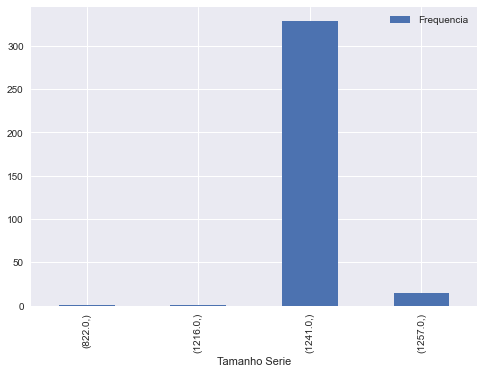

In [20]:
df_freq = df_freq.sort_values('Tamanho Serie')
df_freq.plot.bar()

In [21]:
df_freq.sort_values('Frequencia', ascending=False, inplace=True)

codigo_listagem_b3_maior_freq = (df_freq.iloc[0]['Codigos Listagem B3'])[0]
print('Série com maior frequência selecionada: {}'.format(codigo_listagem_b3_maior_freq))

tamanho_serie_maior_freq = df_freq.index[df_freq['Frequencia'] == df_freq.iloc[0]['Frequencia']][0][0]
print('Tamanho da serie selecionada: {}'.format(tamanho_serie_maior_freq))

Série com maior frequência selecionada: ABCB4
Tamanho da serie selecionada: 1241.0


In [22]:
# Monta lista das séries históricas que possuem tamanho menor que a série histórica de maior frequencia
# na distribuição de frequencia
lst_remover = []
for ele, linha in df_freq.iterrows():
    if ele[0] != tamanho_serie_maior_freq:    
        for cod_b3 in linha['Codigos Listagem B3']:
            lst_remover.append(cod_b3)
display(lst_remover)




['BAUH3',
 'CALI3',
 'CORR3',
 'FIGE3',
 'FIGE4',
 'HOOT3',
 'LUXM3',
 'MGEL3',
 'MMAQ3',
 'MMAQ4',
 'MTIG3',
 'PPAR3',
 'TKNO3',
 'VSPT3',
 'CAMB3',
 'CASN4']

In [23]:
# Elimina as séries históricas selecionadas anteriormente
df_codigo_listagem_b3 = df_codigo_listagem_b3.drop(lst_remover)
display(df_codigo_listagem_b3)

,Codigo Listagem,Serie Historica
Codigo Listagem B3,,
ABCB4,ABCB,{'Open': {2015-01-02 00:00:00: 6.4717394519652...
ABEV3,ABEV,{'Open': {2015-01-02 00:00:00: 12.714063918292...
AFLT3,AFLT,{'Open': {2015-01-02 00:00:00: 1.7303544282913...
AGRO3,AGRO,{'Open': {2015-01-02 00:00:00: 6.3555953281670...
AHEB3,AHEB,{'Open': {2015-01-02 00:00:00: 14.425086975097...
...,...,...
WEGE3,WEGE,{'Open': {2015-01-02 00:00:00: 10.422835350036...
WHRL3,WHRL,{'Open': {2015-01-02 00:00:00: 2.2140452861785...
WHRL4,WHRL,{'Open': {2015-01-02 00:00:00: 2.0763726682798...


## Montagem dos dataframes que armazenam os preços de fechamento e volumes para os experimentos 

In [24]:
# Monta os dataframe com os dados que serão utilizados nos experimentos

#Pega uma serie historica os índices (datas)
df_maior_freq = pd.DataFrame.from_dict(df_codigo_listagem_b3.loc[codigo_listagem_b3_maior_freq, 'Serie Historica'])

# Cria os dataframes onde serão feitos os merges de todas as séries históricas (filtradas). Um para preços de fechamento
# e um para volume
df_completo_fechamento = pd.DataFrame(index=df_maior_freq.index)
df_completo_volume = pd.DataFrame(index=df_maior_freq.index)

display(df_completo_fechamento)
display(df_completo_volume)

""
2015-01-02
2015-01-05
2015-01-06
2015-01-07
2015-01-08
...
2019-12-20
2019-12-23
2019-12-26
2019-12-27


""
2015-01-02
2015-01-05
2015-01-06
2015-01-07
2015-01-08
...
2019-12-20
2019-12-23
2019-12-26
2019-12-27


In [25]:
# Popula os dataframes com os dados de todas as séries históricas

# Lista contendo os códigos de listagem b3 das séries válidas
lstcodigo_listagem = df_codigo_listagem_b3.index.to_list()
# Popula os dataframes
for codigo_listagem_b3 in lstcodigo_listagem:
    df_temp = pd.DataFrame.from_dict(df_codigo_listagem_b3.loc[codigo_listagem_b3, 'Serie Historica'])
    df_completo_fechamento[codigo_listagem_b3] = df_temp['Close']
    df_completo_volume[codigo_listagem_b3] = df_temp['Volume']

display(df_completo_fechamento)
display(df_completo_volume)

,ABCB4,ABEV3,AFLT3,AGRO3,AHEB3,ALPA3,ALPA4,ALSO3,AMAR3,ANIM3,...,VIVR3,VIVT3,VLID3,VULC3,VVAR3,WEGE3,WHRL3,WHRL4,WLMM4,YDUQ3
2015-01-02,6.320648,12.619536,1.730354,6.254368,14.425087,4.467450,4.572730,14.982171,13.131628,10.475513,...,83.941902,23.832865,32.392029,1.12,6.543556,10.422835,2.214045,2.007160,12.425022,16.707975
2015-01-05,6.270285,12.391089,1.730354,6.290521,14.425087,4.467450,4.448258,14.143884,13.032077,9.819817,...,75.547699,23.360241,32.085022,1.12,6.543556,10.493836,1.881938,1.884708,12.425022,15.707772
2015-01-06,6.119194,12.863731,1.730354,6.391748,14.425087,4.378237,4.408951,13.689069,12.226623,8.430369,...,83.941902,22.780491,30.311897,1.12,6.543556,10.338193,2.131018,1.847439,12.425022,14.790919
2015-01-07,5.998320,13.044909,1.730354,6.391748,14.425087,4.378237,4.356541,13.822837,12.452873,8.027583,...,83.941902,23.561890,31.816351,1.12,7.082436,10.219769,2.158695,1.890031,12.425022,14.328702
2015-01-08,6.003357,13.830949,1.730354,6.290521,14.425087,4.378237,4.422052,13.867428,12.317122,7.965137,...,83.941902,24.519741,30.956635,1.12,7.082436,10.392303,1.942824,1.863411,12.425022,14.775764
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-12-20,18.354511,18.335499,10.271010,17.766039,30.846846,27.205738,32.300125,46.605164,12.370000,9.613333,...,2.030770,42.576336,15.350000,8.93,11.370000,33.428307,6.321800,6.458648,11.580400,46.487804
2019-12-23,18.464638,18.383980,10.062692,18.443762,30.846846,26.856306,32.649586,49.183319,12.790000,9.403333,...,2.013910,42.707077,15.720000,9.20,11.670000,33.367317,7.179241,7.129491,11.884645,47.337959
2019-12-26,18.510527,18.636080,10.008348,18.685806,30.846846,26.766453,32.809338,49.123825,13.230000,9.766666,...,2.300410,43.482780,16.540001,9.16,11.800000,34.414055,7.368167,7.736104,12.074800,46.951523
2019-12-27,18.427927,18.577904,9.972120,18.840714,34.707676,26.956144,32.609646,49.351894,13.180000,10.000000,...,2.190870,42.994701,16.900000,9.16,11.500000,34.897926,7.135641,7.329317,12.074800,47.144741


,ABCB4,ABEV3,AFLT3,AGRO3,AHEB3,ALPA3,ALPA4,ALSO3,AMAR3,ANIM3,...,VIVR3,VIVT3,VLID3,VULC3,VVAR3,WEGE3,WHRL3,WHRL4,WLMM4,YDUQ3
2015-01-02,154368,19396500,0,60300,0,24750,373000,6800,37180,797100,...,53,7300,328900,750,0,1558180,700,11700,0,4466200
2015-01-05,189170,13795900,0,13800,0,0,1640375,13100,53240,1465500,...,964,13800,341440,0,0,1954420,26400,80600,0,9412000
2015-01-06,428962,18610500,0,15100,0,9875,508625,126700,803110,3687300,...,160,50200,579590,0,0,2153580,6900,73300,0,11751900
2015-01-07,949015,20493500,0,5600,0,9875,795125,104800,71390,5206200,...,227,62000,419320,0,1000,914940,2300,56500,0,8317800
2015-01-08,657152,9054500,0,7500,0,0,2500875,663200,39050,3366000,...,226,95400,331870,0,0,793000,2000,70200,0,8984400
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-12-20,493800,25816100,11700,44500,0,0,1045400,814300,2715800,597300,...,5743719,48300,445500,518100,43132000,5577100,9900,38800,5100,2701300
2019-12-23,1056700,16331900,1500,61800,0,103600,877900,1888700,2771500,797100,...,3059424,38200,536000,1696200,34472600,5025100,25500,108100,1400,1315100
2019-12-26,1519900,20726100,2500,64300,0,11900,1283700,3504800,2840400,1614000,...,3384710,34800,960600,1197600,32120200,3290200,30600,81000,400,1826300
2019-12-27,818500,13210500,1400,35500,100,2000,910300,1663500,2241600,1424700,...,2065526,44300,970500,585200,36089000,3002700,12600,78000,0,1986000


## Tratamento dos dataframes: valores nulos

In [26]:
df_temp = pd.DataFrame(df_completo_fechamento.isna().sum())
display(df_temp[df_temp[0]!=0])


,0


In [27]:
df_temp = pd.DataFrame(df_completo_volume.isna().sum())
display(df_temp[df_temp[0]!=0])


,0


## Gera gráficos das séries que serão utilizadas nos experimentos

In [28]:
def grafico_dataframe_multicol(df, sttitulo, ncol_subfig=2):
    # Utiliza o numero de codigos de listagem b3 selecionados para calcuar o numer de linhas no grafico
    ngraficos = len(df.columns)
    nlin_subfig = math.ceil(ngraficos / ncol_subfig)

    fig, subfig = plt.subplots(nlin_subfig, ncol_subfig, figsize=(8*ncol_subfig,4*nlin_subfig))
    fig.suptitle(sttitulo) 

    for linha in range(nlin_subfig):
        for coluna in range(ncol_subfig):
            # Pula os índices que não existem
            if ((linha*ncol_subfig)+coluna+1 > ngraficos):
                continue
            subfig[linha, coluna].plot(df.iloc[:,linha*ncol_subfig+coluna])
            subfig[linha, coluna].set_title(df.columns[linha*ncol_subfig+coluna])




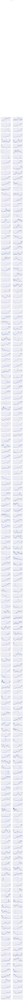

In [29]:
# Gera gráficos de todas as séries de preços 
grafico_dataframe_multicol(df_completo_fechamento, 'Séries Históricas')

Text(0.5, 1.0, 'PETR4')

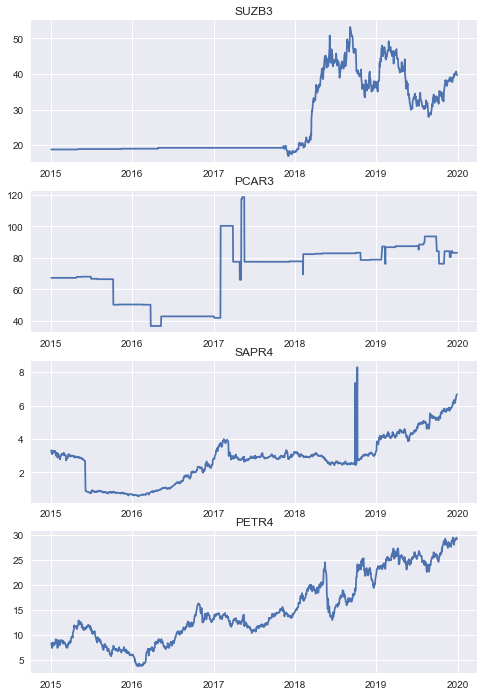

In [30]:
# Gráfico algumas séries que foram identificadas com problemas (ruídos, valores constantes)

fig, subfig= plt.subplots(4,1, figsize=(8,4*3))
# Gráfico das séries históricas
#df_completo_fechamento['SUZB3'].plot(ax=subfig[0], title='SUZB3')
subfig[0].plot(df_completo_fechamento['SUZB3'])
subfig[0].set_title('SUZB3')
subfig[1].plot(df_completo_fechamento['PCAR3'])
subfig[1].set_title('PCAR3')
subfig[2].plot(df_completo_fechamento['SAPR4'])
subfig[2].set_title('SAPR4')
subfig[3].plot(df_completo_fechamento['PETR4'])
subfig[3].set_title('PETR4')


## Remoção das séries históricas que possuem valores de preços de fechamento constantes por 10 dias consecutivos, pelo menos

In [31]:
def lista_series_precos_constantes(df, ndias=10):
    flremove = False
    lst_remove = []

    # Itera pelas colunas
    for codigo_listagem_b3 in df:
        df_serie = df_completo_fechamento[codigo_listagem_b3]
        len_serie = len(df_serie)
        
        for iwindow in range(len_serie - ndias - 1):
            df_slice = df_serie.iloc[iwindow:iwindow + ndias - 1]
            # Verifica se todos os valores são iguais
            data_slice = df_slice.to_numpy()
            if (data_slice[0] == data_slice).all(0):
                flremove = True
                break
        if (flremove):
            lst_remove.append(codigo_listagem_b3)
            flremove = False
    return lst_remove        

In [32]:
ndias = 10
lst_remove = lista_series_precos_constantes(df_completo_fechamento, ndias)
print('Lista de códigos de listagem b3 que possuem valores de fechamentos iguais por pelo menos {} dias'.format(ndias))
print(lst_remove)
print('Total: {}'.format(len(lst_remove)))

Lista de códigos de listagem b3 que possuem valores de fechamentos iguais por pelo menos 10 dias
['AFLT3', 'AHEB3', 'ATMP3', 'ATOM3', 'AZEV3', 'AZEV4', 'BAHI3', 'BALM3', 'BALM4', 'BAUH4', 'BAZA3', 'BDLL3', 'BDLL4', 'BGIP3', 'BGIP4', 'BIOM3', 'BMEB3', 'BMEB4', 'BMIN3', 'BMIN4', 'BMKS3', 'BNBR3', 'BOBR4', 'BRGE3', 'BRIV3', 'BRIV4', 'BRSR3', 'BSEV3', 'BSLI3', 'BSLI4', 'BTTL3', 'CALI4', 'CASN3', 'CBEE3', 'CCPR3', 'CEBR3', 'CEDO3', 'CEDO4', 'CEEB3', 'CEED3', 'CEED4', 'CEGR3', 'CEPE3', 'CGAS3', 'CLSC3', 'COCE3', 'CORR4', 'CRDE3', 'CRIV3', 'CRIV4', 'CRPG3', 'CSAB3', 'CSAB4', 'CSRN3', 'CTKA3', 'CTNM3', 'CTNM4', 'CTSA3', 'CTSA4', 'DASA3', 'DOHL3', 'DOHL4', 'DTCY3', 'EALT3', 'EALT4', 'ECPR3', 'ECPR4', 'EEEL3', 'EEEL4', 'EKTR3', 'EKTR4', 'EMAE4', 'ENGI3', 'ENGI4', 'ENMT3', 'ENMT4', 'EQPA3', 'ESTR3', 'ESTR4', 'EUCA3', 'FESA3', 'FRAS3', 'FRIO3', 'FRTA3', 'GEPA3', 'GEPA4', 'GPAR3', 'GPCP3', 'GSHP3', 'HAGA3', 'HAGA4', 'HETA3', 'HETA4', 'HGTX3', 'HOOT4', 'INEP3', 'INEP4', 'JBDU3', 'JBDU4', 'JFEN3', 'J

In [33]:
# Remove dos dataframes de preço de fechamento e volume os códigos de listagem b3 que possuem papeis com preços
# iguais numa janela de tempo (definida nas células anteriores - 10 dias)
df_completo_fechamento = df_completo_fechamento.drop(lst_remove, axis=1)
df_completo_volume = df_completo_volume.drop(lst_remove, axis=1)

display(df_completo_fechamento)    
display(df_completo_volume)

,ABCB4,ABEV3,AGRO3,ALPA3,ALPA4,ALSO3,AMAR3,ANIM3,APER3,ARZZ3,...,TRPL4,TUPY3,UCAS3,UGPA3,USIM3,VALE3,VIVT3,VLID3,WEGE3,YDUQ3
2015-01-02,6.320648,12.619536,6.254368,4.467450,4.572730,14.982171,13.131628,10.475513,60.691006,21.699820,...,5.725941,12.462390,1.688521,21.359262,12.601447,16.528288,23.832865,32.392029,10.422835,16.707975
2015-01-05,6.270285,12.391089,6.290521,4.467450,4.448258,14.143884,13.032077,9.819817,57.308842,21.019861,...,5.732983,12.364203,1.638224,20.790075,12.058615,16.279739,23.360241,32.085022,10.493836,15.707772
2015-01-06,6.119194,12.863731,6.391748,4.378237,4.408951,13.689069,12.226623,8.430369,54.490372,20.608530,...,5.700648,12.160273,1.631039,20.819588,13.086117,16.932173,22.780491,30.311897,10.338193,14.790919
2015-01-07,5.998320,13.044909,6.391748,4.378237,4.356541,13.822837,12.452873,8.027583,54.114578,20.818394,...,5.863844,12.145167,1.616669,21.384562,13.086117,17.553537,23.561890,31.816351,10.219769,14.328702
2015-01-08,6.003357,13.830949,6.290521,4.378237,4.422052,13.867428,12.317122,7.965137,51.296116,20.717657,...,5.901813,12.160273,1.695706,21.165318,13.086117,17.739946,24.519741,30.956635,10.392303,14.775764
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-12-20,18.354511,18.335499,17.766039,27.205738,32.300125,46.605164,12.370000,9.613333,28.834301,63.960209,...,19.421001,23.900000,3.793725,23.748980,9.393888,49.025345,42.576336,15.350000,33.428307,46.487804
2019-12-23,18.464638,18.383980,18.443762,26.856306,32.649586,49.183319,12.790000,9.403333,27.869511,65.007446,...,19.760502,24.340000,3.848480,24.443787,9.472827,48.837440,42.707077,15.720000,33.367317,47.337959
2019-12-26,18.510527,18.636080,18.685806,26.766453,32.809338,49.123825,13.230000,9.766666,28.217632,63.989838,...,19.986830,24.700001,3.879769,24.704342,9.610971,49.025345,43.482780,16.540001,34.414055,46.951523
2019-12-27,18.427927,18.577904,18.840714,26.956144,32.609646,49.351894,13.180000,10.000000,28.804461,63.209362,...,19.847549,24.830000,3.801548,24.820143,9.630707,49.231415,42.994701,16.900000,34.897926,47.144741


,ABCB4,ABEV3,AGRO3,ALPA3,ALPA4,ALSO3,AMAR3,ANIM3,APER3,ARZZ3,...,TRPL4,TUPY3,UCAS3,UGPA3,USIM3,VALE3,VIVT3,VLID3,WEGE3,YDUQ3
2015-01-02,154368,19396500,60300,24750,373000,6800,37180,797100,6477,94700,...,1906758,106600,17300,2635800,408600,5658400,7300,328900,1558180,4466200
2015-01-05,189170,13795900,13800,0,1640375,13100,53240,1465500,35974,101300,...,2913792,82600,132100,2991600,93900,8603000,13800,341440,1954420,9412000
2015-01-06,428962,18610500,15100,9875,508625,126700,803110,3687300,11585,148900,...,1479519,70300,114500,4890400,385300,9879900,50200,579590,2153580,11751900
2015-01-07,949015,20493500,5600,9875,795125,104800,71390,5206200,17175,155800,...,1385422,118100,41600,4257600,402400,6130900,62000,419320,914940,8317800
2015-01-08,657152,9054500,7500,0,2500875,663200,39050,3366000,32788,68900,...,1500741,134200,11800,1730600,507300,4667300,95400,331870,793000,8984400
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-12-20,493800,25816100,44500,0,1045400,814300,2715800,597300,26700,1181200,...,1489300,3494800,273700,7460600,22800,42124200,48300,445500,5577100,2701300
2019-12-23,1056700,16331900,61800,103600,877900,1888700,2771500,797100,84200,415000,...,1090600,1881500,326600,3218200,27400,10225700,38200,536000,5025100,1315100
2019-12-26,1519900,20726100,64300,11900,1283700,3504800,2840400,1614000,36000,641500,...,1469100,702400,585000,4263200,77300,20410000,34800,960600,3290200,1826300
2019-12-27,818500,13210500,35500,2000,910300,1663500,2241600,1424700,32800,614600,...,1323100,698600,2443600,3505200,53500,13920400,44300,970500,3002700,1986000


## Transformação da série histórica de preços em séries históricas de retornos 

In [34]:
# Manterei dois dataframes. Um conservando o valor original dos preccos 'df_data_precos' e o outro, o 'df_data'
# onde serão realizadas transformações/normalizações
df_data = df_completo_fechamento
df_data_precos = df_completo_fechamento

# Transforma a série em retornos
# Retorno
df_data = (df_data - df_data.shift(1)) / df_data.shift(1)
#df_data = (df_data - df_data.shift(1)) 

# Primeiro ponto descartado por causa do cálculo anterior, que faz um deslocamento da série
df_data = df_data[1:]
df_data_precos = df_data_precos[1:]

display(df_data)
display(df_data.describe())

,ABCB4,ABEV3,AGRO3,ALPA3,ALPA4,ALSO3,AMAR3,ANIM3,APER3,ARZZ3,...,TRPL4,TUPY3,UCAS3,UGPA3,USIM3,VALE3,VIVT3,VLID3,WEGE3,YDUQ3
2015-01-05,-0.007968,-0.018103,0.005780,0.000000,-0.027220,-0.055952,-0.007581,-0.062593,-0.055728,-0.031335,...,0.001230,-0.007879,-0.029787,-0.026648,-0.043077,-0.015038,-0.019831,-0.009478,0.006812,-0.059864
2015-01-06,-0.024096,0.038144,0.016092,-0.019969,-0.008837,-0.032156,-0.061806,-0.141494,-0.049180,-0.019569,...,-0.005640,-0.016494,-0.004386,0.001420,0.085209,0.040076,-0.024818,-0.055263,-0.014832,-0.058369
2015-01-07,-0.019753,0.014084,0.000000,0.000000,-0.011887,0.009772,0.018505,-0.047778,-0.006897,0.010183,...,0.028628,-0.001242,-0.008810,0.027137,0.000000,0.036697,0.034301,0.049632,-0.011455,-0.031250
2015-01-08,0.000840,0.060256,-0.015837,0.000000,0.015037,0.003226,-0.010901,-0.007779,-0.052083,-0.004839,...,0.006475,0.001244,0.048889,-0.010252,0.000000,0.010619,0.040653,-0.027021,0.016882,0.031200
2015-01-09,-0.015101,-0.002418,0.004598,0.000000,-0.004444,0.009646,0.024982,0.003528,-0.076923,-0.010940,...,-0.082715,-0.013665,-0.042373,-0.012151,0.037037,-0.021453,-0.015934,-0.008182,-0.004555,-0.025641
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-12-20,0.006543,0.012345,-0.008108,0.000000,-0.011308,0.000000,0.014766,0.005930,-0.005148,0.000000,...,-0.006236,0.126827,-0.004107,0.013174,-0.003141,0.014630,0.020899,-0.009677,0.008631,-0.031791
2019-12-23,0.006000,0.002644,0.038147,-0.012844,0.010819,0.055319,0.033953,-0.021845,-0.033460,0.016373,...,0.017481,0.018410,0.014433,0.029256,0.008403,-0.003833,0.003071,0.024104,-0.001824,0.018288
2019-12-26,0.002485,0.013713,0.013123,-0.003346,0.004893,-0.001210,0.034402,0.038639,0.012491,-0.015654,...,0.011454,0.014790,0.008130,0.010659,0.014583,0.003848,0.018163,0.052163,0.031370,-0.008163
2019-12-27,-0.004462,-0.003122,0.008290,0.007087,-0.006086,0.004643,-0.003779,0.023891,0.020797,-0.012197,...,-0.006969,0.005263,-0.020161,0.004687,0.002053,0.004203,-0.011225,0.021765,0.014060,0.004115


,ABCB4,ABEV3,AGRO3,ALPA3,ALPA4,ALSO3,AMAR3,ANIM3,APER3,ARZZ3,...,TRPL4,TUPY3,UCAS3,UGPA3,USIM3,VALE3,VIVT3,VLID3,WEGE3,YDUQ3
count,1240.000000,1240.000000,1240.000000,1240.000000,1240.000000,1240.000000,1240.000000,1240.000000,1240.000000,1240.000000,...,1240.000000,1240.000000,1240.000000,1240.000000,1240.000000,1240.000000,1240.000000,1240.000000,1240.000000,1240.000000
mean,0.001074,0.000388,0.000963,0.001781,0.001838,0.001125,0.000458,0.000465,-0.000030,0.001119,...,0.001111,0.000769,0.001221,0.000286,0.000492,0.001356,0.000642,-0.000247,0.001117,0.001302
std,0.020456,0.013911,0.013551,0.025210,0.021927,0.017810,0.030069,0.031713,0.034200,0.022639,...,0.015253,0.019925,0.033036,0.018595,0.038339,0.030877,0.018498,0.023444,0.017788,0.031291
min,-0.115505,-0.082856,-0.071763,-0.097969,-0.110204,-0.074667,-0.163522,-0.280000,-0.189516,-0.111111,...,-0.082715,-0.069767,-0.143836,-0.101630,-0.177215,-0.245592,-0.102649,-0.104843,-0.091045,-0.150388
25%,-0.009959,-0.007137,-0.005626,-0.006637,-0.010629,-0.008638,-0.018409,-0.015715,-0.015139,-0.012229,...,-0.007631,-0.011303,-0.020305,-0.009455,-0.014139,-0.015171,-0.009338,-0.014183,-0.009963,-0.017350
50%,0.000000,0.000000,0.000000,0.000000,0.001310,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000819,0.000000,0.000000,0.000000,0.000000,0.000529,0.000000,-0.000831,0.000579,0.000526
75%,0.011344,0.007962,0.006359,0.010344,0.013622,0.009464,0.016505,0.017981,0.011990,0.013511,...,0.009871,0.011429,0.018182,0.010308,0.012742,0.016850,0.011045,0.012816,0.012144,0.019381
max,0.223893,0.085189,0.080180,0.188406,0.148148,0.101846,0.179159,0.173872,0.338919,0.086484,...,0.102338,0.126827,0.300000,0.086810,0.389289,0.147614,0.091171,0.115833,0.070989,0.237365


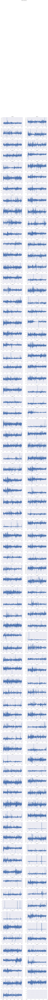

In [35]:

grafico_dataframe_multicol(df_data, 'Séries de Retornos')

## Normalização das séries de retornos com z-score

In [36]:
scaler = preprocessing.StandardScaler()
df_norm_data = pd.DataFrame(scaler.fit_transform(df_data), index=df_data.index, columns=df_data.columns)

df_data = df_norm_data

In [37]:
display(df_norm_data)
display(df_norm_data.describe())

,ABCB4,ABEV3,AGRO3,ALPA3,ALPA4,ALSO3,AMAR3,ANIM3,APER3,ARZZ3,...,TRPL4,TUPY3,UCAS3,UGPA3,USIM3,VALE3,VIVT3,VLID3,WEGE3,YDUQ3
2015-01-05,-0.442174,-1.329721,0.355678,-0.070679,-1.325737,-3.206002,-0.267443,-1.989227,-1.629235,-1.434085,...,0.007789,-0.434152,-0.938990,-1.449094,-1.136870,-0.531141,-1.107175,-0.393891,0.320279,-1.955512
2015-01-06,-1.230929,2.715209,1.116950,-0.863124,-0.487001,-1.869392,-2.071478,-4.478212,-1.437718,-0.914158,...,-0.442787,-0.866691,-0.169790,0.060958,2.210576,1.254551,-1.376879,-2.347639,-0.897005,-1.907734
2015-01-07,-1.018524,0.984996,-0.071070,-0.070679,-0.626183,0.485690,0.600423,-1.521872,-0.200846,0.400548,...,1.804692,-0.100952,-0.303763,1.444542,-0.012835,1.145068,1.820319,2.128452,-0.707087,-1.040716
2015-01-08,-0.011440,4.305434,-1.240276,-0.070679,0.602210,0.118005,-0.377904,-0.260076,-1.522631,-0.263263,...,0.351800,0.023859,1.443484,-0.566997,-0.012835,0.300150,2.163804,-1.142497,0.886651,0.955859
2015-01-09,-0.790993,-0.201778,0.268364,-0.070679,-0.286617,0.478631,0.815908,0.096607,-2.249241,-0.532857,...,-5.497788,-0.724656,-1.320107,-0.669162,0.953597,-0.739008,-0.896448,-0.338612,-0.319018,-0.861395
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-12-20,0.267454,0.859912,-0.669660,-0.070679,-0.599762,-0.063191,0.476044,0.172368,-0.149686,-0.049442,...,-0.481877,6.329089,-0.161333,0.693360,-0.094803,0.430080,1.095495,-0.402406,0.422568,-1.058005
2019-12-23,0.240919,0.162272,2.745201,-0.580368,0.409758,3.044051,1.114386,-0.703787,-0.977866,0.674073,...,1.073639,0.885739,0.400094,1.558579,0.206437,-0.168101,0.131354,1.039117,-0.165452,0.543031
2019-12-26,0.069033,0.958288,0.897784,-0.203446,0.139383,-0.131136,1.129315,1.204205,0.366275,-0.741160,...,0.678318,0.704010,0.209229,0.558062,0.367695,0.080741,0.947572,2.236430,1.701457,-0.302622
2019-12-27,-0.270732,-0.252373,0.540960,0.210550,-0.361532,0.197589,-0.140959,0.738969,0.609221,-0.588406,...,-0.529910,0.225664,-0.647496,0.236773,0.040746,0.092268,-0.641751,0.939312,0.727928,0.089931


,ABCB4,ABEV3,AGRO3,ALPA3,ALPA4,ALSO3,AMAR3,ANIM3,APER3,ARZZ3,...,TRPL4,TUPY3,UCAS3,UGPA3,USIM3,VALE3,VIVT3,VLID3,WEGE3,YDUQ3
count,1.240000e+03,1.240000e+03,1.240000e+03,1.240000e+03,1.240000e+03,1.240000e+03,1.240000e+03,1.240000e+03,1.240000e+03,1.240000e+03,...,1.240000e+03,1.240000e+03,1.240000e+03,1.240000e+03,1.240000e+03,1.240000e+03,1.240000e+03,1.240000e+03,1.240000e+03,1.240000e+03
mean,-8.617659e-18,-3.527644e-17,-4.834842e-18,-2.990439e-17,1.468359e-17,6.719535e-17,-3.747003e-17,1.544463e-18,8.697680e-17,1.698350e-17,...,-4.834842e-18,1.038596e-17,-1.414639e-17,1.987657e-17,1.065456e-17,-8.841494e-18,-1.535510e-17,9.736835e-18,2.309980e-17,2.157772e-17
std,1.000403e+00,1.000403e+00,1.000403e+00,1.000403e+00,1.000403e+00,1.000403e+00,1.000403e+00,1.000403e+00,1.000403e+00,1.000403e+00,...,1.000403e+00,1.000403e+00,1.000403e+00,1.000403e+00,1.000403e+00,1.000403e+00,1.000403e+00,1.000403e+00,1.000403e+00,1.000403e+00
min,-5.701196e+00,-5.986404e+00,-5.369070e+00,-3.958378e+00,-5.111732e+00,-4.257177e+00,-5.455557e+00,-8.847467e+00,-5.542767e+00,-4.959303e+00,...,-5.497788e+00,-3.541434e+00,-4.392618e+00,-5.483126e+00,-4.637025e+00,-8.001073e+00,-5.586031e+00,-4.463298e+00,-5.183321e+00,-4.849603e+00
25%,-5.395496e-01,-5.411317e-01,-4.864101e-01,-3.340368e-01,-5.688020e-01,-5.483737e-01,-6.276841e-01,-5.104199e-01,-4.419562e-01,-5.898088e-01,...,-5.733295e-01,-6.060970e-01,-6.518346e-01,-5.241122e-01,-3.817645e-01,-5.354611e-01,-5.397281e-01,-5.946684e-01,-6.231957e-01,-5.963196e-01
50%,-5.250576e-02,-2.787788e-02,-7.107006e-02,-7.067899e-02,-2.409487e-02,-6.319133e-02,-1.522485e-02,-1.468255e-02,8.887263e-04,-4.944156e-02,...,-1.913814e-02,-3.858500e-02,-3.696852e-02,-1.541367e-02,-1.283472e-02,-2.677822e-02,-3.471447e-02,-2.492825e-02,-3.029730e-02,-2.480401e-02
75%,5.022774e-01,5.447184e-01,3.983656e-01,3.397957e-01,5.376306e-01,4.684071e-01,5.338864e-01,5.525385e-01,3.516051e-01,5.476079e-01,...,5.745133e-01,5.352210e-01,5.136171e-01,5.391721e-01,3.196569e-01,5.020314e-01,5.626083e-01,5.574130e-01,6.201718e-01,5.779884e-01
max,1.089686e+01,6.098472e+00,5.848364e+00,7.405810e+00,6.675170e+00,5.657460e+00,5.945348e+00,5.470234e+00,9.914824e+00,3.772184e+00,...,6.639051e+00,6.329089e+00,9.047654e+00,4.655004e+00,1.014514e+01,4.738749e+00,4.895902e+00,4.953342e+00,3.929698e+00,7.547034e+00


## Eliminação das séries históricas que possuem outliers 

In [38]:
def graficos_preco_retorno_box_hist(df_preco, df_retorno, sttitulo):
    fig, subfig= plt.subplots(2,2, figsize=(8*2,4*2))

    # Gráfico da série histórica
    df_preco.plot(ax=subfig[0, 0], title=sttitulo)

    df_retorno.plot(ax=subfig[0, 1], title=sttitulo)

    # Boxplot
    subfig[1, 0].boxplot(df_retorno)

    # Histograma
    subfig[1, 1].hist(df_retorno)

    display(df_retorno.describe())
    display(df_retorno.kurtosis())

count    1.240000e+03
mean    -8.142009e-18
std      1.000403e+00
min     -7.212973e+00
25%     -1.497628e-01
50%     -3.680954e-02
75%      1.083790e-01
max      2.366664e+01
Name: SAPR4, dtype: float64

417.4319343436868

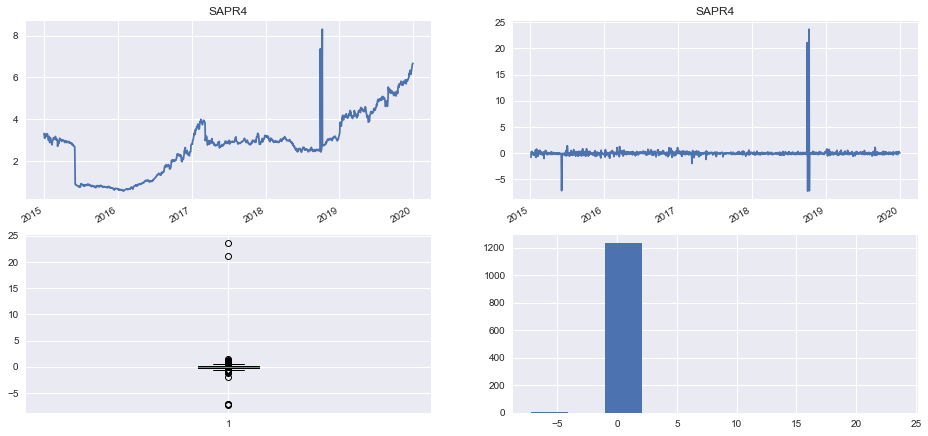

In [39]:
graficos_preco_retorno_box_hist(df_completo_fechamento['SAPR4'], df_data['SAPR4'], 'SAPR4')

count    1.240000e+03
mean    -3.432514e-17
std      1.000403e+00
min     -5.529053e+00
25%     -1.303711e-01
50%     -3.692601e-02
75%      6.685597e-02
max      1.695544e+01
Name: TOTS3, dtype: float64

226.33762818707555

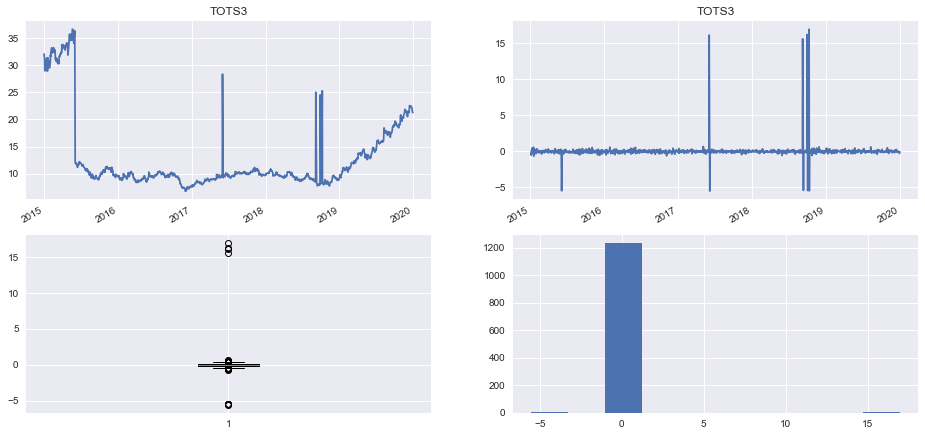

In [40]:
graficos_preco_retorno_box_hist(df_completo_fechamento['TOTS3'], df_data['TOTS3'], 'TOTS3')


count    1.240000e+03
mean    -8.841494e-18
std      1.000403e+00
min     -8.001073e+00
25%     -5.354611e-01
50%     -2.677822e-02
75%      5.020314e-01
max      4.738749e+00
Name: VALE3, dtype: float64

4.89395472327533

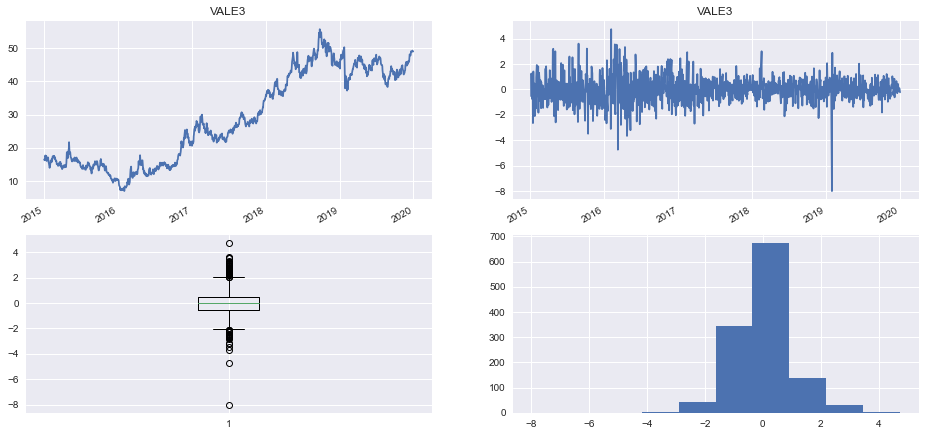

In [41]:
graficos_preco_retorno_box_hist(df_completo_fechamento['VALE3'], df_data['VALE3'], 'VALE3')

count    1.240000e+03
mean     1.007259e-17
std      1.000403e+00
min     -5.060556e+00
25%     -5.463073e-01
50%     -6.967532e-03
75%      5.006650e-01
max      5.131887e+00
Name: PETR4, dtype: float64

3.2706949739083666

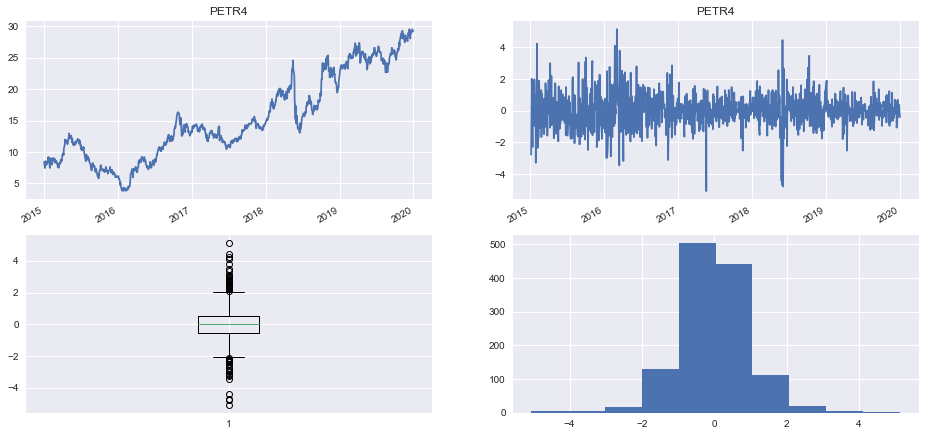

In [42]:
graficos_preco_retorno_box_hist(df_completo_fechamento['PETR4'], df_data['PETR4'], 'PETR4')

In [43]:
# Retorna uma lista com os codigo de listagem b3 que possuem curtose maior que o 'valor' passado como parâmetro
def lista_series_outliers(df, valor):
    floutlier = False
    lst_outliers = []

    # Itera pelas colunas
    for codigo_listagem_b3 in df:
        df_serie = df[codigo_listagem_b3]
        if( df_serie.kurtosis() > valor):
            lst_outliers.append(codigo_listagem_b3)

    return lst_outliers        

In [44]:
lst_remove = lista_series_outliers(df_data, 100)
display(lst_remove)

['ETER3', 'IGBR3', 'MGLU3', 'SAPR4', 'SHUL4', 'TCSA3', 'TELB4', 'TOTS3']

In [45]:
# Remove as ações da lista 'lst_remove' do dataframe
df_completo_fechamento = df_completo_fechamento.drop(lst_remove, axis=1)
df_completo_volume = df_completo_volume.drop(lst_remove, axis=1)
df_data = df_data.drop(lst_remove, axis=1)
df_data_precos = df_data_precos.drop(lst_remove, axis=1)

display(df_data)    

,ABCB4,ABEV3,AGRO3,ALPA3,ALPA4,ALSO3,AMAR3,ANIM3,APER3,ARZZ3,...,TRPL4,TUPY3,UCAS3,UGPA3,USIM3,VALE3,VIVT3,VLID3,WEGE3,YDUQ3
2015-01-05,-0.442174,-1.329721,0.355678,-0.070679,-1.325737,-3.206002,-0.267443,-1.989227,-1.629235,-1.434085,...,0.007789,-0.434152,-0.938990,-1.449094,-1.136870,-0.531141,-1.107175,-0.393891,0.320279,-1.955512
2015-01-06,-1.230929,2.715209,1.116950,-0.863124,-0.487001,-1.869392,-2.071478,-4.478212,-1.437718,-0.914158,...,-0.442787,-0.866691,-0.169790,0.060958,2.210576,1.254551,-1.376879,-2.347639,-0.897005,-1.907734
2015-01-07,-1.018524,0.984996,-0.071070,-0.070679,-0.626183,0.485690,0.600423,-1.521872,-0.200846,0.400548,...,1.804692,-0.100952,-0.303763,1.444542,-0.012835,1.145068,1.820319,2.128452,-0.707087,-1.040716
2015-01-08,-0.011440,4.305434,-1.240276,-0.070679,0.602210,0.118005,-0.377904,-0.260076,-1.522631,-0.263263,...,0.351800,0.023859,1.443484,-0.566997,-0.012835,0.300150,2.163804,-1.142497,0.886651,0.955859
2015-01-09,-0.790993,-0.201778,0.268364,-0.070679,-0.286617,0.478631,0.815908,0.096607,-2.249241,-0.532857,...,-5.497788,-0.724656,-1.320107,-0.669162,0.953597,-0.739008,-0.896448,-0.338612,-0.319018,-0.861395
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-12-20,0.267454,0.859912,-0.669660,-0.070679,-0.599762,-0.063191,0.476044,0.172368,-0.149686,-0.049442,...,-0.481877,6.329089,-0.161333,0.693360,-0.094803,0.430080,1.095495,-0.402406,0.422568,-1.058005
2019-12-23,0.240919,0.162272,2.745201,-0.580368,0.409758,3.044051,1.114386,-0.703787,-0.977866,0.674073,...,1.073639,0.885739,0.400094,1.558579,0.206437,-0.168101,0.131354,1.039117,-0.165452,0.543031
2019-12-26,0.069033,0.958288,0.897784,-0.203446,0.139383,-0.131136,1.129315,1.204205,0.366275,-0.741160,...,0.678318,0.704010,0.209229,0.558062,0.367695,0.080741,0.947572,2.236430,1.701457,-0.302622
2019-12-27,-0.270732,-0.252373,0.540960,0.210550,-0.361532,0.197589,-0.140959,0.738969,0.609221,-0.588406,...,-0.529910,0.225664,-0.647496,0.236773,0.040746,0.092268,-0.641751,0.939312,0.727928,0.089931


In [46]:
# Armazena a lista de series (completa)
lstseries_completo = df_data.columns

## Seleção das 100 ações com maior volume de negociação

In [47]:
# Monta uma lista com os 'nselecionados' códigos de listagem com maior volume

nselecionados = 100
# Soma os volumes do dataframe, por codigo de listagem B3, ordena (decrescente), e seleciona os 'n' primeiros
serie_total_volume  = df_completo_volume.sum()
# Ordena os valores - descrescente
serie_total_volume  = serie_total_volume.sort_values(ascending=False)
serie_total_volume  = serie_total_volume.iloc[:nselecionados]

lstmaior_volume = serie_total_volume.index.to_list()
print('Lista com os {} códigos de listagem B3 que apresentam maior volume no período'.format(nselecionados))
print(lstmaior_volume)


Lista com os 100 códigos de listagem B3 que apresentam maior volume no período
['PETR4', 'B3SA3', 'ITSA4', 'ITUB4', 'OIBR3', 'BBDC4', 'ABEV3', 'GOAU4', 'VALE3', 'PETR3', 'COGN3', 'GGBR4', 'JBSS3', 'CMIG4', 'BBAS3', 'CIEL3', 'CSNA3', 'CCRO3', 'EQTL3', 'RADL3', 'BRML3', 'CSAN3', 'OIBR4', 'BRFS3', 'RENT3', 'BBSE3', 'LAME4', 'LREN3', 'POMO4', 'TIMS3', 'MRVE3', 'UGPA3', 'GOLL4', 'MRFG3', 'BBDC3', 'ECOR3', 'YDUQ3', 'ELET3', 'EMBR3', 'CYRE3', 'WEGE3', 'QUAL3', 'MULT3', 'BRAP4', 'HYPE3', 'ENBR3', 'SBSP3', 'RAPT4', 'DTEX3', 'BTOW3', 'BEEF3', 'TRPL4', 'CSMG3', 'ENEV3', 'CPFE3', 'ODPV3', 'LIGT3', 'FLRY3', 'EVEN3', 'EGIE3', 'GFSA3', 'BRPR3', 'JHSF3', 'CVCB3', 'GRND3', 'IGTA3', 'ANIM3', 'CPLE3', 'SMLS3', 'CMIG3', 'ENAT3', 'MILS3', 'ALPA4', 'LINX3', 'SMTO3', 'MYPK3', 'LAME3', 'SLCE3', 'DIRR3', 'EZTC3', 'BPAN4', 'LCAM3', 'PRIO3', 'PSSA3', 'MEAL3', 'SEER3', 'ITSA3', 'TPIS3', 'AMAR3', 'MDIA3', 'TASA4', 'VLID3', 'TUPY3', 'GUAR3', 'PTBL3', 'ABCB4', 'ITUB3', 'POSI3', 'HBOR3', 'RSID3']


In [48]:
# Filtra o dataframe
df_data = df_data[lstmaior_volume]
df_data_precos = df_data_precos[lstmaior_volume]

display(df_data)


,PETR4,B3SA3,ITSA4,ITUB4,OIBR3,BBDC4,ABEV3,GOAU4,VALE3,PETR3,...,TASA4,VLID3,TUPY3,GUAR3,PTBL3,ABCB4,ITUB3,POSI3,HBOR3,RSID3
2015-01-05,-2.766429,-1.384962,0.122726,0.217305,-1.475796,0.049362,-1.329721,-1.365849,-0.531141,-2.691585,...,-2.150252,-0.393891,-0.434152,-1.494263,-0.022414,-0.442174,-0.718444,1.396160,-0.768677,-2.737874
2015-01-06,-1.088179,0.390799,0.359173,0.812109,-2.945741,1.526219,2.715209,2.790954,1.254551,-0.876535,...,-1.932779,-2.347639,-0.866691,-0.199360,-0.610637,-1.230929,0.523196,-0.885956,0.555942,-0.875811
2015-01-07,1.450583,1.822378,2.002224,1.879577,-0.334388,1.853450,0.984996,2.085014,1.145068,1.526907,...,-0.027294,2.128452,-0.100952,0.788392,-0.448794,-1.018524,1.279676,0.229041,1.486038,0.331730
2015-01-08,2.006898,-0.716605,0.511013,0.783887,0.215082,0.199633,4.305434,-0.982244,0.300150,2.148077,...,0.500576,-1.142497,0.023859,-0.719236,-0.022414,-0.011440,0.784462,1.072441,-0.497337,-0.491822
2015-01-09,0.917272,-1.325383,-1.962088,-2.384518,-0.163175,-2.122584,-0.201778,-1.552862,-0.739008,0.925776,...,0.486687,-0.338612,-0.724656,-0.049588,0.063783,-0.790993,-0.768965,0.351739,-1.657452,-0.853415
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-12-20,-0.411402,0.457410,-0.562392,-0.283846,0.245641,-0.387956,0.859912,0.741854,0.430080,-0.422498,...,-0.372979,-0.402406,6.329089,0.462865,-0.179974,0.267454,-0.537364,2.748464,-0.020401,-1.018613
2019-12-23,0.204599,-2.250937,0.337948,0.446109,-0.454538,0.248093,0.162272,0.273210,-0.168101,0.430170,...,-0.625548,1.039117,0.885739,0.822052,0.689387,0.240919,0.716450,-1.255988,1.444376,3.231893
2019-12-26,0.379918,-0.300140,0.882107,0.760163,-0.465228,0.552520,0.958288,0.365612,0.080741,0.242232,...,0.771380,2.236430,0.704010,1.661021,1.998241,0.069033,0.836236,-0.305969,-0.527006,5.939848
2019-12-27,-0.014361,-2.580843,-0.286020,-0.193627,0.253940,-0.230718,-0.252373,-0.140888,0.092268,-0.567515,...,-0.131924,0.939312,0.225664,-0.183793,-0.392464,-0.270732,-0.272330,-0.616585,0.495373,2.940996


## Análise e exploração dos dados

In [49]:
# Extrai a lista de accoes selecionadas para experimento
lst_series_selecionados = df_data.columns

df_series_selecionados = \
    df_accoes_setor_economico[df_accoes_setor_economico['Codigo Listagem B3'].isin(lst_series_selecionados)]
s_setores_series_selecionados = df_series_selecionados['SETOR ECONÔMICO'].value_counts()
display(s_setores_series_selecionados.sort_index())


Bens Industriais                   13
Comunicações                        3
Consumo Cíclico                    27
Consumo não Cíclico                 8
Financeiro                         17
Materiais Básicos                   6
Petróleo, Gás e Biocombustíveis     6
Saúde                               5
Tecnologia da Informação            2
Utilidade Pública                  13
Name: SETOR ECONÔMICO, dtype: int64

In [50]:
def grafico_pizza(serie):
    labels = serie.index.to_list()
    valores = serie.values

    fig, subfig = plt.subplots(figsize=(8,8))

    patches, l_text, p_text = subfig.pie(valores, labels=labels, autopct='%1.1f%%', shadow=True, startangle=90,
                                         rotatelabels=True, pctdistance = 1.1, labeldistance = 1.2)
    
    for p in p_text:
        p.set_size(15)
    for l in l_text:
        l.set_size(15)

    subfig.plot()

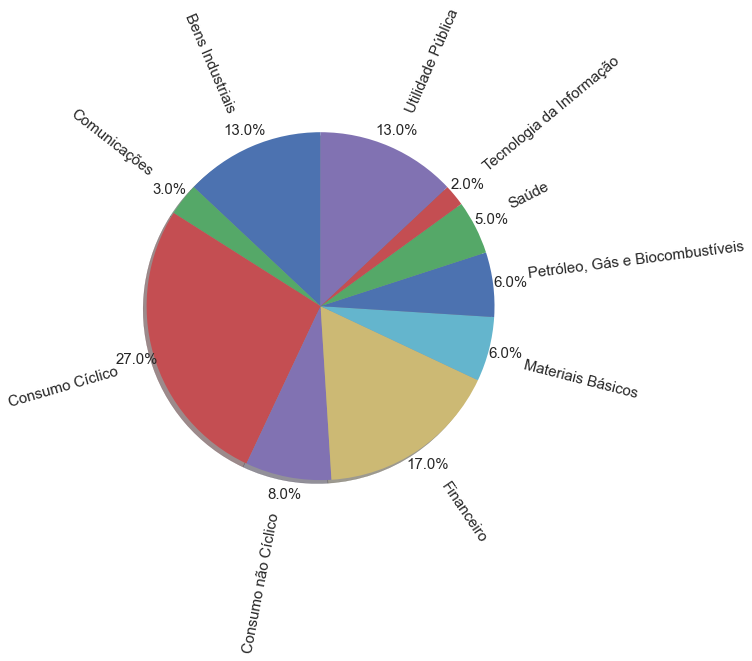

In [51]:
grafico_pizza(s_setores_series_selecionados.sort_index())

In [52]:
# Usa a lista de todas as series baixadas
df_series_completo = \
    df_accoes_setor_economico[df_accoes_setor_economico['Codigo Listagem B3'].isin(lstseries_completo)]
s_setores_series_completo = df_series_completo['SETOR ECONÔMICO'].value_counts()
display(s_setores_series_completo.sort_index())


Bens Industriais                   19
Comunicações                        4
Consumo Cíclico                    41
Consumo não Cíclico                 9
Financeiro                         29
Materiais Básicos                  15
Petróleo, Gás e Biocombustíveis     7
Saúde                               7
Tecnologia da Informação            3
Utilidade Pública                  15
Name: SETOR ECONÔMICO, dtype: int64

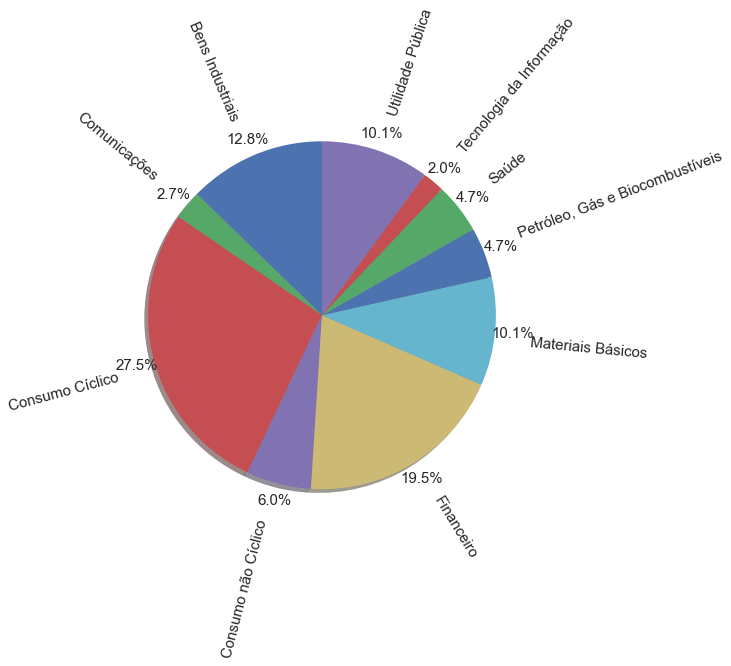

In [53]:
grafico_pizza(s_setores_series_completo.sort_index())

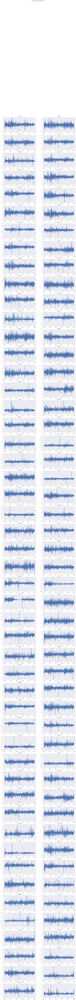

In [54]:
grafico_dataframe_multicol(df_data, 'Séries Históricas de Retornos')

array([[<AxesSubplot:title={'center':'PETR4'}>,
        <AxesSubplot:title={'center':'B3SA3'}>,
        <AxesSubplot:title={'center':'ITSA4'}>,
        <AxesSubplot:title={'center':'ITUB4'}>,
        <AxesSubplot:title={'center':'OIBR3'}>,
        <AxesSubplot:title={'center':'BBDC4'}>,
        <AxesSubplot:title={'center':'ABEV3'}>,
        <AxesSubplot:title={'center':'GOAU4'}>,
        <AxesSubplot:title={'center':'VALE3'}>,
        <AxesSubplot:title={'center':'PETR3'}>],
       [<AxesSubplot:title={'center':'COGN3'}>,
        <AxesSubplot:title={'center':'GGBR4'}>,
        <AxesSubplot:title={'center':'JBSS3'}>,
        <AxesSubplot:title={'center':'CMIG4'}>,
        <AxesSubplot:title={'center':'BBAS3'}>,
        <AxesSubplot:title={'center':'CIEL3'}>,
        <AxesSubplot:title={'center':'CSNA3'}>,
        <AxesSubplot:title={'center':'CCRO3'}>,
        <AxesSubplot:title={'center':'EQTL3'}>,
        <AxesSubplot:title={'center':'RADL3'}>],
       [<AxesSubplot:title={'center':'

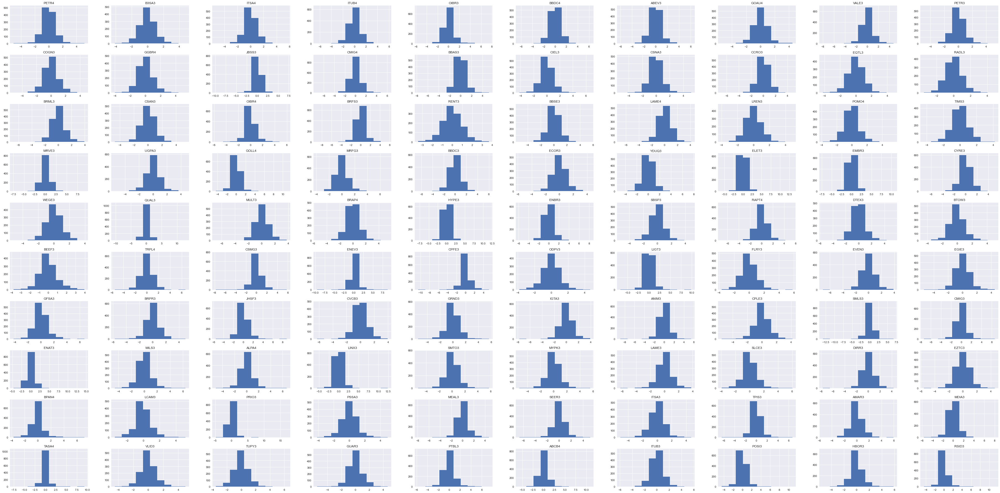

In [55]:
df_data.hist(figsize=(64,32))

In [56]:
# Correlação entre as séries analisadas

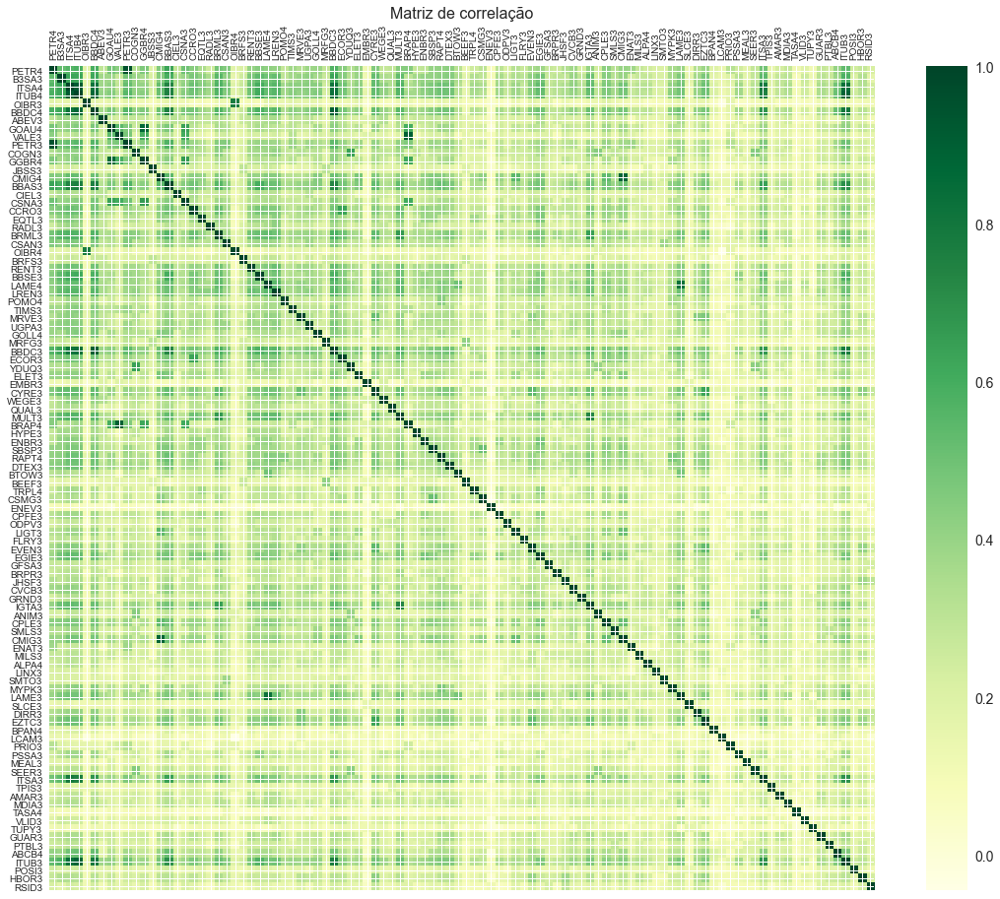

In [57]:
# Código adaptado de https://stackoverflow.com/questions/29432629/plot-correlation-matrix-using-pandas
f =  plt.figure(figsize=(19, 15))
plt.matshow(df_data.corr(), fignum=f.number, cmap="YlGn")
plt.xticks(range(df_data.select_dtypes(['number']).shape[1]), df_data.select_dtypes(['number']).columns, fontsize=10,
           rotation=90)
plt.yticks(range(df_data.select_dtypes(['number']).shape[1]), df_data.select_dtypes(['number']).columns, fontsize=10)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=14)
plt.title('Matriz de correlação', fontsize=16);

## Experimento com o TimeSeriesKMeans - nsetores  = ao número de setores encontrados nas ações selecionados

In [58]:
# Número de clusters = numero de setores da lista de acoes selecionadas
nclusters = len(s_setores_series_selecionados)
display(nclusters)

10

In [59]:
# Faz o agrupamentos de clusters utilizando o kmeans (timeseries)
# 
km = TimeSeriesKMeans(n_clusters = nclusters, metric='euclidean', n_init=300, random_state=3)
labels = km.fit_predict(df_data.T)
display(labels)


array([1, 1, 1, 1, 4, 1, 1, 6, 6, 1, 3, 6, 2, 5, 1, 1, 6, 1, 0, 0, 1, 1,
       4, 2, 0, 1, 7, 0, 0, 1, 9, 1, 5, 2, 1, 0, 3, 5, 6, 9, 0, 1, 1, 6,
       1, 1, 5, 0, 1, 7, 2, 5, 5, 5, 5, 1, 5, 0, 9, 1, 9, 1, 9, 7, 0, 1,
       3, 5, 0, 5, 8, 9, 9, 7, 7, 1, 7, 8, 9, 9, 9, 9, 6, 1, 7, 3, 1, 9,
       0, 7, 5, 7, 9, 9, 9, 1, 1, 9, 9, 9])

In [60]:
# Constroi um dataframe contendo os labels dos clusters e pega as informações de cada ativo (código listagem b3)
# no dataframe que contem as informações setoriais das ações 

def dataframe_clusters(lstlabels, df_data):
    # Dataframe para apresentar os resultados textuais
    df_clusters = pd.DataFrame(index=list(df_data.columns), columns=['Cluster', 'Codigo Listagem B3'])
    # Coluna clusters - labels dos clusters
    df_clusters['Cluster'] = lstlabels
    
    # lista contendo os codigos de listagem b3
    lst_codigo_listagem_b3 = df_clusters.index.to_list()
    
    df_clusters['Codigo Listagem B3'] = lst_codigo_listagem_b3

    # Merge dos dataframes df_clusters e o dataframe contendo a listagem de codigos e setores da B3
    df_clusters = pd.merge(df_clusters, df_accoes_setor_economico, on='Codigo Listagem B3', how='inner')    
    
    return df_clusters
    

In [61]:
df_clusters = dataframe_clusters(labels, df_data)
df_clusters.sort_values(['Cluster', 'SETOR ECONÔMICO'], inplace=True)
display(df_clusters)

,Cluster,Codigo Listagem B3,SETOR ECONÔMICO,SUBSETOR,SEGMENTO,Nome,Codigo Listagem,Mercado
28,0,POMO4,Bens Industriais,Material de Transporte,Material Rodoviário,MARCOPOLO,POMO,N2
35,0,ECOR3,Bens Industriais,Transporte,Exploração de Rodovias,ECORODOVIAS,ECOR,NM
40,0,WEGE3,Bens Industriais,Máquinas e Equipamentos,"Motores, Compressores e Outros",WEG,WEGE,NM
47,0,RAPT4,Bens Industriais,Material de Transporte,Material Rodoviário,RANDON PART,RAPT,N1
24,0,RENT3,Consumo Cíclico,Diversos,Aluguel de carros,LOCALIZA,RENT,NM
...,...,...,...,...,...,...,...,...
93,9,GUAR3,Consumo Cíclico,Comércio,"Tecidos, Vestuário e Calçados",GUARARAPES,GUAR,
98,9,HBOR3,Consumo Cíclico,Construção Civil,Incorporações,HELBOR,HBOR,NM
99,9,RSID3,Consumo Cíclico,Construção Civil,Incorporações,ROSSI RESID,RSID,NM
80,9,BPAN4,Financeiro,Intermediários Financeiros,Bancos,BANCO PAN,BPAN,N1


## Código para visualizar os clusters formados na forma de mapa de calor

In [62]:
### codigo das paginas do matplotlib
def heatmap(data, row_labels, col_labels, ax=None,
            cbar_kw={}, cbarlabel="", **kwargs):
    """
    Create a heatmap from a numpy array and two lists of labels.

    Parameters
    ----------
    data
        A 2D numpy array of shape (N, M).
    row_labels
        A list or array of length N with the labels for the rows.
    col_labels
        A list or array of length M with the labels for the columns.
    ax
        A `matplotlib.axes.Axes` instance to which the heatmap is plotted.  If
        not provided, use current axes or create a new one.  Optional.
    cbar_kw
        A dictionary with arguments to `matplotlib.Figure.colorbar`.  Optional.
    cbarlabel
        The label for the colorbar.  Optional.
    **kwargs
        All other arguments are forwarded to `imshow`.
    """

    if not ax:
        ax = plt.gca()

    # Plot the heatmap
    im = ax.imshow(data, **kwargs)

    # Create colorbar
    cbar = ax.figure.colorbar(im, ax=ax, **cbar_kw)
    cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom")

    # We want to show all ticks...
    ax.set_xticks(np.arange(data.shape[1]))
    ax.set_yticks(np.arange(data.shape[0]))
    # ... and label them with the respective list entries.
    ax.set_xticklabels(col_labels)
    ax.set_yticklabels(row_labels)

    # Let the horizontal axes labeling appear on top.
    ax.tick_params(top=True, bottom=False,
                   labeltop=True, labelbottom=False)

    # Rotate the tick labels and set their alignment.
    #plt.setp(ax.get_xticklabels(), rotation=-30, ha="right",
    #         rotation_mode="anchor")
    plt.setp(ax.get_xticklabels(), ha="right",
             rotation_mode="anchor")
    # Turn spines off and create white grid.
    ax.spines[:].set_visible(False)

    ax.set_xticks(np.arange(data.shape[1]+1)-.5, minor=True)
    ax.set_yticks(np.arange(data.shape[0]+1)-.5, minor=True)
    ax.grid(which="minor", color="w", linestyle='-', linewidth=3)
    ax.tick_params(which="minor", bottom=False, left=False)

    return im, cbar


def annotate_heatmap(im, data=None, valfmt="{x:.2f}",
                     textcolors=("black", "white"),
                     threshold=None, **textkw):
    """
    A function to annotate a heatmap.

    Parameters
    ----------
    im
        The AxesImage to be labeled.
    data
        Data used to annotate.  If None, the image's data is used.  Optional.
    valfmt
        The format of the annotations inside the heatmap.  This should either
        use the string format method, e.g. "$ {x:.2f}", or be a
        `matplotlib.ticker.Formatter`.  Optional.
    textcolors
        A pair of colors.  The first is used for values below a threshold,
        the second for those above.  Optional.
    threshold
        Value in data units according to which the colors from textcolors are
        applied.  If None (the default) uses the middle of the colormap as
        separation.  Optional.
    **kwargs
        All other arguments are forwarded to each call to `text` used to create
        the text labels.
    """

    if not isinstance(data, (list, np.ndarray)):
        data = im.get_array()

    # Normalize the threshold to the images color range.
    if threshold is not None:
        threshold = im.norm(threshold)
    else:
        threshold = im.norm(data.max())/2.

    # Set default alignment to center, but allow it to be
    # overwritten by textkw.
    kw = dict(horizontalalignment="center",
              verticalalignment="center")
    kw.update(textkw)

    # Get the formatter in case a string is supplied
    if isinstance(valfmt, str):
        valfmt = mplticker.StrMethodFormatter(valfmt)

    # Loop over the data and create a `Text` for each "pixel".
    # Change the text's color depending on the data.
    texts = []
    for i in range(data.shape[0]):
        for j in range(data.shape[1]):
            kw.update(color=textcolors[int(im.norm(data[i, j]) > threshold)])
            text = im.axes.text(j, i, valfmt(data[i, j], None), **kw)
            texts.append(text)

    return texts

In [63]:
# gera gráfico correlacionando os setores econômicos com a quantidade de elementos em cada cluster
# HEATMAP
def grafico_heatmap(nclusters, lstlabels, ssttitulo, stcol_setor, df_data):
    # Heatmap dos clusters
    
    df_clusters = dataframe_clusters(lstlabels, df_data)
    df_clusters = df_clusters.sort_values(stcol_setor)
    
    # Cria a matriz de contingência
    # https://scikit-learn.org/stable/modules/clustering.html#clustering-performance-evaluation
    matriz_contingencia = contingency_matrix(df_clusters[stcol_setor], df_clusters['Cluster'])
    
    x_labels = range(nclusters)
    y_labels = list(dict.fromkeys(df_clusters[stcol_setor]))

    fig, subfig = plt.subplots(figsize=(12,12))
    im, cbar = heatmap(matriz_contingencia, y_labels, x_labels, ax=subfig,
                   cmap="YlGn", cbarlabel="Número de papéis")
    texts = annotate_heatmap(im, valfmt="{x:.1f}")

    fig.tight_layout()

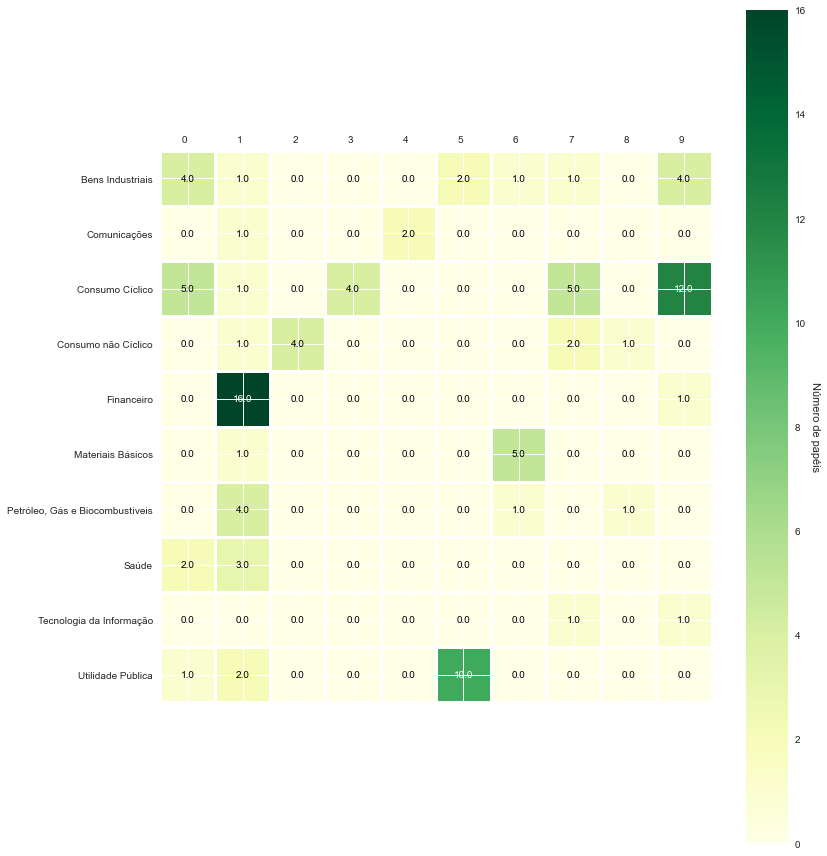

In [64]:
grafico_heatmap(nclusters, labels, 'Heatmap', 'SETOR ECONÔMICO', df_data_precos )

## Geração dos gráficos das séries históricas (clusterizados)

In [65]:
# Gera gráficos dos clusters, utilizando os labels dos clusters 'lstlabels' e um dataframe contendo a série
# histórica de todos os 'códigos de listagem b3' selecionados no experimento
# O parâmetro 'data_final' pode ser utilizado para limitar o tamanho das séries apresentadas, facilitando a
# visualização (se =0, apresenta toda a série histórica)
def grafico_clusters(nclusters, lstlabels, sttitulo, df_data, data_final = 0):
    #Gera um dataframe contendo os agrupamentos (clusters) e gera os gráficos
    fig, subfig = plt.subplots(nclusters, 1, figsize=(8, 5*nclusters))
    fig.suptitle(sttitulo) 
    
    df_clusters = dataframe_clusters(lstlabels, df_data)
    
    subfig_title = ['' for _ in range(nclusters)]
    for idx, linha in df_clusters.iterrows():
        stcodigo_listagem_b3 = linha['Codigo Listagem B3']
        cluster = linha['Cluster']
        #print('Cluster {} - {} - {} '.format(cluster, stcodigo_listagem_b3, accoes.get_setor_subsetor_segmento(stcodigo_listagem_b3[:-1])))
        if (data_final == 0):
            subfig[cluster].plot(df_data.loc[:, stcodigo_listagem_b3], label=stcodigo_listagem_b3)
        else:
            subfig[cluster].plot(df_data.loc[:data_final, stcodigo_listagem_b3], label=stcodigo_listagem_b3)
        #subfig_title[cluster] += (stcodigo_listagem_b3 + ' ')
        #subfig[cluster].set_title(subfig_title[cluster])
        subfig[cluster].legend(ncol=5, loc='upper center')
        subfig[cluster].set_title('Cluster - ' + str(cluster))
        

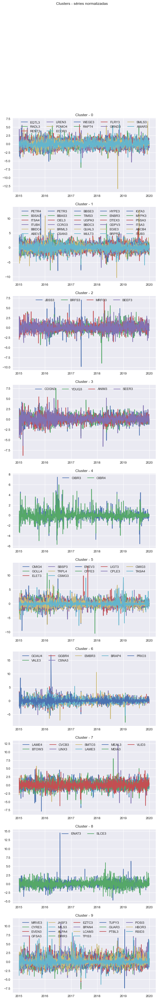

In [66]:
# Gera os gráficos dos clusters, apresentando as séries dos retornos, normalizadas
grafico_clusters(nclusters, labels, 'Clusters - séries normalizadas', df_data)

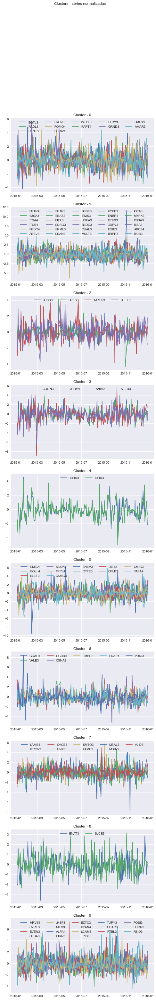

In [67]:
# Gera os gráficos dos clusters, apresentando as séries dos retornos, normalizadas
# (para facilitar a visualização for apresentado apenas parte de cada série)
grafico_clusters(nclusters, labels, 'Clusters - séries normalizadas', df_data, '2015-12-30')

## Geração dos gráficos dos centróides

In [68]:
# Gera o gráifcos dos clusters, colocando em destaque o centróide 

def grafico_clusters_centroide(nclusters, lstlabels, sttitulo, df_data, centroids, data_final = 0):
    #Gera um dataframe contendo os agrupamentos (clusters) e gera os gráficos
    fig, subfig = plt.subplots(nclusters, 1, figsize=(8, 5*nclusters))
    fig.suptitle(sttitulo) 
    
    df_clusters = dataframe_clusters(lstlabels, df_data)
    
    subfig_title = ['' for _ in range(nclusters)]
    for idx, linha in df_clusters.iterrows():
        stcodigo_listagem_b3 = linha['Codigo Listagem B3']
        cluster = linha['Cluster']
        #print('Cluster {} - {} - {} '.format(cluster, stcodigo_listagem_b3, accoes.get_setor_subsetor_segmento(stcodigo_listagem_b3[:-1])))
        if (data_final == 0):
            subfig[cluster].plot(df_data.loc[:,stcodigo_listagem_b3], c='gray',alpha=0.4)
        else:
            subfig[cluster].plot(df_data.loc[:data_final,stcodigo_listagem_b3], c='gray',alpha=0.4)                
        #subfig_title[cluster] += (stcodigo_listagem_b3 + ' ')
        #subfig[cluster].set_title(subfig_title[cluster])
    for idx in range(nclusters):
        subfig[idx].set_title('Cluster - ' + str(idx))
        if (data_final == 0):
            subfig[idx].plot(df_data.index, centroids[idx], c='red')
        else:
            subfig[idx].plot(df_data.loc[:data_final].index, centroids[idx][:len(df_data.loc[:data_final])], c='red')

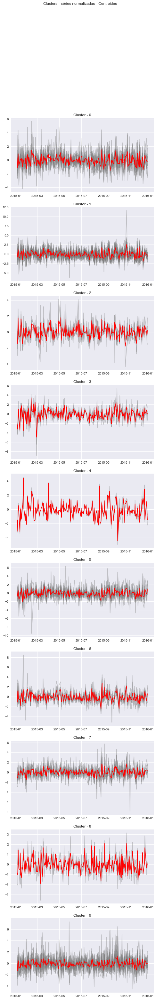

In [69]:
grafico_clusters_centroide(nclusters, labels, 'Clusters - séries normalizadas - Centroides', df_data, km.cluster_centers_, '2015-12-30')

## Geração dos gráficos das séries de preços, agrupados em clusters

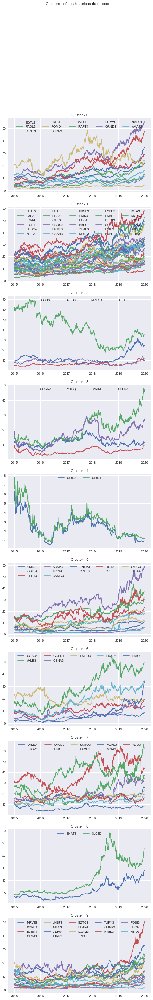

In [70]:
grafico_clusters(nclusters, labels, 'Clusters - séries históricas de preços', df_data_precos)

In [71]:
# Este código foi utilizado durante a execução dos experimentos, mas não foi adicionado no texto final do TCC

# Gera a série de preços normalizada, para serem exibidas em um gráfico de clusters
scaler = preprocessing.MinMaxScaler()
df_data_precos_norm = pd.DataFrame(scaler.fit_transform(df_data_precos), index=df_data_precos.index, columns=df_data_precos.columns)
display(df_data_precos_norm)

,PETR4,B3SA3,ITSA4,ITUB4,OIBR3,BBDC4,ABEV3,GOAU4,VALE3,PETR3,...,TASA4,VLID3,TUPY3,GUAR3,PTBL3,ABCB4,ITUB3,POSI3,HBOR3,RSID3
2015-01-05,0.151782,0.005552,0.095503,0.106234,1.000000,0.187472,0.000000,0.819398,0.190060,0.083599,...,0.351,0.719333,0.206035,0.203985,0.556333,0.140812,0.092088,0.080131,0.815648,0.837728
2015-01-06,0.142035,0.007337,0.099157,0.114926,0.842105,0.204056,0.047813,0.908155,0.203480,0.076160,...,0.307,0.660099,0.193518,0.202646,0.543212,0.130222,0.097589,0.074486,0.837201,0.793780
2015-01-07,0.155611,0.014674,0.117423,0.134683,0.826317,0.224749,0.066141,0.981094,0.216261,0.089975,...,0.307,0.710358,0.192591,0.210116,0.533840,0.121750,0.110435,0.076368,0.894674,0.810683
2015-01-08,0.175106,0.012096,0.122642,0.143535,0.835527,0.227537,0.145658,0.945064,0.220096,0.110167,...,0.318,0.681637,0.193518,0.204037,0.533840,0.122103,0.118691,0.083894,0.875516,0.787018
2015-01-09,0.184854,0.007139,0.104897,0.118403,0.827632,0.203909,0.142275,0.889701,0.212267,0.119731,...,0.329,0.673175,0.183319,0.204037,0.535715,0.115750,0.111538,0.086717,0.810858,0.746450
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-12-20,0.973723,0.976490,0.966824,0.951341,0.051653,0.951517,0.601344,0.754255,0.863617,0.952087,...,0.455,0.160274,0.914072,0.916397,0.824566,0.987779,0.959461,0.958979,0.925824,0.243408
2019-12-23,0.982605,0.924061,0.976581,0.964220,0.048127,0.959334,0.606248,0.762729,0.859752,0.969184,...,0.438,0.172634,0.941078,0.937796,0.845177,0.995497,0.978136,0.915028,0.986264,0.307640
2019-12-26,0.997779,0.918889,1.000000,0.985430,0.044601,0.975323,0.631751,0.774029,0.863617,0.979732,...,0.460,0.200027,0.963174,0.980592,0.904718,0.998714,1.000000,0.906238,0.964286,0.445571
2019-12-27,0.998978,0.861524,0.994146,0.981643,0.046364,0.970349,0.625866,0.770263,0.867856,0.960817,...,0.457,0.212054,0.971153,0.977109,0.893268,0.992924,0.994534,0.886704,0.986264,0.535497


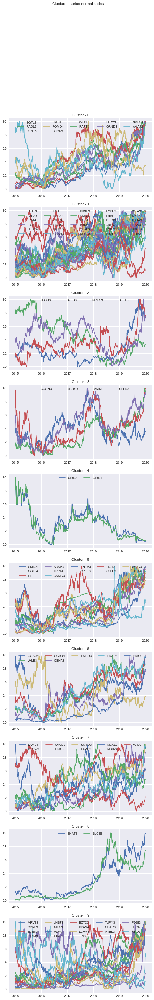

In [72]:
# Gera o gráfico dos clusters (séries históricas de precços, normalizadas)
grafico_clusters(nclusters, labels, 'Clusters - séries normalizadas', df_data_precos_norm)

## Gráfico Silhouette 

In [73]:
# Referência para o código de gerar o gráfico silhouette
def grafico_silhouette(nclusters, lstlabels, df_data):
    sample_silhouette_values = silhouette_samples(df_data, lstlabels)

    # Create a subplot with 1 row and 2 columns
    #fig, (ax1, ax2) = plt.subplots(1, 2)
    fig, ax1 = plt.subplots(1, 1)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 0.5])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(df_data) + (nclusters + 1) * 10])

    y_lower = 10
    for idx in range(nclusters):
        # Pega a lista de valores silhouette para determinado cluster (idx)
        ith_cluster_silhouette_values = sample_silhouette_values[lstlabels == idx]
        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(idx) / nclusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                              0, ith_cluster_silhouette_values,
                              facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(idx))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("Gráfico silhouette plot para os clusters")
    ax1.set_xlabel("Valores dos coeficientes silhouette")
    ax1.set_ylabel("Cluster")

    silhouette_avg = silhouette_score(df_data, lstlabels)
    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.1, 0.3, 0.5])
    plt.show()

In [74]:
silhouette_avg = silhouette_score(df_data.T, labels)
print('Silhouette (médio) = {}'.format(silhouette_avg))


Silhouette (médio) = 0.037113611264657564


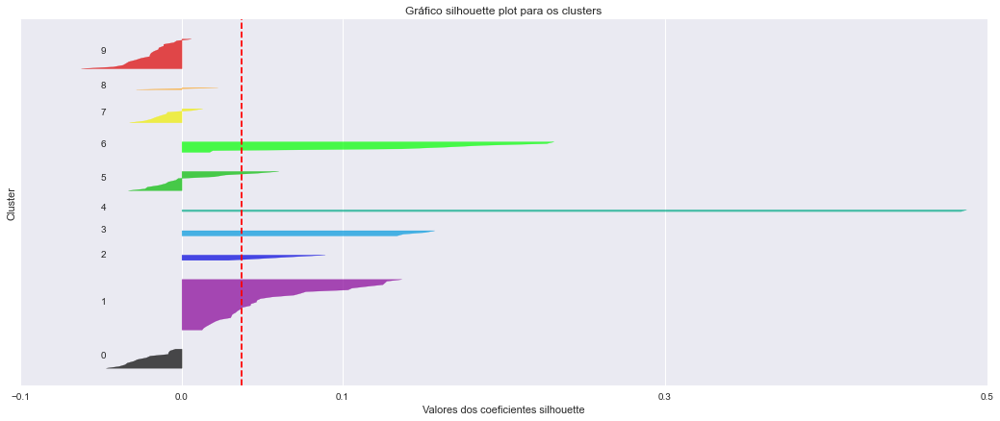

In [75]:
grafico_silhouette(nclusters, labels, df_data.T)

## Itera pelos números de cluster 2 a 14

array([1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1,
       0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1,
       1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1,
       0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0])

Número do cluster = 2 - Silhouette (médio) = 0.03720789656483775


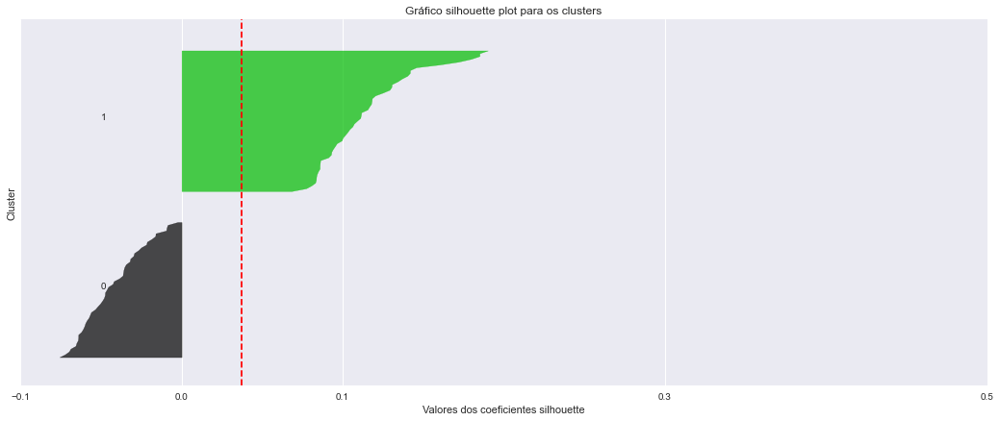

array([2, 2, 2, 2, 0, 2, 2, 1, 1, 2, 2, 1, 0, 2, 2, 2, 1, 2, 2, 2, 2, 2,
       0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 0, 2, 2, 0, 2, 1,
       2, 2, 2, 2, 2, 2, 0, 2, 2, 0, 2, 2, 0, 2, 2, 2, 0, 2, 0, 2, 0, 2,
       0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 0, 0, 0, 2, 0, 0, 2, 0,
       0, 2, 0, 0, 0, 2, 0, 2, 2, 0, 0, 0])

Número do cluster = 3 - Silhouette (médio) = 0.03399903616690771


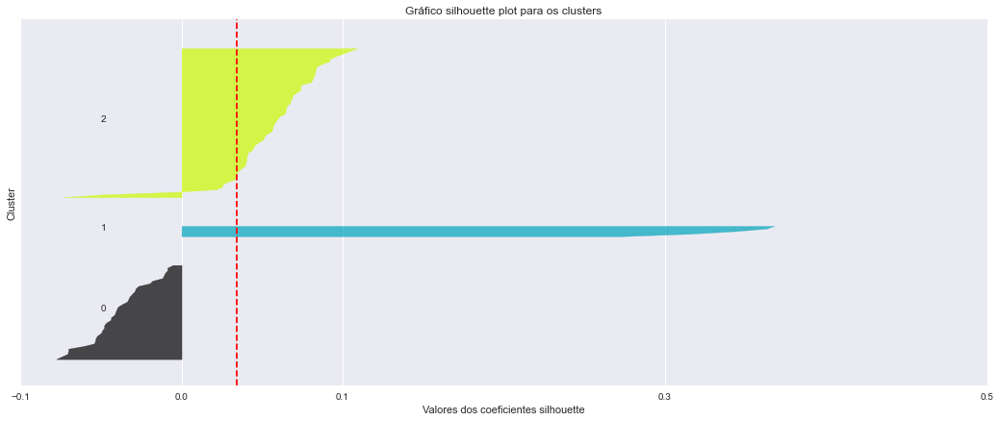

array([0, 2, 2, 2, 1, 2, 2, 0, 0, 0, 1, 0, 3, 2, 2, 2, 0, 2, 2, 2, 2, 2,
       1, 3, 2, 2, 2, 2, 1, 0, 1, 2, 1, 3, 2, 2, 1, 2, 0, 2, 2, 2, 2, 0,
       2, 2, 2, 1, 1, 1, 3, 2, 1, 1, 2, 2, 1, 1, 1, 2, 1, 1, 1, 1, 1, 2,
       1, 2, 1, 2, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 0, 2, 1, 1, 2, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1])

Número do cluster = 4 - Silhouette (médio) = 0.027638901148063187


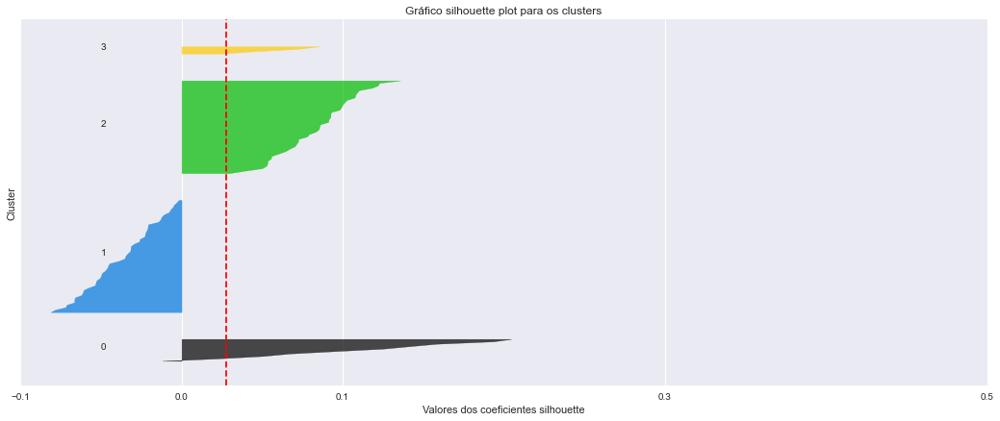

array([4, 2, 2, 2, 1, 2, 2, 4, 4, 4, 2, 4, 3, 0, 2, 2, 4, 2, 2, 2, 2, 2,
       1, 3, 2, 2, 2, 2, 0, 2, 2, 2, 0, 3, 2, 2, 2, 0, 4, 0, 2, 2, 2, 4,
       2, 2, 2, 0, 0, 0, 3, 2, 0, 4, 2, 2, 0, 0, 0, 2, 0, 2, 0, 0, 0, 2,
       0, 0, 2, 0, 4, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 4, 2, 0, 2, 2, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0])

Número do cluster = 5 - Silhouette (médio) = 0.040441043456950085


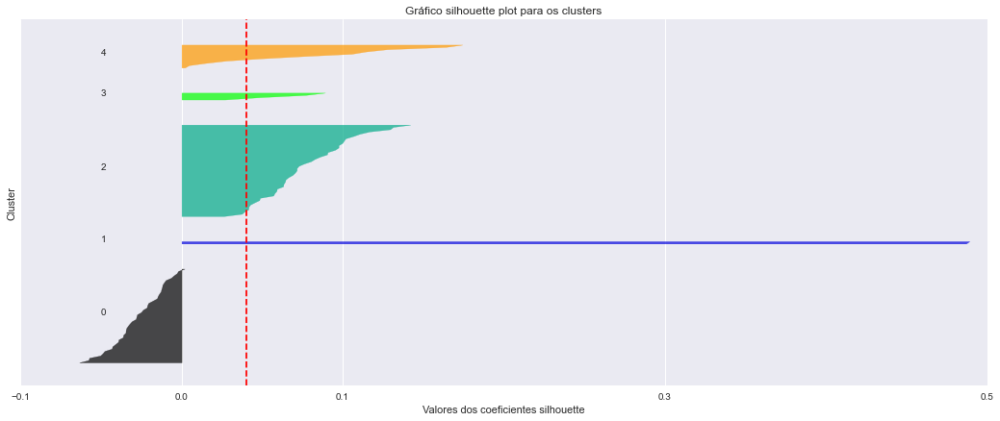

array([1, 1, 1, 1, 2, 1, 0, 4, 4, 4, 0, 4, 0, 5, 1, 0, 4, 0, 0, 0, 0, 1,
       2, 0, 0, 1, 0, 0, 0, 0, 0, 0, 3, 3, 1, 0, 0, 5, 4, 0, 0, 3, 0, 4,
       0, 5, 5, 1, 1, 0, 3, 5, 5, 3, 5, 3, 5, 0, 0, 5, 3, 3, 3, 0, 0, 0,
       0, 5, 3, 5, 3, 3, 0, 0, 3, 1, 0, 3, 3, 0, 3, 3, 4, 1, 3, 0, 1, 3,
       0, 0, 3, 3, 3, 0, 0, 1, 1, 3, 3, 3])

Número do cluster = 6 - Silhouette (médio) = 0.011634487591657425


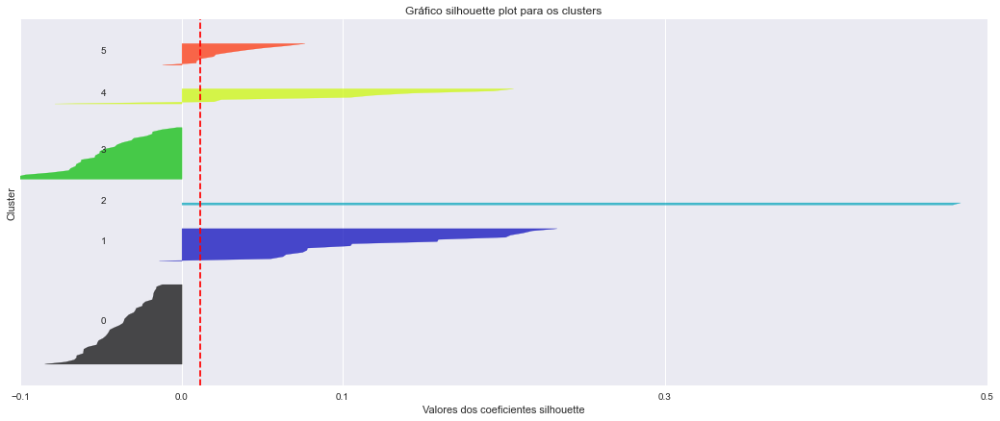

array([3, 0, 0, 0, 1, 0, 6, 3, 3, 3, 6, 3, 6, 5, 0, 0, 3, 0, 5, 6, 6, 6,
       1, 6, 6, 0, 6, 6, 6, 6, 6, 6, 3, 6, 0, 6, 6, 5, 2, 6, 0, 6, 6, 3,
       6, 5, 5, 6, 6, 6, 6, 5, 5, 2, 5, 6, 5, 6, 6, 5, 2, 6, 4, 6, 6, 6,
       2, 5, 6, 5, 3, 4, 2, 2, 2, 6, 6, 6, 6, 6, 4, 2, 3, 0, 2, 2, 0, 6,
       6, 2, 3, 6, 4, 2, 3, 0, 0, 6, 4, 4])

Número do cluster = 7 - Silhouette (médio) = 0.0115228299517335


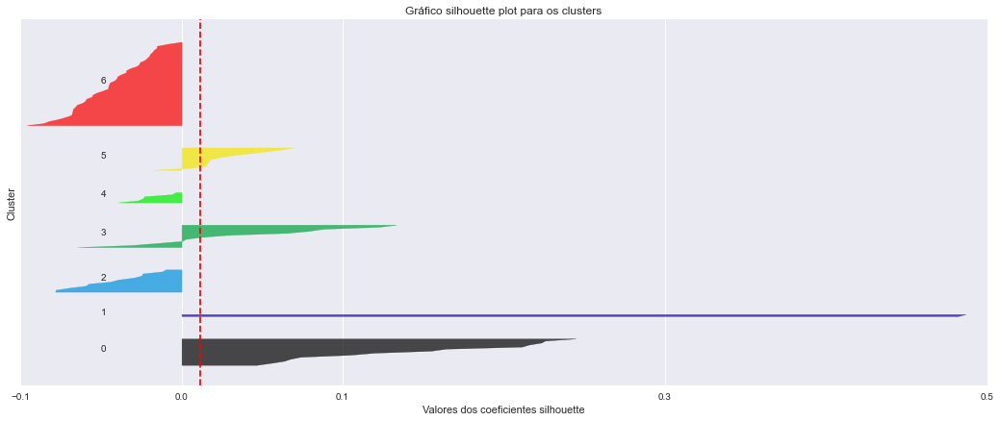

array([0, 0, 0, 0, 6, 0, 5, 7, 7, 0, 2, 7, 1, 0, 0, 0, 7, 0, 0, 5, 0, 0,
       6, 5, 0, 0, 5, 5, 5, 0, 5, 0, 0, 1, 0, 0, 2, 0, 3, 0, 5, 0, 0, 7,
       0, 0, 0, 0, 0, 5, 1, 0, 0, 4, 0, 5, 0, 0, 0, 0, 4, 4, 4, 0, 5, 0,
       2, 0, 0, 0, 0, 4, 4, 4, 4, 0, 5, 3, 0, 0, 4, 4, 7, 0, 4, 2, 0, 4,
       5, 5, 4, 5, 4, 4, 4, 0, 0, 4, 4, 4])

Número do cluster = 8 - Silhouette (médio) = 0.04640744072516565


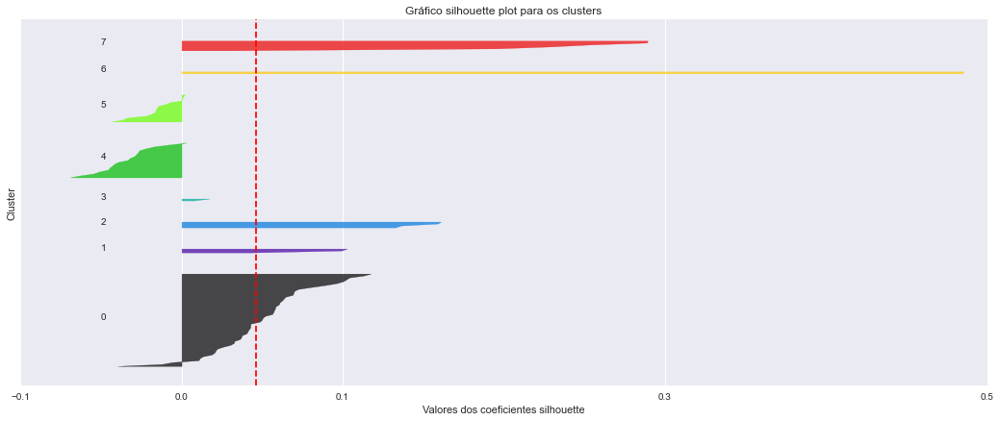

array([7, 6, 6, 6, 4, 6, 6, 1, 1, 7, 0, 1, 2, 6, 6, 2, 1, 6, 6, 6, 6, 2,
       4, 2, 6, 6, 6, 6, 6, 6, 6, 2, 6, 7, 6, 6, 0, 6, 2, 6, 6, 2, 6, 1,
       2, 6, 5, 6, 6, 2, 2, 6, 5, 8, 6, 2, 2, 2, 3, 6, 2, 3, 2, 2, 2, 6,
       0, 6, 6, 6, 7, 3, 3, 3, 3, 6, 6, 3, 2, 6, 2, 3, 7, 2, 3, 0, 6, 2,
       2, 2, 2, 2, 3, 3, 2, 6, 6, 2, 3, 2])

Número do cluster = 9 - Silhouette (médio) = 0.03818906920030779


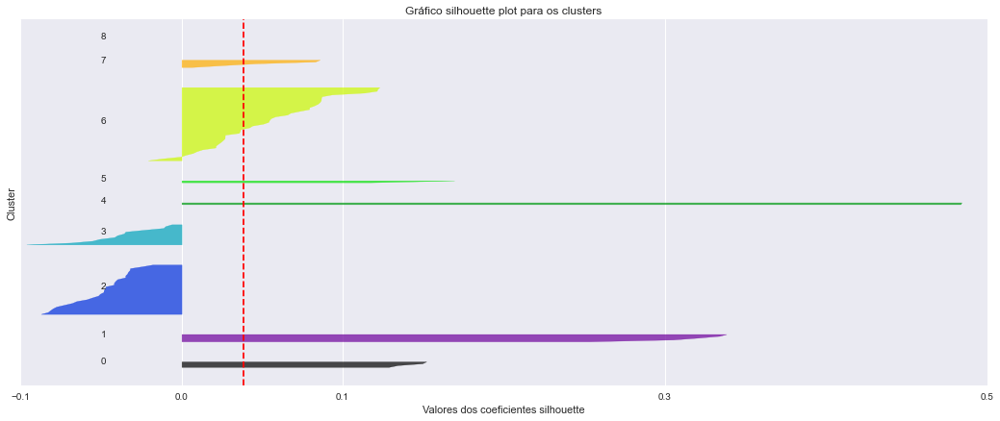

array([1, 1, 1, 1, 4, 1, 1, 6, 6, 1, 3, 6, 2, 5, 1, 1, 6, 1, 0, 0, 1, 1,
       4, 2, 0, 1, 7, 0, 0, 1, 9, 1, 5, 2, 1, 0, 3, 5, 6, 9, 0, 1, 1, 6,
       1, 1, 5, 0, 1, 7, 2, 5, 5, 5, 5, 1, 5, 0, 9, 1, 9, 1, 9, 7, 0, 1,
       3, 5, 0, 5, 8, 9, 9, 7, 7, 1, 7, 8, 9, 9, 9, 9, 6, 1, 7, 3, 1, 9,
       0, 7, 5, 7, 9, 9, 9, 1, 1, 9, 9, 9])

Número do cluster = 10 - Silhouette (médio) = 0.037113611264657564


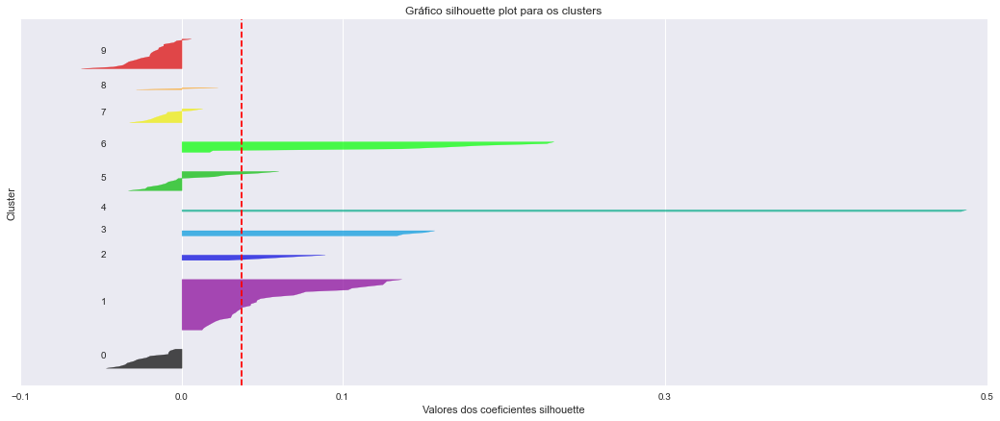

array([ 1,  1,  1,  1, 10,  1,  1,  6,  6,  1,  3,  6,  2,  4,  1,  1,  6,
        1,  1,  1,  1,  1, 10,  2,  1,  1,  1,  1,  1,  1,  1,  1,  1,  2,
        1,  1,  3,  4,  5,  1,  1,  1,  1,  6,  1,  1,  0,  1,  1,  2,  2,
        4,  0,  2,  4,  1,  4,  2,  1,  1,  2,  2,  2,  1,  2,  1,  3,  4,
        1,  4,  2,  2,  2,  2,  2,  1,  1,  2,  1,  1,  2,  2,  8,  1,  7,
        3,  1,  9,  2,  1,  2,  2,  2,  2,  2,  1,  1,  2,  2,  2])

Número do cluster = 11 - Silhouette (médio) = 0.04009507655844488


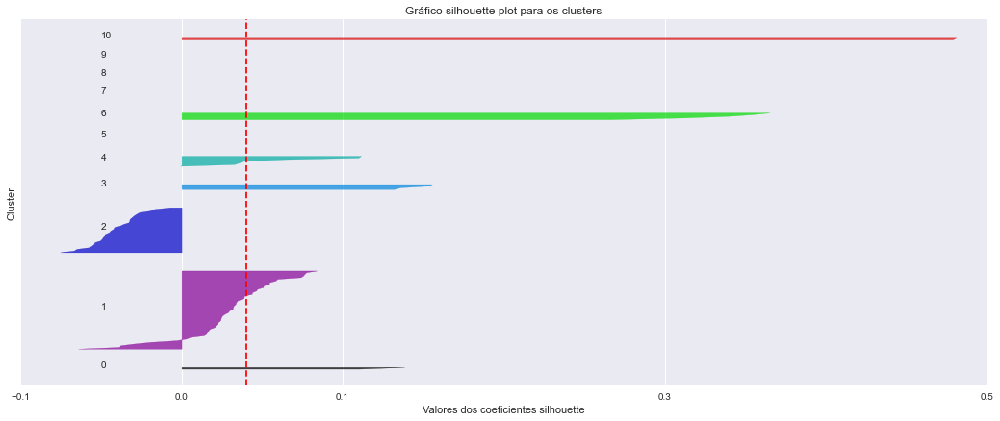

array([11,  1,  1,  1,  9,  1,  1,  6,  6, 11,  4,  6,  2,  7,  1,  1,  6,
        1,  1,  1,  1,  1,  9,  2,  1,  1,  1,  1,  1,  1,  1,  1,  7,  8,
        1,  1,  4,  7, 10,  1,  1,  3,  1,  6,  3,  1,  1,  3,  1,  3,  8,
        1,  7,  3,  7,  1,  7,  3,  3,  1,  3,  0,  3,  1,  3,  1,  4,  7,
        3,  7, 11,  3,  3,  3,  7,  3,  1,  0,  1,  1,  5,  7, 11,  1,  3,
        4,  1,  3,  3,  1,  3,  3,  3,  3,  3,  3,  1,  3,  3,  3])

Número do cluster = 12 - Silhouette (médio) = 0.05028820814210673


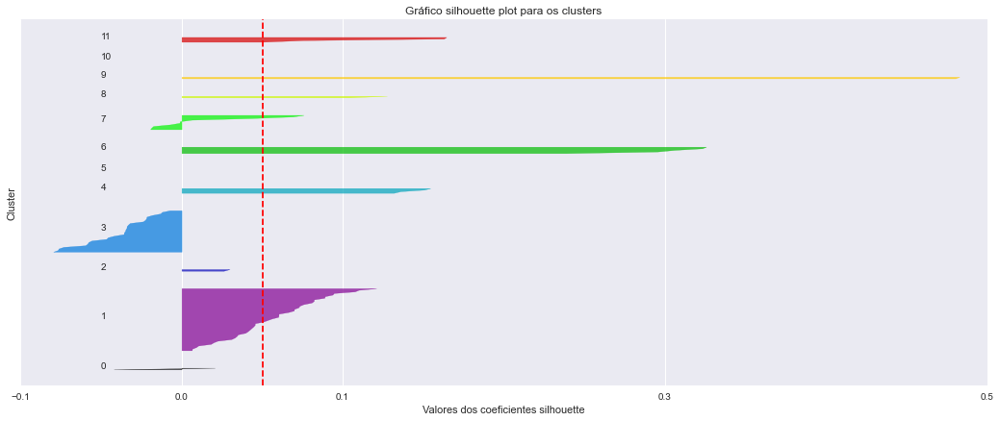

array([ 6,  0,  0,  0,  4,  0,  0,  3,  3,  6,  7,  3,  8,  5,  0,  0,  3,
        0,  1, 10,  0,  0,  4,  8,  0,  0, 10,  0, 10,  0, 11,  0,  0,  8,
        0,  0,  7,  5,  6, 11,  0,  0,  0,  3,  0,  1,  0,  0,  0, 10,  8,
        1,  5,  5,  1,  1,  5,  0, 11,  1, 11, 10, 11, 11,  0,  0,  7,  5,
        0,  5,  6, 11,  0, 10, 12,  0, 10,  1, 11, 11,  0,  2,  6,  0, 10,
        7,  0,  9, 10,  0,  0, 10, 12,  0, 11,  0,  0, 11, 11, 11])

Número do cluster = 13 - Silhouette (médio) = 0.052203106147615426


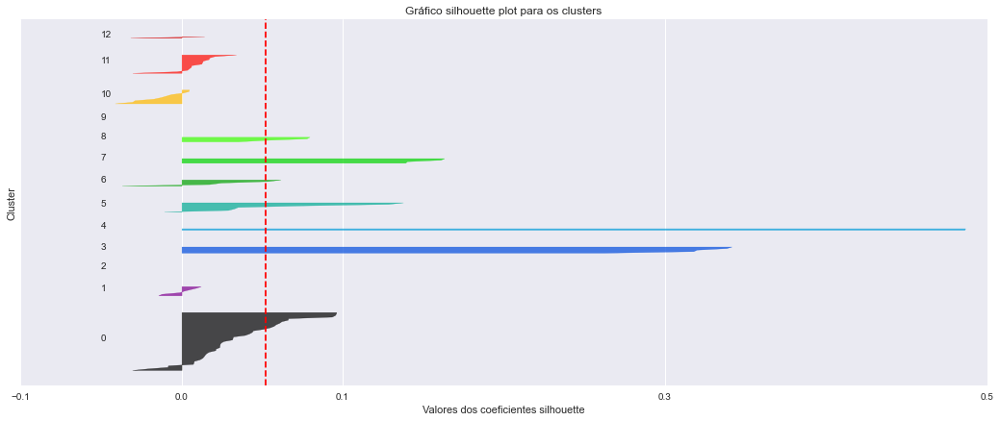

array([ 3,  1,  7,  7, 13,  7,  1,  8,  8,  3, 10,  8, 12,  4,  7,  1,  8,
        6,  1,  1,  6,  3, 13, 12,  6,  1,  6,  1,  0,  3,  2,  1,  4, 12,
        7,  6, 10,  4, 11,  2,  1,  1,  6,  8,  1,  1,  4,  0,  6,  6, 12,
        4,  4,  4,  4,  5,  4,  1,  2,  1,  9,  6,  3,  2,  2,  6, 10,  4,
        2,  4,  3,  2,  2,  1,  6,  0,  6,  1,  2,  2,  3,  2,  3,  7,  2,
       10,  7,  1,  1,  2,  3,  1,  0,  6,  2,  7,  7,  3,  2,  2])

Número do cluster = 14 - Silhouette (médio) = 0.024497968614598492


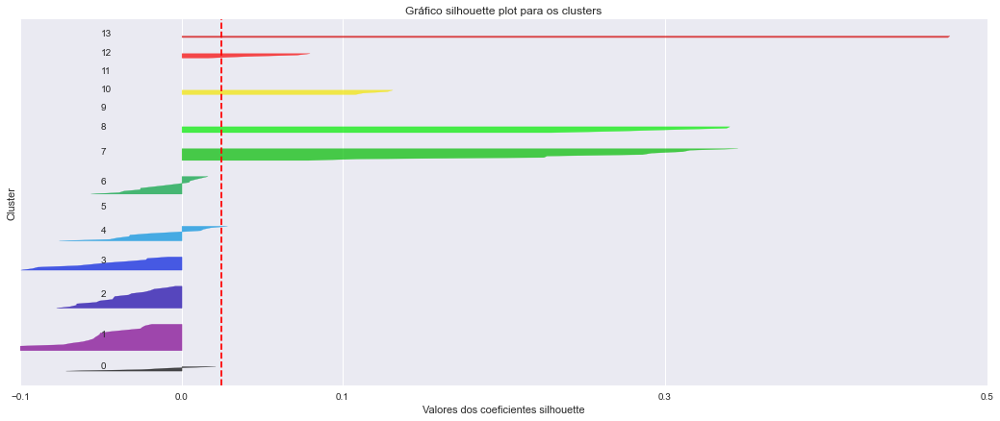

In [76]:
# Calcula os índices silhouette
lst_silhouette_avg = []

for i in range(2,15):
    # Faz o agrupamentos de clusters utilizando o kmeans (timeseries)
    # 
    km = TimeSeriesKMeans(n_clusters = i, metric='euclidean', n_init=300, random_state=3)
    labels = km.fit_predict(df_data.T)
    display(labels)
    
    silhouette_avg = silhouette_score(df_data.T, labels)
    print('Número do cluster = {} - Silhouette (médio) = {}'.format(i, silhouette_avg))
    lst_silhouette_avg.append(silhouette_avg)    
        
    grafico_silhouette(i, labels, df_data.T)
    


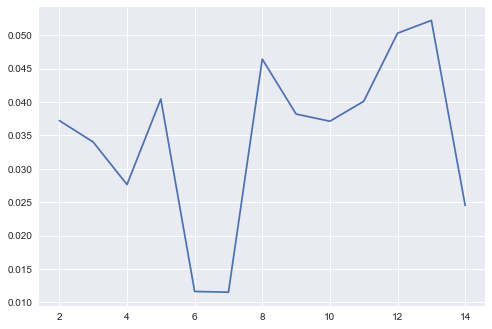

In [77]:
# Gráfico Silhouette
x = np.array(range(2,15))
y = np.array(lst_silhouette_avg)
plt.plot(x,y)
    

## TimeSeriesKMeans usando o número de cluster que tem o mmaior silhouette

In [78]:
# Usando o ncluster de com maior silhouette médio:
idx = lst_silhouette_avg.index(max(lst_silhouette_avg))
nclusters = range(2,15)[idx]
print('Número de clusters selecionado - {}'.format(nclusters))

Número de clusters selecionado - 13


In [79]:
# 
km = TimeSeriesKMeans(n_clusters = nclusters, metric='euclidean', n_init=300, random_state=3)
labels = km.fit_predict(df_data.T)
display(labels)
    

array([ 6,  0,  0,  0,  4,  0,  0,  3,  3,  6,  7,  3,  8,  5,  0,  0,  3,
        0,  1, 10,  0,  0,  4,  8,  0,  0, 10,  0, 10,  0, 11,  0,  0,  8,
        0,  0,  7,  5,  6, 11,  0,  0,  0,  3,  0,  1,  0,  0,  0, 10,  8,
        1,  5,  5,  1,  1,  5,  0, 11,  1, 11, 10, 11, 11,  0,  0,  7,  5,
        0,  5,  6, 11,  0, 10, 12,  0, 10,  1, 11, 11,  0,  2,  6,  0, 10,
        7,  0,  9, 10,  0,  0, 10, 12,  0, 11,  0,  0, 11, 11, 11])

In [80]:
df_clusters = dataframe_clusters(labels, df_data)
df_clusters.sort_values(['Cluster', 'SETOR ECONÔMICO'], inplace=True)
display(df_clusters)

,Cluster,Codigo Listagem B3,SETOR ECONÔMICO,SUBSETOR,SEGMENTO,Nome,Codigo Listagem,Mercado
17,0,CCRO3,Bens Industriais,Transporte,Exploração de Rodovias,CCR SA,CCRO,NM
32,0,GOLL4,Bens Industriais,Transporte,Transporte Aéreo,GOL,GOLL,N2
35,0,ECOR3,Bens Industriais,Transporte,Exploração de Rodovias,ECORODOVIAS,ECOR,NM
40,0,WEGE3,Bens Industriais,Máquinas e Equipamentos,"Motores, Compressores e Outros",WEG,WEGE,NM
47,0,RAPT4,Bens Industriais,Material de Transporte,Material Rodoviário,RANDON PART,RAPT,N1
...,...,...,...,...,...,...,...,...
98,11,HBOR3,Consumo Cíclico,Construção Civil,Incorporações,HELBOR,HBOR,NM
99,11,RSID3,Consumo Cíclico,Construção Civil,Incorporações,ROSSI RESID,RSID,NM
97,11,POSI3,Tecnologia da Informação,Computadores e Equipamentos,Computadores e Equipamentos,POSITIVO TEC,POSI,NM
92,12,TUPY3,Bens Industriais,Material de Transporte,Material Rodoviário,TUPY,TUPY,NM


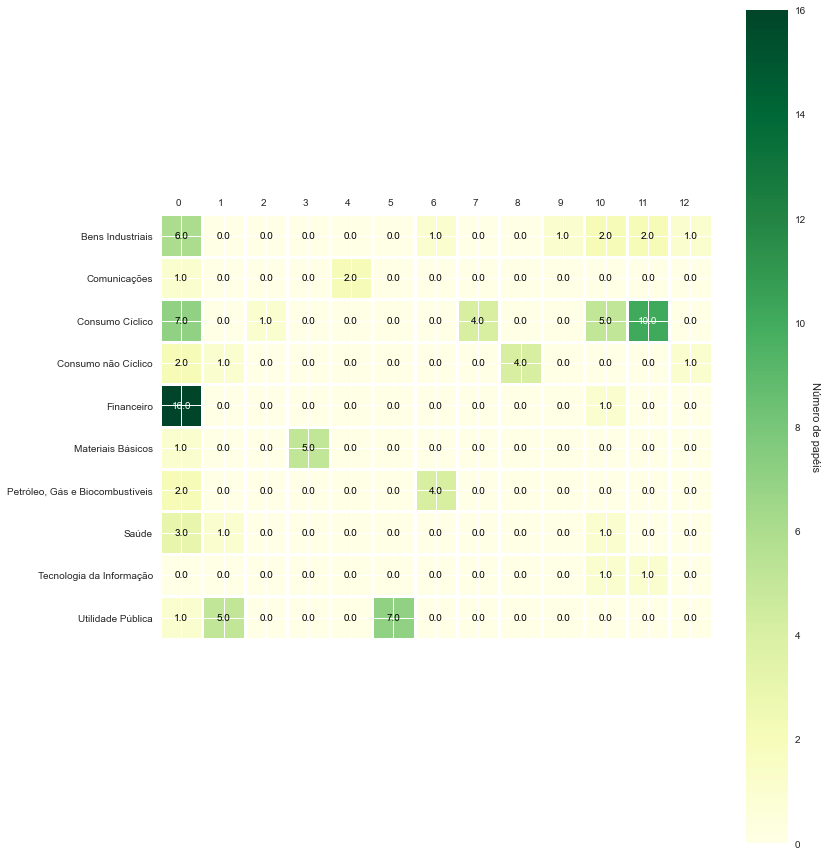

In [81]:
grafico_heatmap(nclusters, labels, 'Heatmap', 'SETOR ECONÔMICO', df_data_precos )

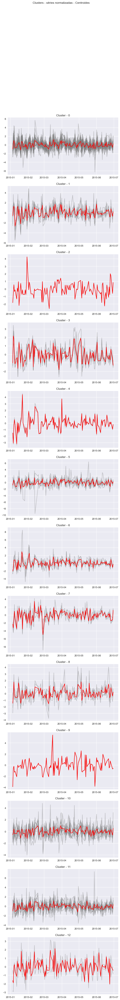

In [82]:
grafico_clusters_centroide(nclusters, labels, 'Clusters - séries normalizadas - Centroides', df_data, km.cluster_centers_, '2015-06-30')

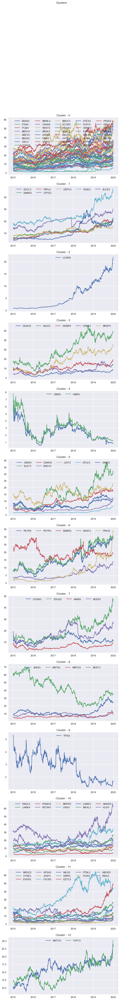

In [83]:
# Gera o gráfico dos clusters (séries históricas de precços)
grafico_clusters(nclusters, labels, 'Clusters', df_data_precos)

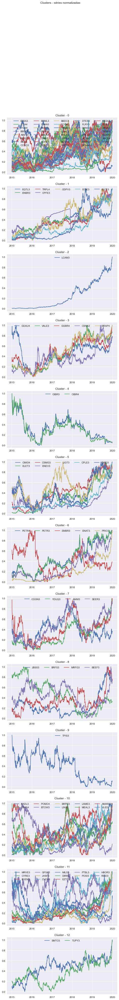

In [84]:
# Gera o gráfico dos clusters (séries históricas de precços, normalizadas)
grafico_clusters(nclusters, labels, 'Clusters - séries normalizadas', df_data_precos_norm)

In [85]:
silhouette_avg = silhouette_score(df_data.T, labels)
print('Silhouette (médio) = {}'.format(silhouette_avg))

Silhouette (médio) = 0.052203106147615426


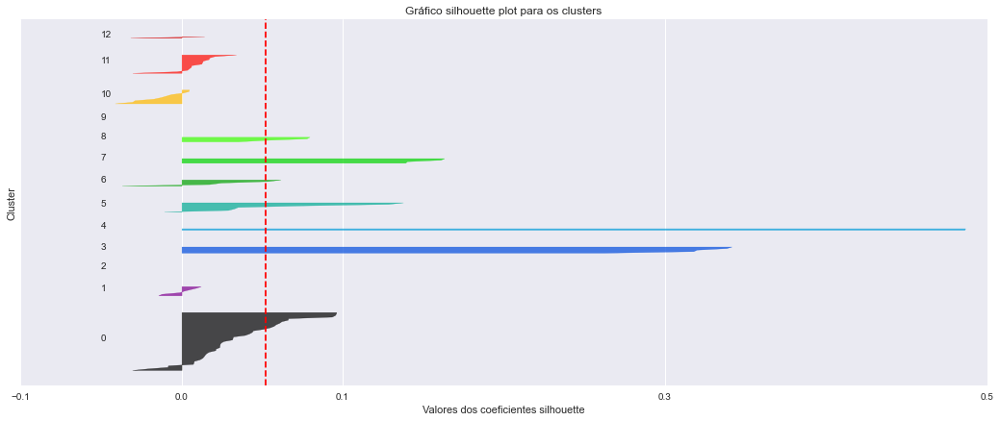

In [86]:
grafico_silhouette(nclusters, labels, df_data.T)

## Experimento com o KShape - nsetores  = ao número de setores encontrados nas ações selecionados

In [87]:
# Número de clusters = numero de setores da lista de acoes selecionadas
nclusters = len(s_setores_series_selecionados)
display(nclusters)


10

In [88]:
display(df_data)

,PETR4,B3SA3,ITSA4,ITUB4,OIBR3,BBDC4,ABEV3,GOAU4,VALE3,PETR3,...,TASA4,VLID3,TUPY3,GUAR3,PTBL3,ABCB4,ITUB3,POSI3,HBOR3,RSID3
2015-01-05,-2.766429,-1.384962,0.122726,0.217305,-1.475796,0.049362,-1.329721,-1.365849,-0.531141,-2.691585,...,-2.150252,-0.393891,-0.434152,-1.494263,-0.022414,-0.442174,-0.718444,1.396160,-0.768677,-2.737874
2015-01-06,-1.088179,0.390799,0.359173,0.812109,-2.945741,1.526219,2.715209,2.790954,1.254551,-0.876535,...,-1.932779,-2.347639,-0.866691,-0.199360,-0.610637,-1.230929,0.523196,-0.885956,0.555942,-0.875811
2015-01-07,1.450583,1.822378,2.002224,1.879577,-0.334388,1.853450,0.984996,2.085014,1.145068,1.526907,...,-0.027294,2.128452,-0.100952,0.788392,-0.448794,-1.018524,1.279676,0.229041,1.486038,0.331730
2015-01-08,2.006898,-0.716605,0.511013,0.783887,0.215082,0.199633,4.305434,-0.982244,0.300150,2.148077,...,0.500576,-1.142497,0.023859,-0.719236,-0.022414,-0.011440,0.784462,1.072441,-0.497337,-0.491822
2015-01-09,0.917272,-1.325383,-1.962088,-2.384518,-0.163175,-2.122584,-0.201778,-1.552862,-0.739008,0.925776,...,0.486687,-0.338612,-0.724656,-0.049588,0.063783,-0.790993,-0.768965,0.351739,-1.657452,-0.853415
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-12-20,-0.411402,0.457410,-0.562392,-0.283846,0.245641,-0.387956,0.859912,0.741854,0.430080,-0.422498,...,-0.372979,-0.402406,6.329089,0.462865,-0.179974,0.267454,-0.537364,2.748464,-0.020401,-1.018613
2019-12-23,0.204599,-2.250937,0.337948,0.446109,-0.454538,0.248093,0.162272,0.273210,-0.168101,0.430170,...,-0.625548,1.039117,0.885739,0.822052,0.689387,0.240919,0.716450,-1.255988,1.444376,3.231893
2019-12-26,0.379918,-0.300140,0.882107,0.760163,-0.465228,0.552520,0.958288,0.365612,0.080741,0.242232,...,0.771380,2.236430,0.704010,1.661021,1.998241,0.069033,0.836236,-0.305969,-0.527006,5.939848
2019-12-27,-0.014361,-2.580843,-0.286020,-0.193627,0.253940,-0.230718,-0.252373,-0.140888,0.092268,-0.567515,...,-0.131924,0.939312,0.225664,-0.183793,-0.392464,-0.270732,-0.272330,-0.616585,0.495373,2.940996


In [89]:
# Faz o agrupamentos de clusters utilizando o kshape (timeseries)
# 
ks = KShape(n_clusters = nclusters, n_init=2, random_state=3)
labels = ks.fit_predict(df_data.T)
display(labels)


array([7, 7, 2, 2, 8, 2, 2, 7, 7, 7, 3, 7, 8, 7, 7, 2, 7, 3, 3, 8, 3, 0,
       2, 8, 3, 2, 8, 8, 2, 2, 6, 7, 7, 3, 2, 3, 8, 7, 1, 6, 2, 7, 3, 7,
       4, 7, 7, 7, 7, 8, 3, 7, 7, 4, 3, 2, 7, 7, 6, 7, 6, 3, 7, 6, 2, 3,
       7, 7, 7, 7, 7, 6, 6, 8, 0, 7, 8, 1, 6, 6, 7, 9, 7, 2, 7, 7, 2, 7,
       8, 8, 0, 8, 5, 5, 6, 7, 2, 2, 6, 6])

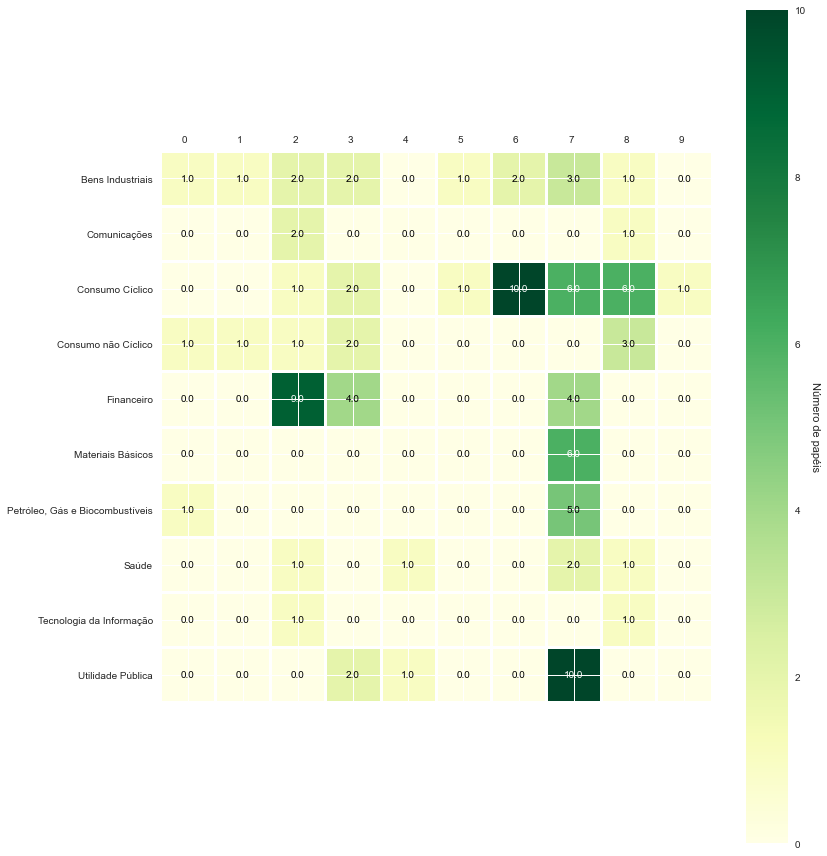

In [90]:
grafico_heatmap(nclusters, labels, 'Heatmap', 'SETOR ECONÔMICO', df_data_precos )

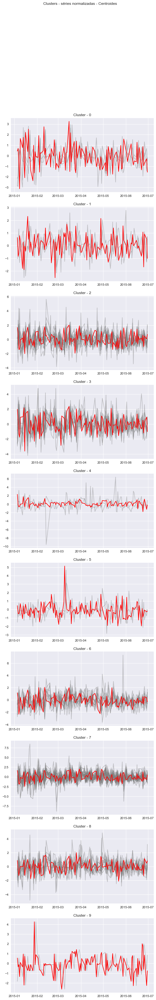

In [91]:
grafico_clusters_centroide(nclusters, labels, 'Clusters - séries normalizadas - Centroides', df_data, ks.cluster_centers_, '2015-06-30')

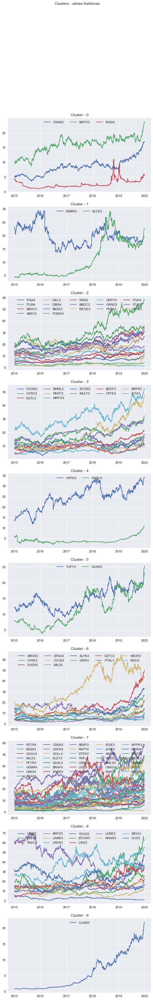

In [92]:
# Gera o gráficos dos clusters, apresentando as séries (sem normalização)
grafico_clusters(nclusters, labels, 'Clusters - séries históricas', df_data_precos)

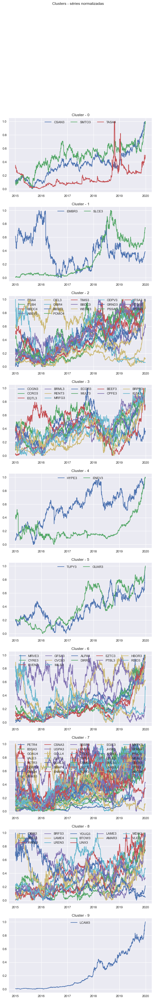

In [93]:
# Gera o gráfico dos clusters (séries históricas de precços, normalizadas)
grafico_clusters(nclusters, labels, 'Clusters - séries normalizadas', df_data_precos_norm)

In [94]:
silhouette_avg = silhouette_score(df_data.T, labels)
print('Silhouette (médio) = {}'.format(silhouette_avg))

Silhouette (médio) = 0.0062604382897345


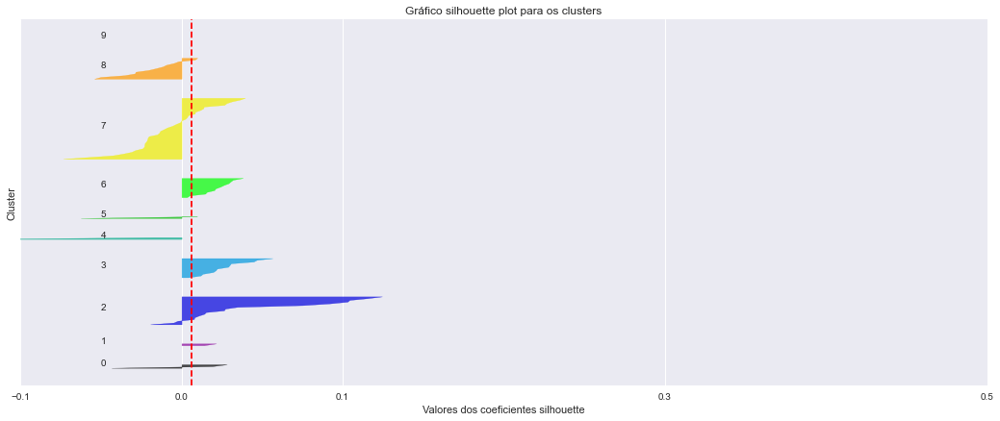

In [95]:
grafico_silhouette(nclusters, labels, df_data.T)

## Itera pelo número de clusters de 2 a 14

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0,
       0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0])

Número do cluster = 2 - Silhouette (médio) = 0.039259371262471573


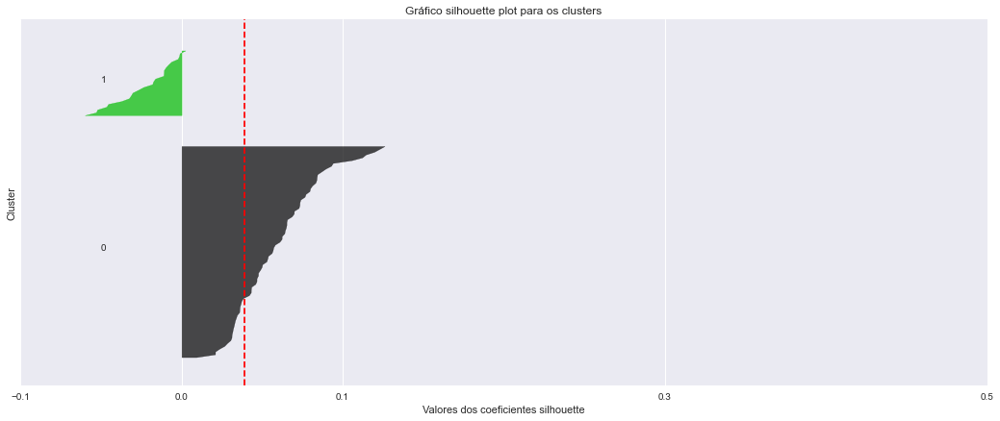

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 2, 1, 2,
       1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 2, 1, 2, 1, 1, 1,
       1, 2, 1, 1, 1, 1, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1,
       1, 1, 1, 1, 1, 1, 0, 0, 2, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2,
       1, 2, 2, 2, 0, 1, 1, 1, 1, 1, 1, 1])

Número do cluster = 3 - Silhouette (médio) = 0.04368424385605108


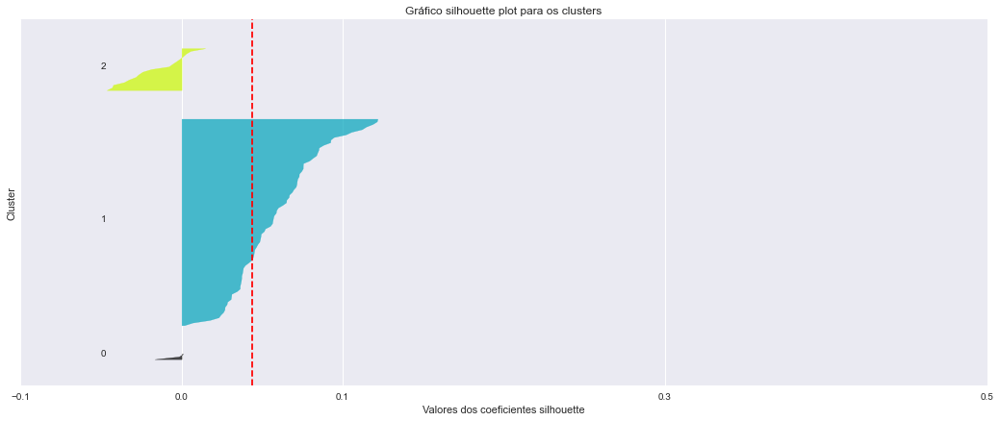

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 2, 0, 1,
       0, 1, 0, 0, 0, 2, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 2, 0, 0, 0,
       2, 1, 0, 0, 0, 0, 3, 1, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 1, 1, 1, 3, 0, 0, 0, 0, 0, 0, 0])

Número do cluster = 4 - Silhouette (médio) = 0.0030804425874849696


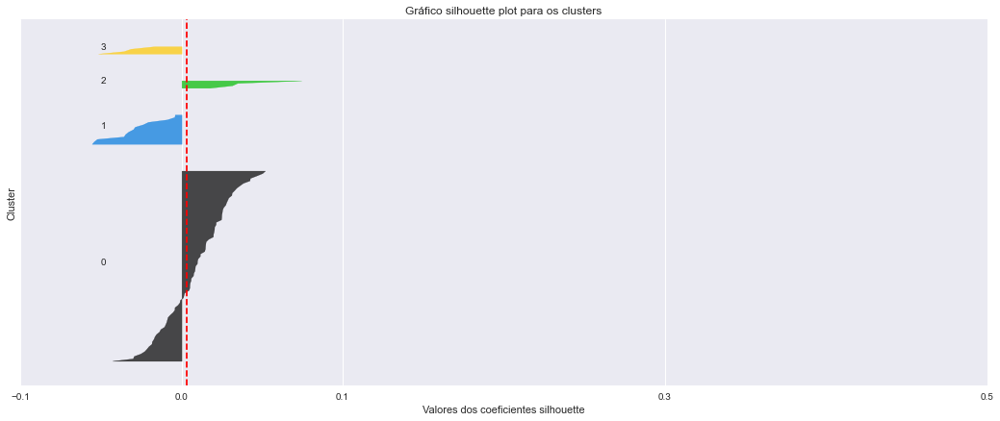

array([4, 1, 1, 1, 4, 1, 1, 4, 4, 4, 1, 4, 1, 2, 1, 1, 4, 1, 1, 1, 1, 1,
       1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 4, 1, 1, 1, 1, 4, 1, 1, 1, 1, 4,
       1, 1, 1, 1, 1, 1, 0, 1, 1, 2, 1, 0, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 2, 4, 1, 3, 3, 1, 1, 1, 1, 1, 1, 1, 1, 4, 1, 1, 1, 1, 1,
       0, 1, 4, 1, 3, 1, 1, 1, 1, 1, 1, 1])

Número do cluster = 5 - Silhouette (médio) = 0.020677791671985822


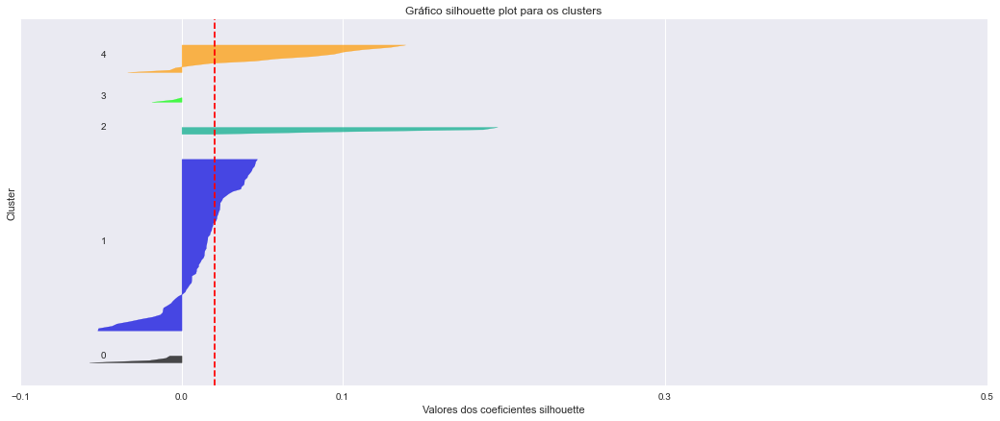

array([4, 1, 1, 1, 4, 1, 1, 4, 4, 4, 1, 4, 5, 2, 1, 1, 4, 1, 1, 1, 1, 5,
       1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 4, 1, 1, 1, 1, 4, 1, 1, 1, 1, 4,
       1, 1, 1, 1, 1, 1, 0, 1, 1, 2, 1, 0, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 2, 4, 1, 3, 3, 5, 1, 1, 1, 1, 1, 1, 1, 4, 1, 1, 1, 1, 1,
       0, 1, 5, 1, 3, 1, 1, 1, 1, 1, 1, 1])

Número do cluster = 6 - Silhouette (médio) = 0.022520843443156822


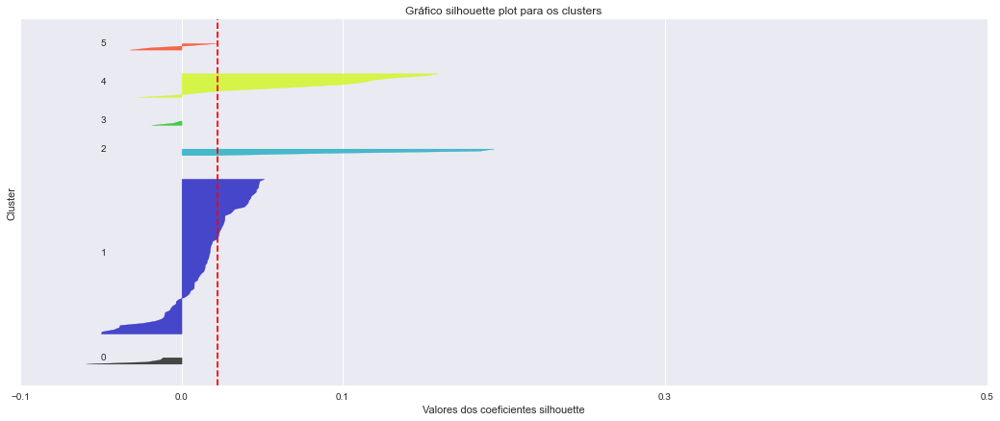

array([4, 1, 1, 1, 4, 1, 1, 4, 4, 4, 1, 4, 5, 2, 1, 1, 4, 1, 1, 6, 1, 5,
       1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 4, 1, 1, 1, 1, 4, 1, 1, 1, 1, 4,
       1, 1, 1, 1, 1, 1, 0, 1, 1, 2, 1, 0, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 2, 4, 1, 3, 3, 5, 1, 1, 1, 1, 1, 1, 1, 4, 1, 1, 1, 1, 1,
       0, 1, 5, 1, 3, 1, 1, 1, 1, 1, 1, 1])

Número do cluster = 7 - Silhouette (médio) = 0.018386619927379496


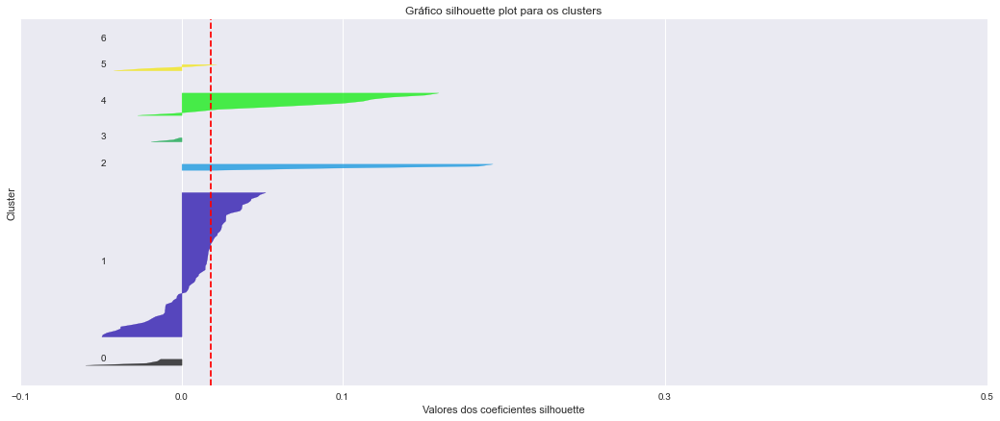

array([4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 1, 4, 5, 4, 4, 4, 4, 5, 5, 4, 5, 2,
       4, 4, 5, 4, 5, 5, 4, 4, 5, 4, 4, 5, 4, 5, 1, 4, 3, 5, 4, 0, 5, 4,
       6, 4, 4, 4, 4, 5, 5, 4, 5, 6, 5, 4, 4, 4, 5, 4, 5, 5, 4, 4, 4, 5,
       1, 4, 4, 4, 4, 4, 5, 4, 2, 4, 5, 1, 5, 5, 4, 5, 0, 4, 4, 1, 4, 0,
       7, 4, 2, 5, 7, 7, 4, 4, 4, 4, 5, 4])

Número do cluster = 8 - Silhouette (médio) = 0.013113850154862544


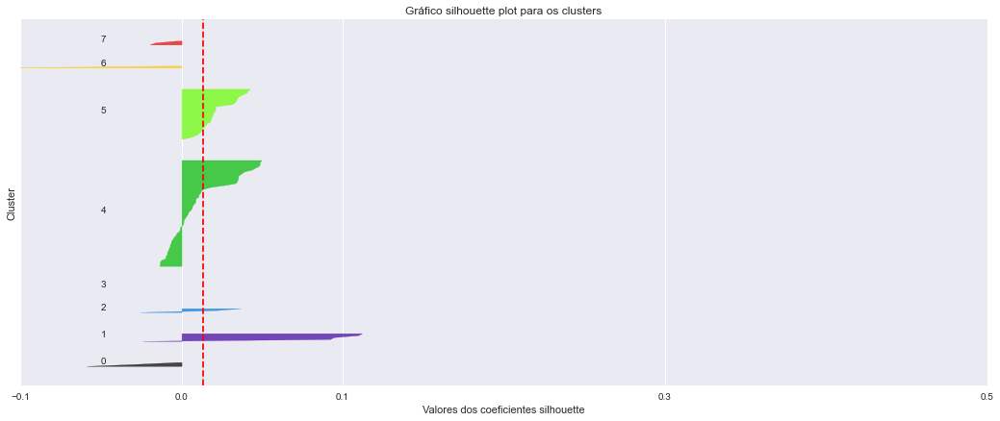

array([8, 3, 3, 3, 8, 3, 3, 8, 8, 8, 0, 8, 4, 8, 3, 3, 8, 4, 4, 3, 4, 1,
       8, 3, 4, 3, 4, 4, 3, 3, 7, 3, 8, 4, 3, 4, 0, 8, 2, 7, 3, 8, 4, 8,
       5, 8, 8, 8, 8, 4, 4, 8, 8, 5, 4, 3, 8, 8, 7, 8, 7, 4, 8, 7, 3, 4,
       0, 8, 8, 8, 8, 7, 7, 3, 1, 8, 4, 0, 7, 7, 8, 7, 8, 3, 8, 0, 3, 8,
       8, 3, 1, 3, 6, 6, 7, 8, 3, 3, 7, 7])

Número do cluster = 9 - Silhouette (médio) = 0.010677897470899927


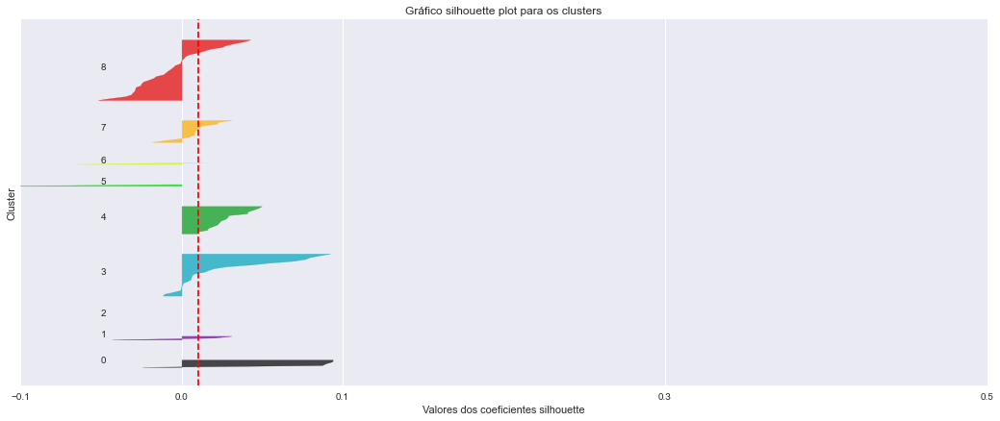

array([7, 7, 2, 2, 8, 2, 2, 7, 7, 7, 3, 7, 8, 7, 7, 2, 7, 3, 3, 8, 3, 0,
       2, 8, 3, 2, 8, 8, 2, 2, 6, 7, 7, 3, 2, 3, 8, 7, 1, 6, 2, 7, 3, 7,
       4, 7, 7, 7, 7, 8, 3, 7, 7, 4, 3, 2, 7, 7, 6, 7, 6, 3, 7, 6, 2, 3,
       7, 7, 7, 7, 7, 6, 6, 8, 0, 7, 8, 1, 6, 6, 7, 9, 7, 2, 7, 7, 2, 7,
       8, 8, 0, 8, 5, 5, 6, 7, 2, 2, 6, 6])

Número do cluster = 10 - Silhouette (médio) = 0.0062604382897345


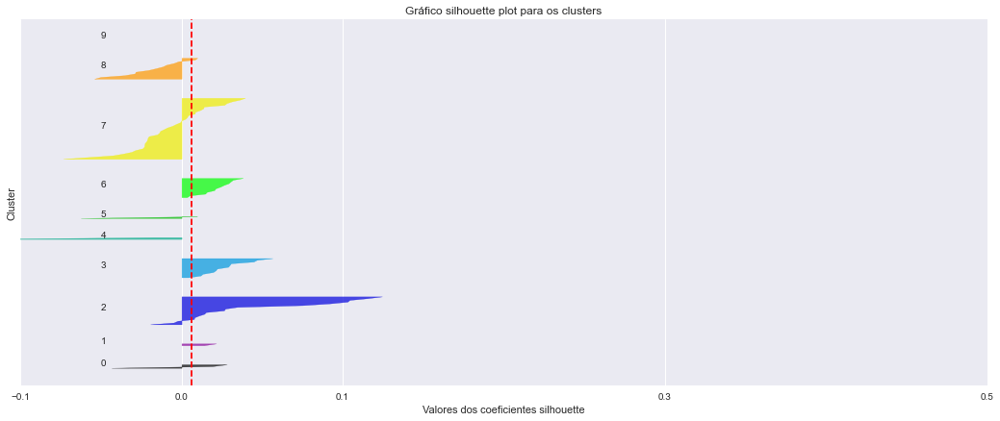

array([ 6,  6,  1,  1, 10,  1,  1,  6,  6,  6,  2,  6,  7,  6,  6,  1,  6,
        2,  2,  7,  2,  1, 10,  7,  2,  1,  7,  7,  1,  1,  5,  6,  6,  2,
        1,  2,  7,  6,  0,  5,  1,  6,  2,  6,  3,  6,  6,  6,  6,  7,  2,
        6,  6,  3,  2,  1,  6,  6,  5,  6,  5,  2,  6,  5,  1,  2,  6,  6,
        6,  6,  6,  5,  5,  7,  2,  6,  7,  0,  5,  5,  6,  8,  6,  1,  6,
        6,  1,  6,  7,  7,  9,  7,  4,  4,  5,  6,  1,  1,  5,  5])

Número do cluster = 11 - Silhouette (médio) = 0.016809905116646186


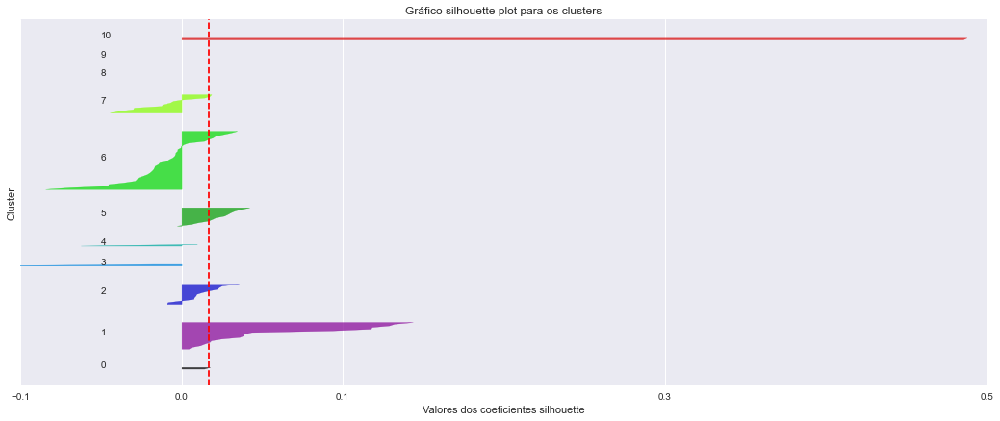

array([ 5, 11, 11, 11,  9, 11, 11,  5,  5,  5, 10,  5,  6,  5, 11,  0,  5,
        1, 11, 11,  1, 11,  9,  6, 11, 11,  6, 11, 11, 11,  4, 11,  5,  1,
       11, 11, 10,  5,  0,  4, 11, 11,  1,  5,  2, 11, 11,  5, 11,  6,  1,
       11,  5,  2, 11, 11,  5,  5,  4, 11,  4,  1,  5, 11, 11,  1, 10,  5,
        5,  5,  5,  0, 11,  6,  1,  5,  6,  6,  4,  4,  5,  7,  0, 11,  5,
       10, 11,  5,  6,  6,  8,  6,  3,  3, 11,  5, 11,  0,  4,  4])

Número do cluster = 12 - Silhouette (médio) = 0.027059270259404026


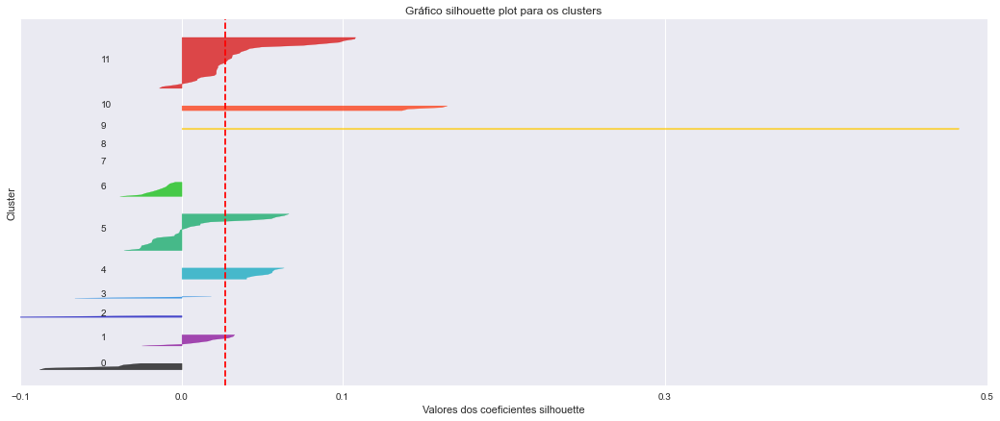

array([ 0,  0,  0,  0,  5,  0,  0,  8,  9,  0,  6,  8, 10,  3,  0,  0,  8,
        0,  0,  0,  0,  0,  5,  0,  6,  0,  0,  0, 11,  5, 11,  0,  3, 10,
        0,  0,  6,  3,  5, 11,  0,  0,  0,  9,  0,  0,  3,  0, 12,  0, 10,
        1,  3,  8,  3,  6,  3,  0, 11,  0, 11,  0,  7,  0, 11,  0, 11,  3,
        6,  3,  0, 11, 11,  6,  0,  0,  0,  0, 11, 11,  6, 11,  9,  0,  8,
        6,  0,  0,  6,  0,  2,  0, 12, 12,  0,  0,  0,  4, 11,  7])

Número do cluster = 13 - Silhouette (médio) = 0.019756891985409496


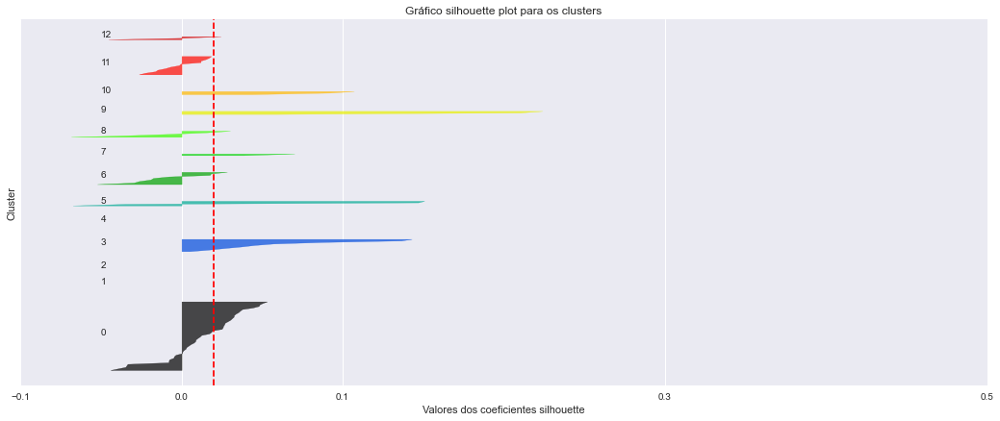

array([12, 12, 12, 12,  3, 12, 12,  6,  7,  7, 12,  6,  8,  1, 12, 12,  6,
       12, 12, 12, 12, 12,  3,  4,  4, 12, 12,  4,  9,  3,  9, 12,  1,  8,
       12, 12, 12, 11,  3,  9, 12, 12, 12,  7, 12,  1,  1,  9, 10, 12,  8,
        1,  1,  6,  1,  4,  1, 12,  9, 12,  9, 12,  5,  9,  9, 12,  9,  1,
       12,  1, 12,  9,  9,  4, 12, 10, 12,  2,  9,  9,  4,  9,  7, 12,  6,
        4, 12,  1,  4, 12,  0,  9, 10, 10, 13, 12, 12,  2,  9,  5])

Número do cluster = 14 - Silhouette (médio) = 0.01338952358616414


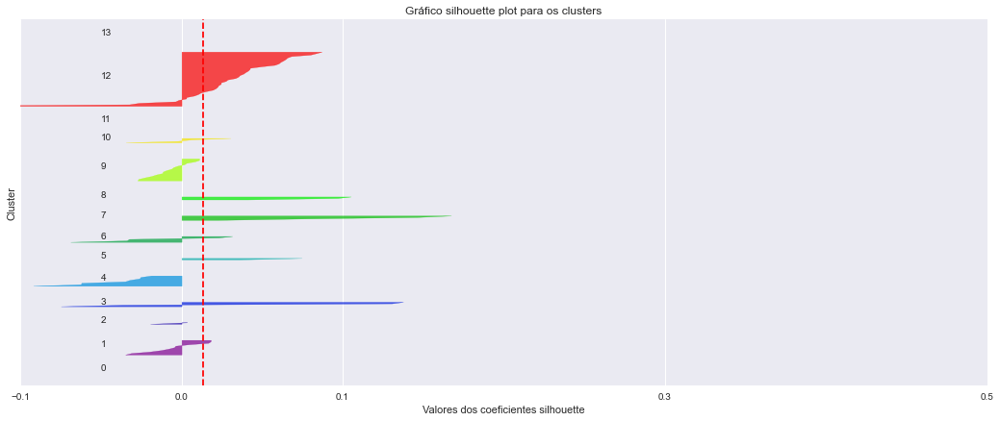

In [96]:
# Calcula os índices silhouette médio para vários valores de clusters 2-10
lst_silhouette_avg = []

for i in range(2,15):
    # Faz o agrupamentos de clusters utilizando o kshape (timeseries)
    # 
    ks = KShape(n_clusters = i, n_init=2, random_state=3)
    labels = ks.fit_predict(df_data.T)
    display(labels)
    
    silhouette_avg = silhouette_score(df_data.T, labels)
    print('Número do cluster = {} - Silhouette (médio) = {}'.format(i, silhouette_avg))
    lst_silhouette_avg.append(silhouette_avg)
        
    grafico_silhouette(i, labels, df_data.T)


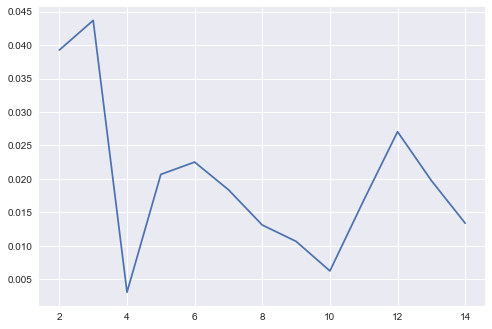

In [97]:
# Gráfico Silhouette
x = np.array(range(2,15))
y = np.array(lst_silhouette_avg)
plt.plot(x,y)
    

## KShape usando o número de cluster que tem o mmaior silhouette

In [98]:
# Usando o ncluster de com maior silhouette médio:
idx = lst_silhouette_avg.index(max(lst_silhouette_avg))
nclusters = range(2,15)[idx]
print('Número de clusters selecionado - {}'.format(nclusters))

Número de clusters selecionado - 3


In [99]:
# 
ks = KShape(n_clusters = nclusters, n_init=5, random_state = 3)
labels = ks.fit_predict(df_data.T)
display(labels)


array([2, 0, 0, 0, 1, 0, 0, 0, 0, 2, 2, 0, 0, 2, 0, 0, 0, 2, 2, 0, 0, 1,
       1, 2, 2, 0, 0, 0, 2, 0, 2, 0, 2, 2, 0, 2, 2, 2, 0, 2, 0, 2, 0, 0,
       0, 0, 2, 2, 2, 2, 1, 0, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 0,
       1, 2, 2, 2, 1, 1, 2, 2, 1, 2, 2, 1, 2, 2, 2, 2, 1, 0, 2, 2, 0, 2,
       2, 2, 1, 0, 1, 2, 2, 0, 0, 1, 2, 2])

In [100]:
df_clusters = dataframe_clusters(labels, df_data)
df_clusters.sort_values(['Cluster', 'SETOR ECONÔMICO'], inplace=True)
display(df_clusters)

,Cluster,Codigo Listagem B3,SETOR ECONÔMICO,SUBSETOR,SEGMENTO,Nome,Codigo Listagem,Mercado
38,0,EMBR3,Bens Industriais,Material de Transporte,Material Aeronáutico e de Defesa,EMBRAER,EMBR,NM
40,0,WEGE3,Bens Industriais,Máquinas e Equipamentos,"Motores, Compressores e Outros",WEG,WEGE,NM
91,0,VLID3,Bens Industriais,Serviços Diversos,Serviços Diversos,VALID,VLID,NM
29,0,TIMS3,Comunicações,Telecomunicações,Telecomunicações,TIM,TIMS,NM
26,0,LAME4,Consumo Cíclico,Comércio,Produtos Diversos,LOJAS AMERIC,LAME,N1
...,...,...,...,...,...,...,...,...
52,2,CSMG3,Utilidade Pública,Água e Saneamento,Água e Saneamento,COPASA,CSMG,NM
53,2,ENEV3,Utilidade Pública,Energia Elétrica,Energia Elétrica,ENEVA,ENEV,NM
56,2,LIGT3,Utilidade Pública,Energia Elétrica,Energia Elétrica,LIGHT S/A,LIGT,NM
67,2,CPLE3,Utilidade Pública,Energia Elétrica,Energia Elétrica,COPEL,CPLE,N1


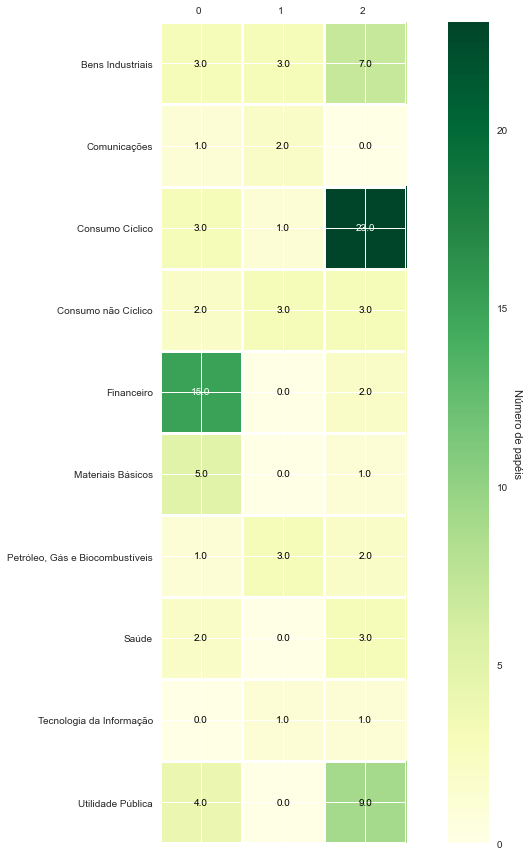

In [101]:
grafico_heatmap(nclusters, labels, 'Heatmap', 'SETOR ECONÔMICO', df_data)

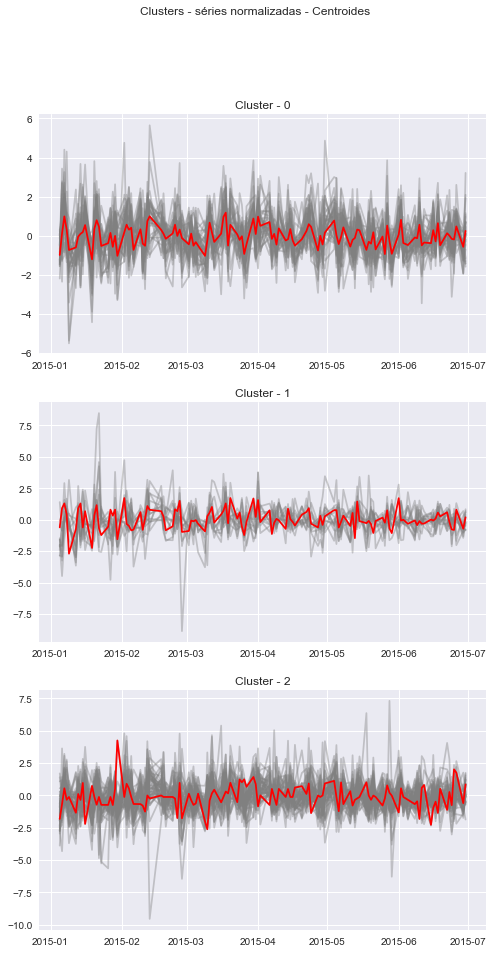

In [102]:
grafico_clusters_centroide(nclusters, labels, 'Clusters - séries normalizadas - Centroides', df_data, km.cluster_centers_, '2015-06-30')

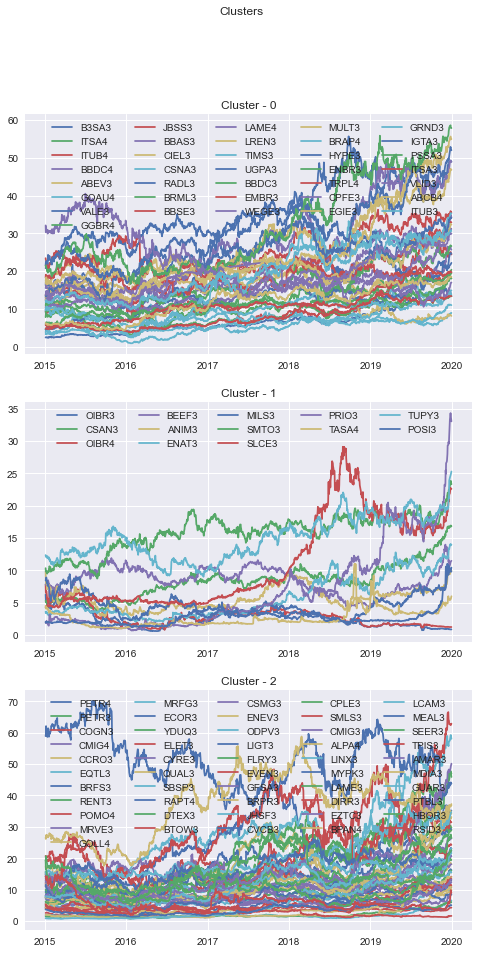

In [103]:
# Gera o gráfico dos clusters (séries históricas de precços)
grafico_clusters(nclusters, labels, 'Clusters', df_data_precos)

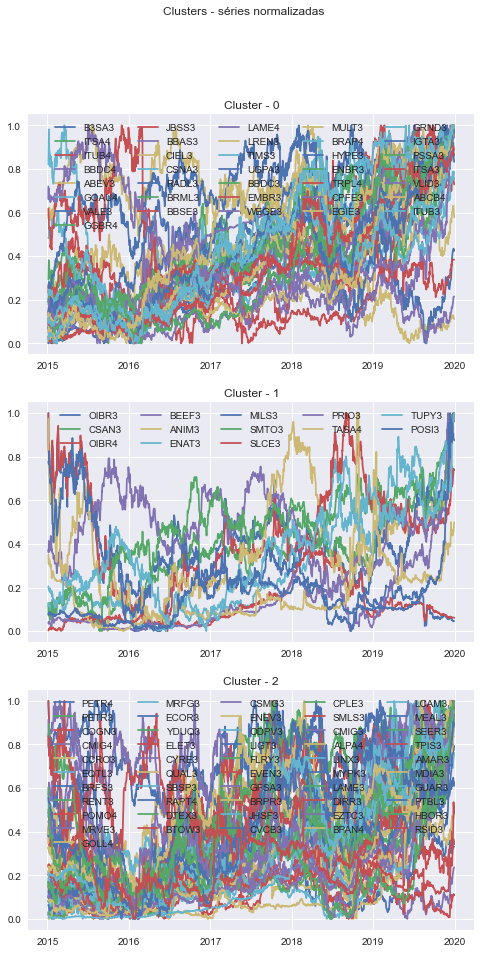

In [104]:
# Gera o gráfico dos clusters (séries históricas de precços, normalizadas)
grafico_clusters(nclusters, labels, 'Clusters - séries normalizadas', df_data_precos_norm)

In [105]:
silhouette_avg = silhouette_score(df_data.T, labels)
print('Silhouette (médio) = {}'.format(silhouette_avg))


Silhouette (médio) = 0.008567867705570713


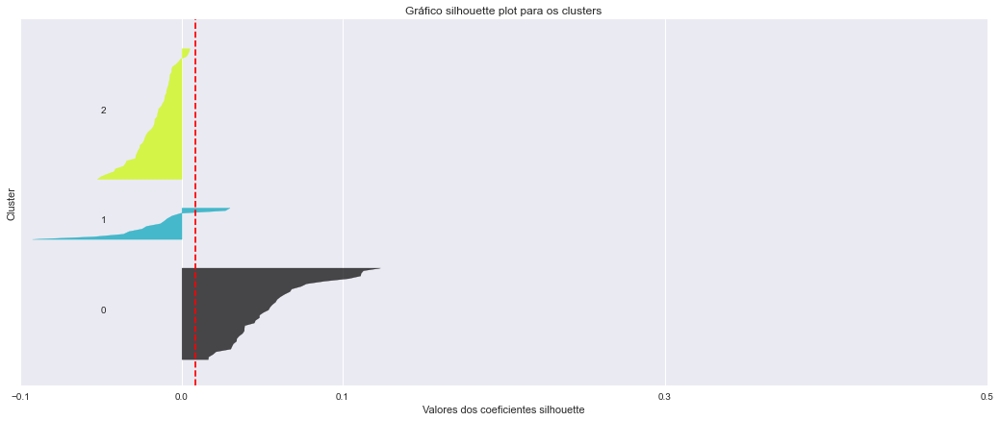

In [106]:
grafico_silhouette(nclusters, labels, df_data.T)

## Estudo preliminar: séries mais correlacionada -> setor financeiro

In [107]:
# Salva os dataframe de dados (serão manipulados)
df_tdata = df_data
df_tdataprecos = df_data_precos
df_tdataprecosnorm = df_data_precos_norm

In [108]:
# Função para recuperar todos os códigos de listagem b3 de um setor econômico especídico
def codigo_listagem_b3_setor_economico(lst, stsetor):
    # Cria um dataframe com os 'códigos de listagem b3' da lista passada como parametro
    df_selecionados = pd.DataFrame(lst)
    df_selecionados.columns = ['Codigo Listagem']
    
    df_selecionados['Codigo Listagem B3'] = lst
        
    # Faz o merge com o dataframe accoes.df_accoes_setor_economico (para contar os setores economicos)
    df_selecionados = pd.merge(df_selecionados, df_accoes_setor_economico, on='Codigo Listagem B3', how='inner')
    
    # Pega a lista de codigos de listagem b3 do setor economico passado como parametro    
    lstcodigo_listagem_b3 = df_selecionados[df_selecionados['SETOR ECONÔMICO'] == stsetor] \
                                    ['Codigo Listagem B3'].to_numpy()
    
    return lstcodigo_listagem_b3

In [109]:
# Pega os codigos de listagem b3 do setor econômico 'Financeiro'

lstfinanceiro = codigo_listagem_b3_setor_economico(lstmaior_volume, 'Financeiro')
display(lstfinanceiro)

array(['B3SA3', 'ITSA4', 'ITUB4', 'BBDC4', 'BBAS3', 'CIEL3', 'BRML3',
       'BBSE3', 'BBDC3', 'MULT3', 'BRPR3', 'IGTA3', 'BPAN4', 'PSSA3',
       'ITSA3', 'ABCB4', 'ITUB3'], dtype=object)

In [110]:
df_data = df_data[lstfinanceiro]
df_data_precos = df_data_precos[lstfinanceiro]
df_data_precos_norm = df_data_precos_norm[lstfinanceiro]
display(df_data)

,B3SA3,ITSA4,ITUB4,BBDC4,BBAS3,CIEL3,BRML3,BBSE3,BBDC3,MULT3,BRPR3,IGTA3,BPAN4,PSSA3,ITSA3,ABCB4,ITUB3
2015-01-05,-1.384962,0.122726,0.217305,0.049362,-0.800045,-1.449963,-0.520561,-1.562260,-0.663424,-0.123387,0.548247,-0.953012,-1.930439,-0.146796,-0.884556,-0.442174,-0.718444
2015-01-06,0.390799,0.359173,0.812109,1.526219,0.460411,-0.849859,0.392249,2.133279,1.291778,2.681922,0.685364,1.910032,-0.197571,-0.680777,1.017266,-1.230929,0.523196
2015-01-07,1.822378,2.002224,1.879577,1.853450,1.550908,0.416607,1.752678,-0.847191,2.168731,1.842671,-0.082267,0.088784,-0.198237,0.031987,1.326925,-1.018524,1.279676
2015-01-08,-0.716605,0.511013,0.783887,0.199633,0.076782,1.208081,0.372686,-0.184734,0.065509,-0.631932,1.149105,0.884114,0.808966,-0.377040,0.269725,-0.011440,0.784462
2015-01-09,-1.325383,-1.962088,-2.384518,-2.122584,-1.618317,0.921733,-0.093991,-1.693049,-1.801618,0.308991,-0.543485,-0.293895,0.225193,-0.823679,-0.106452,-0.790993,-0.768965
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-12-20,0.457410,-0.562392,-0.283846,-0.387956,-0.117825,-0.338078,-0.165709,-0.778583,-0.752511,0.557476,-1.330846,0.751307,-0.119656,0.448363,-0.090411,0.267454,-0.537364
2019-12-23,-2.250937,0.337948,0.446109,0.248093,1.047861,0.320674,0.509779,0.251152,0.962900,0.225205,1.226539,0.923496,0.528888,0.268376,0.171678,0.240919,0.716450
2019-12-26,-0.300140,0.882107,0.760163,0.552520,0.367161,0.874489,0.272227,-0.288115,0.485708,1.826915,-0.034954,1.341808,2.173222,0.147756,0.245285,0.069033,0.836236
2019-12-27,-2.580843,-0.286020,-0.193627,-0.230718,-0.203808,-0.777555,-0.801856,0.075378,-0.366511,-0.428284,0.101647,-0.617225,0.805915,-0.632790,-0.164218,-0.270732,-0.272330


In [111]:
display(df_data.corr())

,B3SA3,ITSA4,ITUB4,BBDC4,BBAS3,CIEL3,BRML3,BBSE3,BBDC3,MULT3,BRPR3,IGTA3,BPAN4,PSSA3,ITSA3,ABCB4,ITUB3
B3SA3,1.000000,0.626125,0.619822,0.619885,0.589218,0.345769,0.550549,0.530813,0.632211,0.527962,0.291522,0.502279,0.176777,0.308186,0.536064,0.385120,0.576212
ITSA4,0.626125,1.000000,0.917797,0.813265,0.741865,0.328666,0.567540,0.594331,0.808790,0.563856,0.310664,0.528073,0.205986,0.375092,0.783952,0.488766,0.827213
ITUB4,0.619822,0.917797,1.000000,0.863096,0.753741,0.327690,0.560056,0.607466,0.828088,0.555068,0.309113,0.510794,0.214178,0.373055,0.752744,0.504737,0.885133
BBDC4,0.619885,0.813265,0.863096,1.000000,0.751982,0.332814,0.562985,0.576576,0.905386,0.544313,0.291990,0.506787,0.194917,0.374580,0.680915,0.513349,0.793868
BBAS3,0.589218,0.741865,0.753741,0.751982,1.000000,0.328551,0.554608,0.595340,0.733166,0.524026,0.285109,0.484119,0.215203,0.361156,0.637132,0.513394,0.700086
CIEL3,0.345769,0.328666,0.327690,0.332814,0.328551,1.000000,0.284407,0.325710,0.341185,0.302216,0.190910,0.278535,0.103788,0.195563,0.317663,0.210280,0.332472
BRML3,0.550549,0.567540,0.560056,0.562985,0.554608,0.284407,1.000000,0.508075,0.576351,0.667660,0.363350,0.646484,0.148330,0.291281,0.490338,0.406188,0.508493
BBSE3,0.530813,0.594331,0.607466,0.576576,0.595340,0.325710,0.508075,1.000000,0.577128,0.492337,0.285822,0.442239,0.128077,0.407795,0.496897,0.348051,0.567276
BBDC3,0.632211,0.808790,0.828088,0.905386,0.733166,0.341185,0.576351,0.577128,1.000000,0.561428,0.307968,0.522967,0.191706,0.394058,0.673106,0.473813,0.771574
MULT3,0.527962,0.563856,0.555068,0.544313,0.524026,0.302216,0.667660,0.492337,0.561428,1.000000,0.362657,0.730880,0.140380,0.289936,0.487039,0.389079,0.508678


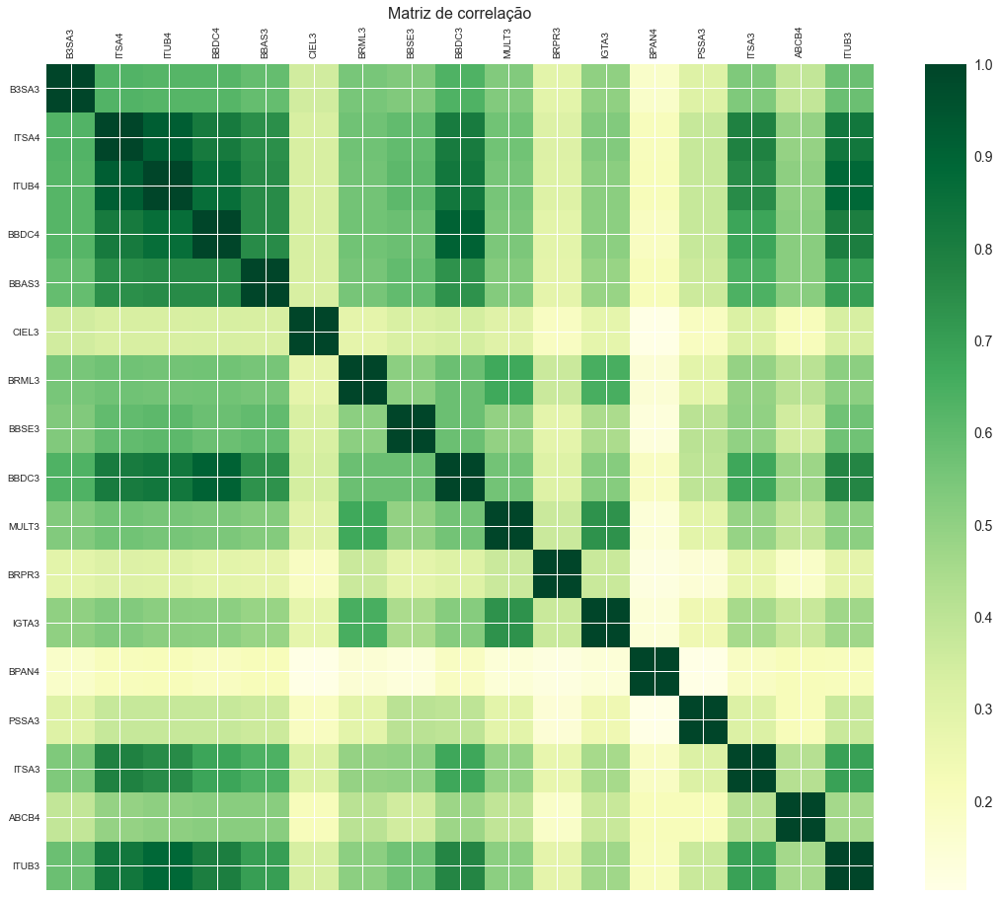

In [112]:
# Código adaptado de https://stackoverflow.com/questions/29432629/plot-correlation-matrix-using-pandas
f =  plt.figure(figsize=(19, 15))
plt.matshow(df_data.corr(), fignum=f.number, cmap="YlGn")
plt.xticks(range(df_data.select_dtypes(['number']).shape[1]), df_data.select_dtypes(['number']).columns, fontsize=10,
           rotation=90)
plt.yticks(range(df_data.select_dtypes(['number']).shape[1]), df_data.select_dtypes(['number']).columns, fontsize=10)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=14)
plt.title('Matriz de correlação', fontsize=16);

array([0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0])

Número do cluster = 2 - Silhouette (médio) = 0.11813142487544728


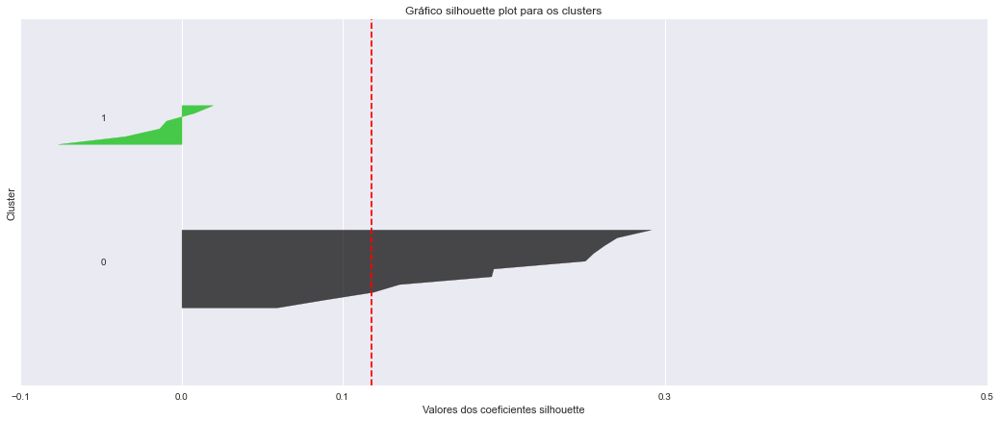

array([2, 0, 0, 0, 0, 2, 2, 2, 0, 2, 2, 2, 1, 2, 0, 2, 0])

Número do cluster = 3 - Silhouette (médio) = 0.1060011584785231


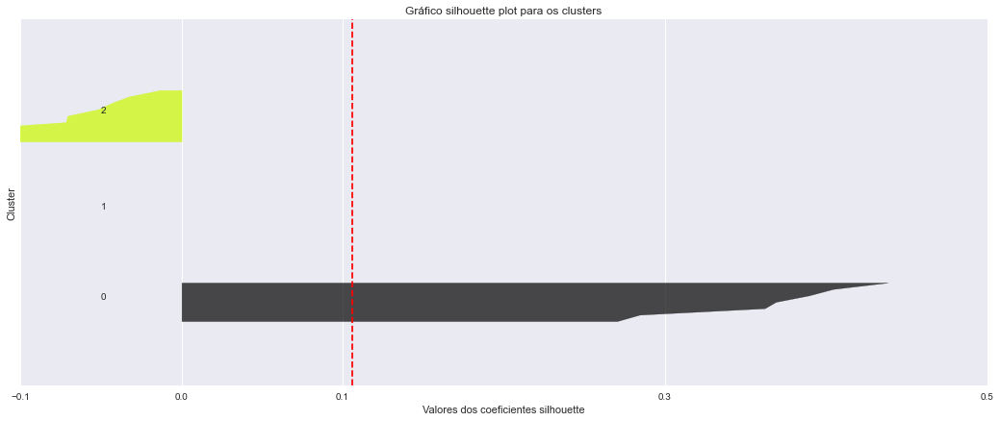

array([1, 1, 1, 1, 1, 3, 0, 1, 1, 0, 0, 0, 2, 1, 1, 1, 1])

Número do cluster = 4 - Silhouette (médio) = 0.1354141383488255


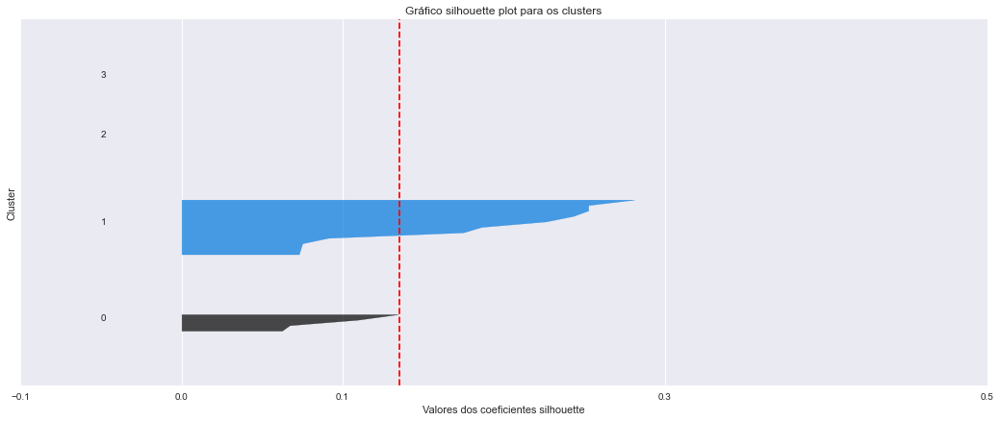

array([0, 0, 0, 0, 0, 2, 4, 0, 0, 4, 4, 4, 1, 3, 0, 0, 0])

Número do cluster = 5 - Silhouette (médio) = 0.14583190034894458


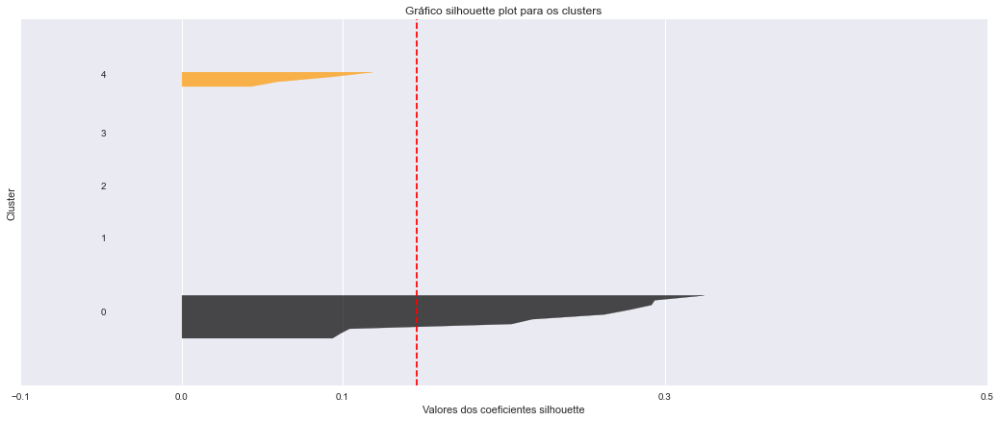

array([0, 0, 0, 0, 0, 4, 1, 0, 0, 1, 3, 1, 2, 5, 0, 0, 0])

Número do cluster = 6 - Silhouette (médio) = 0.1379769290973826


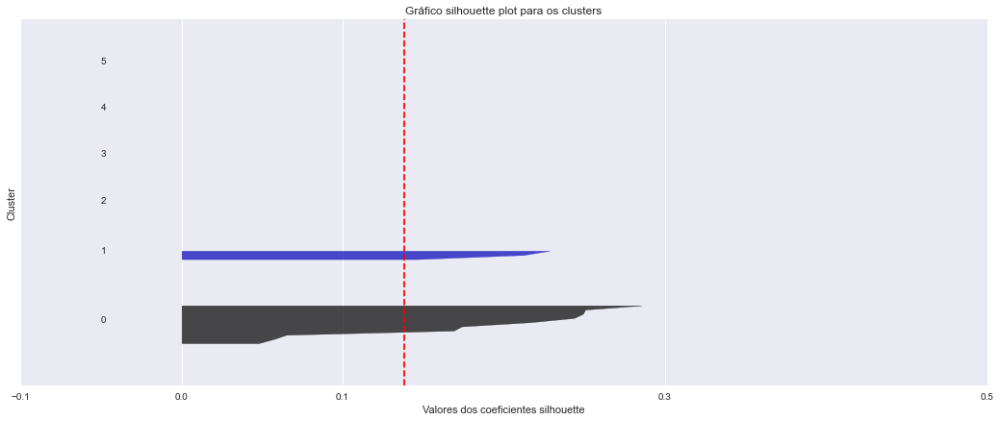

array([0, 0, 0, 0, 0, 3, 5, 0, 0, 5, 2, 5, 1, 6, 0, 4, 0])

Número do cluster = 7 - Silhouette (médio) = 0.1495565293996043


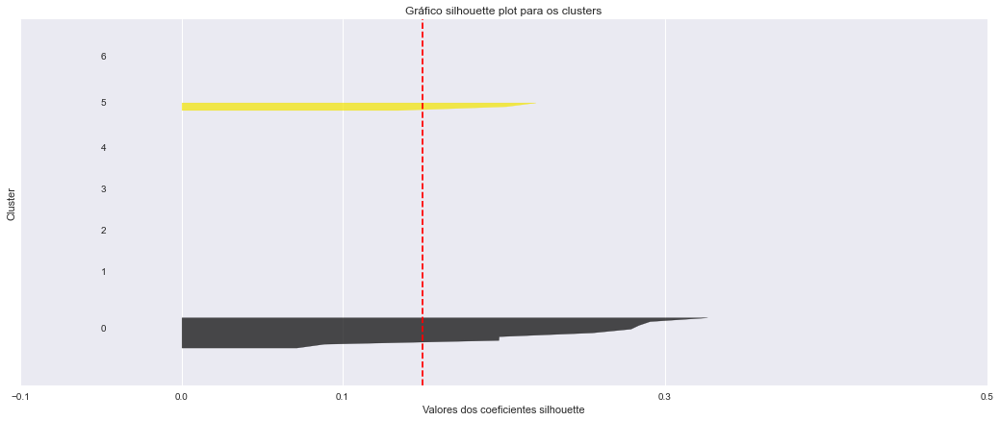

array([1, 1, 1, 1, 1, 2, 4, 5, 1, 4, 0, 4, 3, 6, 1, 7, 1])

Número do cluster = 8 - Silhouette (médio) = 0.14015125484508437


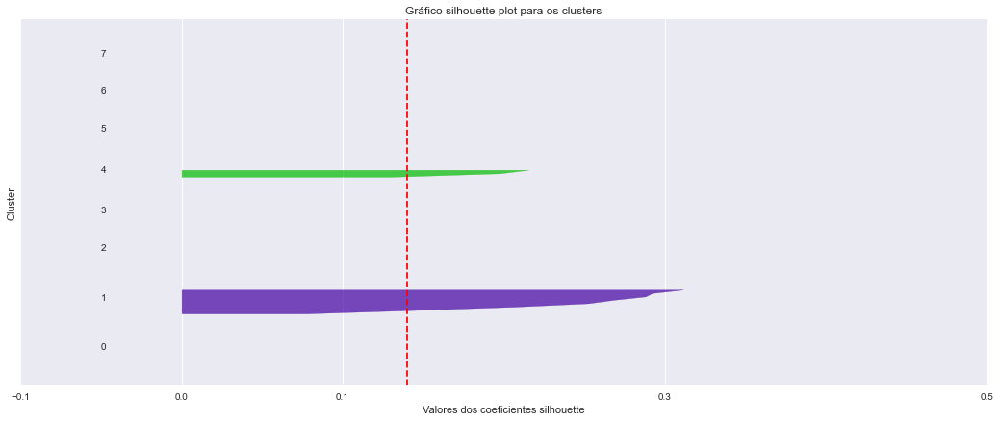

array([8, 1, 1, 1, 1, 2, 4, 5, 1, 4, 0, 4, 3, 6, 1, 7, 1])

Número do cluster = 9 - Silhouette (médio) = 0.14053463812486833


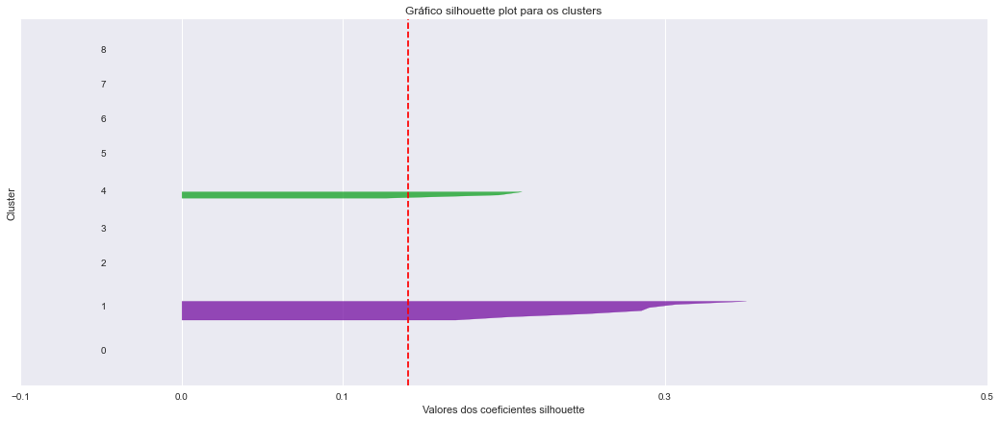

array([9, 1, 1, 1, 1, 3, 2, 8, 1, 2, 4, 2, 5, 6, 0, 7, 1])

Número do cluster = 10 - Silhouette (médio) = 0.10139681989336506


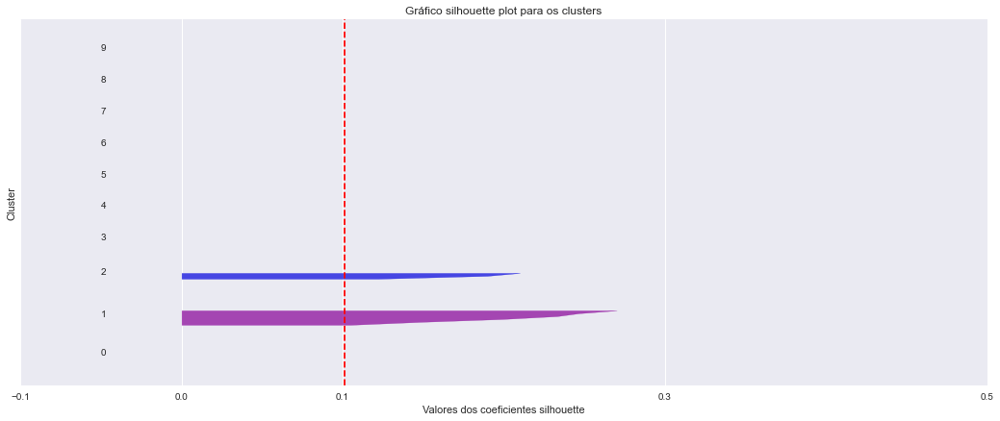

array([ 8,  0,  0,  0,  0,  7,  9,  3,  0,  2,  5,  2,  1,  4, 10,  6,  0])

Número do cluster = 11 - Silhouette (médio) = 0.08409383383000502


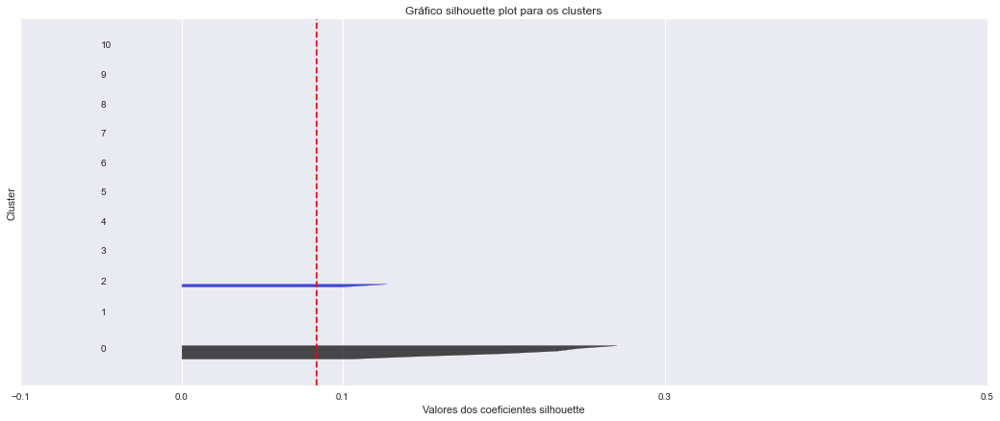

array([10,  1,  1,  1,  7,  8, 11,  0,  1,  5,  3,  5,  4,  6,  9,  2,  1])

Número do cluster = 12 - Silhouette (médio) = 0.07790530390954131


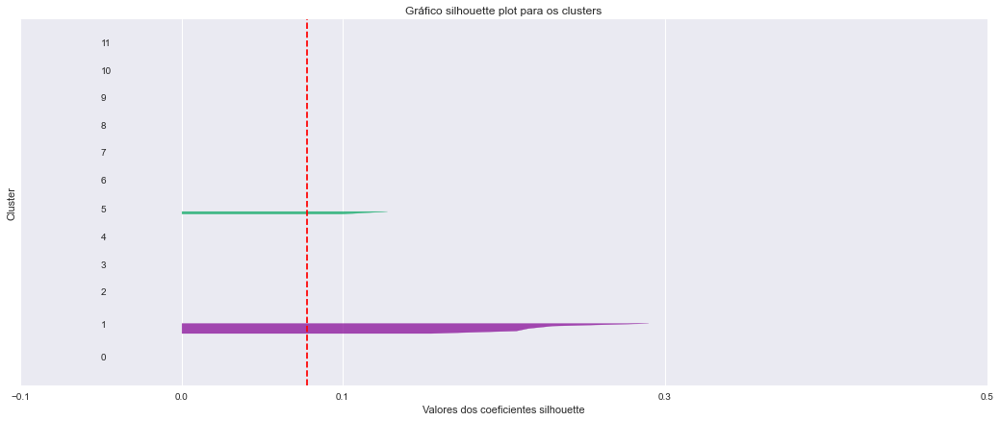

array([ 9,  7,  7,  1, 12,  4, 10,  6,  1,  0,  8,  0,  3,  2, 11,  5,  7])

Número do cluster = 13 - Silhouette (médio) = 0.0814212013464151


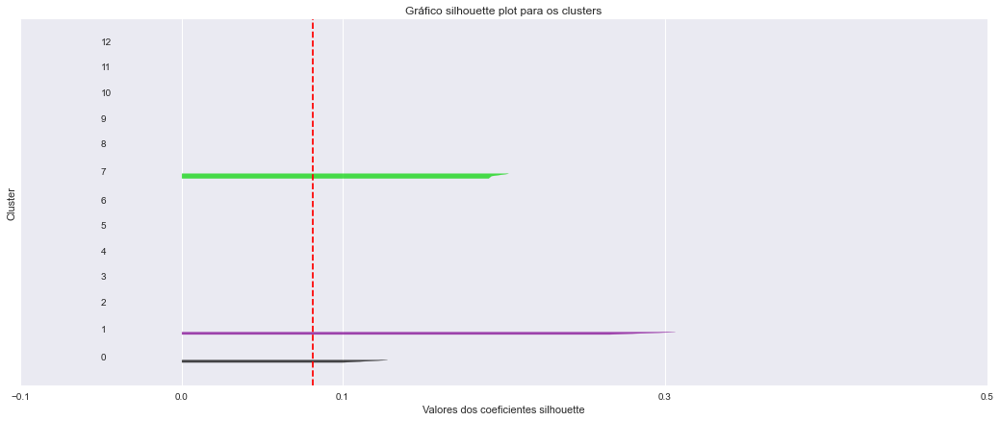

array([ 8,  1,  1, 12, 13,  2,  9,  5, 12,  4,  0, 10,  3,  6, 11,  7,  1])

Número do cluster = 14 - Silhouette (médio) = 0.06803178047999875


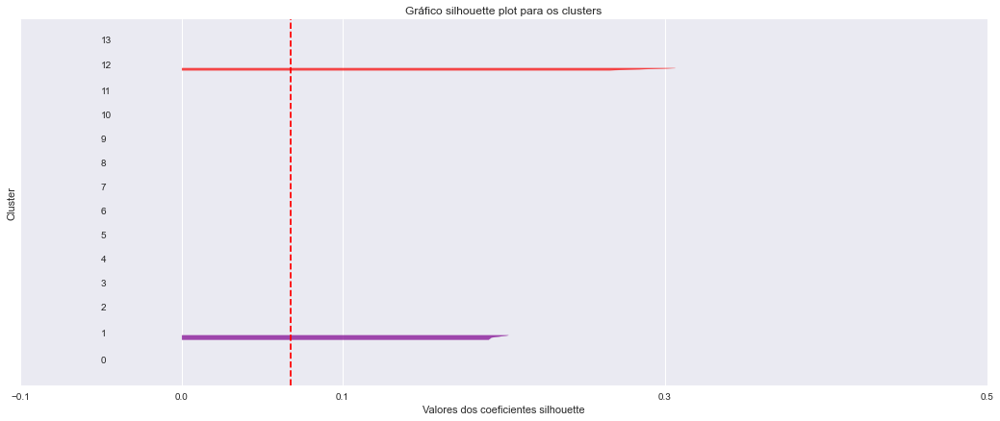

In [113]:
# Calcula os índices silhouette médio para vários valores de clusters 2-14
lst_silhouette_avg = []
for i in range(2,15):
    # Faz o agrupamentos de clusters utilizando o kmeans (timeseries)
    # 
    km = TimeSeriesKMeans(n_clusters = i, metric='euclidean', n_init=300, random_state=3)
    labels = km.fit_predict(df_data.T)
    display(labels)
    
    silhouette_avg = silhouette_score(df_data.T, labels)
    print('Número do cluster = {} - Silhouette (médio) = {}'.format(i, silhouette_avg))
    lst_silhouette_avg.append(silhouette_avg)    
            
    grafico_silhouette(i, labels, df_data.T)

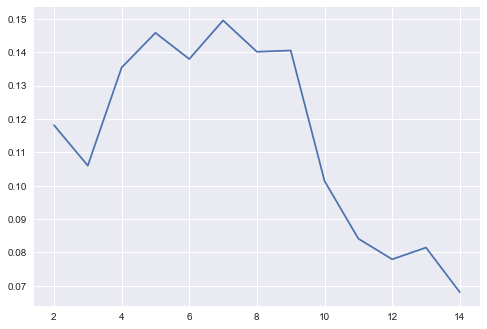

In [114]:
# Gráfico Silhouette
x = np.array(range(2,15))
y = np.array(lst_silhouette_avg)
plt.plot(x,y)
    

In [115]:
# Usando o ncluster de com maior silhouette médio:
idx = lst_silhouette_avg.index(max(lst_silhouette_avg))
nclusters = range(2,15)[idx]
print('Número de clusters selecionado - {}'.format(nclusters))

Número de clusters selecionado - 7


In [116]:
# Faz o agrupamentos de clusters utilizando o kmeans (timeseries)
# 
km = TimeSeriesKMeans(n_clusters = nclusters, metric='euclidean', n_init=300, random_state=3)
labels = km.fit_predict(df_data.T)
display(labels)


array([0, 0, 0, 0, 0, 3, 5, 0, 0, 5, 2, 5, 1, 6, 0, 4, 0])

In [117]:
df_clusters = dataframe_clusters(labels, df_data)
df_clusters.sort_values(['Cluster', 'SETOR ECONÔMICO'], inplace=True)
display(df_clusters)

,Cluster,Codigo Listagem B3,SETOR ECONÔMICO,SUBSETOR,SEGMENTO,Nome,Codigo Listagem,Mercado
0,0,B3SA3,Financeiro,Serviços Financeiros Diversos,Serviços Financeiros Diversos,B3,B3SA,NM
1,0,ITSA4,Financeiro,Intermediários Financeiros,Bancos,ITAUSA,ITSA,N1
2,0,ITUB4,Financeiro,Intermediários Financeiros,Bancos,ITAUUNIBANCO,ITUB,N1
3,0,BBDC4,Financeiro,Intermediários Financeiros,Bancos,BRADESCO,BBDC,N1
4,0,BBAS3,Financeiro,Intermediários Financeiros,Bancos,BRASIL,BBAS,NM
7,0,BBSE3,Financeiro,Previdência e Seguros,Seguradoras,BBSEGURIDADE,BBSE,NM
8,0,BBDC3,Financeiro,Intermediários Financeiros,Bancos,BRADESCO,BBDC,N1
14,0,ITSA3,Financeiro,Intermediários Financeiros,Bancos,ITAUSA,ITSA,N1
16,0,ITUB3,Financeiro,Intermediários Financeiros,Bancos,ITAUUNIBANCO,ITUB,N1
12,1,BPAN4,Financeiro,Intermediários Financeiros,Bancos,BANCO PAN,BPAN,N1


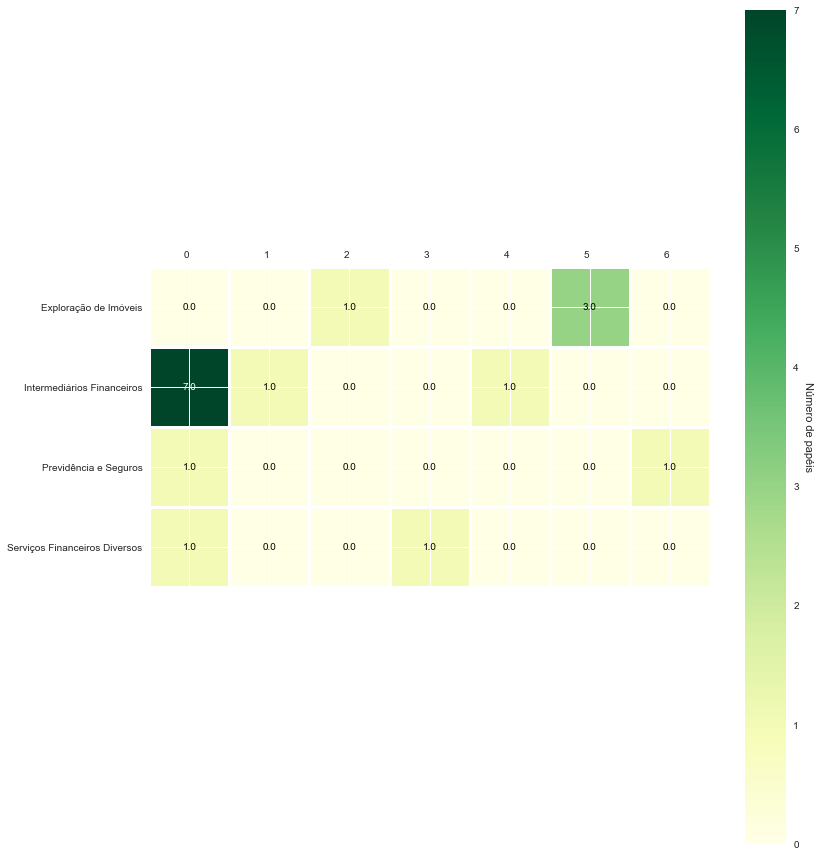

In [118]:
grafico_heatmap(nclusters, labels, 'Heatmap', 'SUBSETOR', df_data)

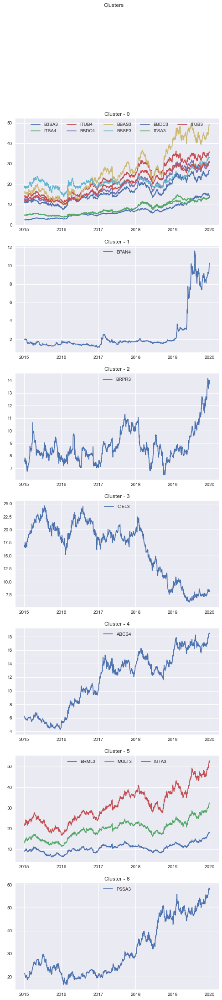

In [119]:
# Gera o gráfico dos clusters (séries históricas de precços)
grafico_clusters(nclusters, labels, 'Clusters', df_data_precos)

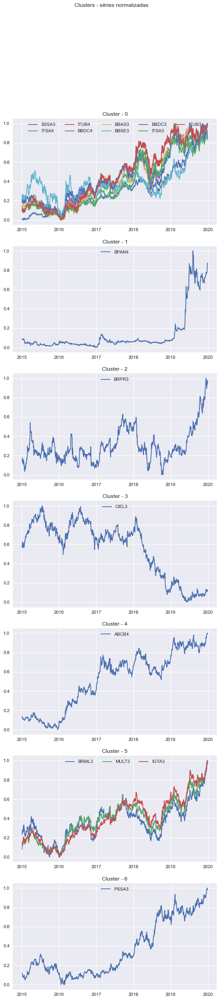

In [120]:
# Gera o gráfico dos clusters (séries históricas de precços, normalizadas)
grafico_clusters(nclusters, labels, 'Clusters - séries normalizadas', df_data_precos_norm)

In [121]:
silhouette_avg = silhouette_score(df_data.T, labels)
print('Silhouette (médio) = {}'.format(silhouette_avg))


Silhouette (médio) = 0.1495565293996043


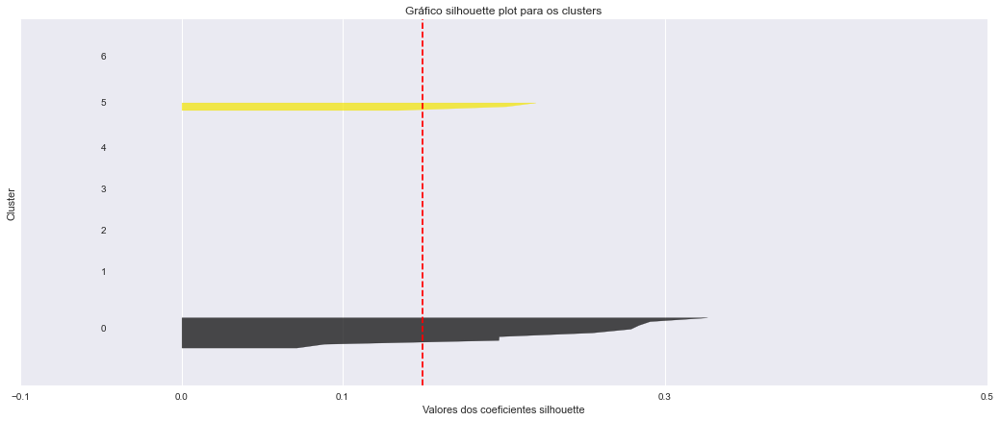

In [122]:
grafico_silhouette(nclusters, labels, df_data.T)

array([1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1])

Número do cluster = 2 - Silhouette (médio) = 0.10020598897967951


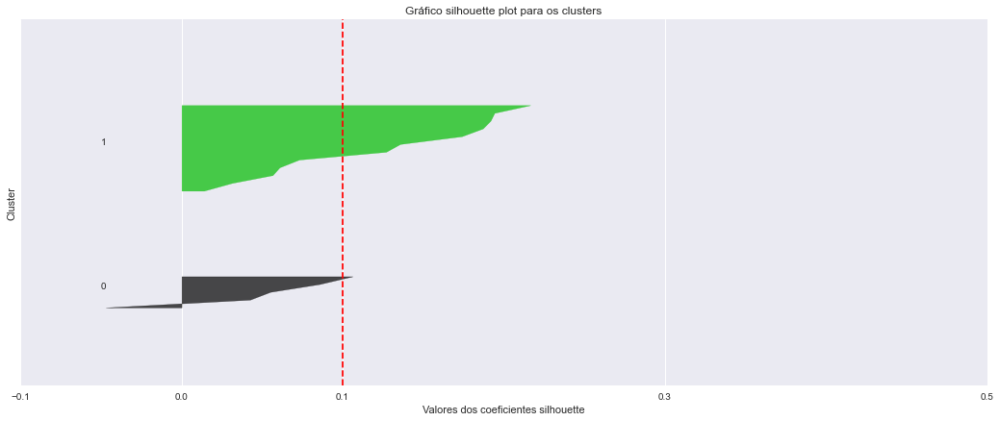

array([0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 1, 2, 0, 0, 0])

Número do cluster = 3 - Silhouette (médio) = 0.04683687202753618


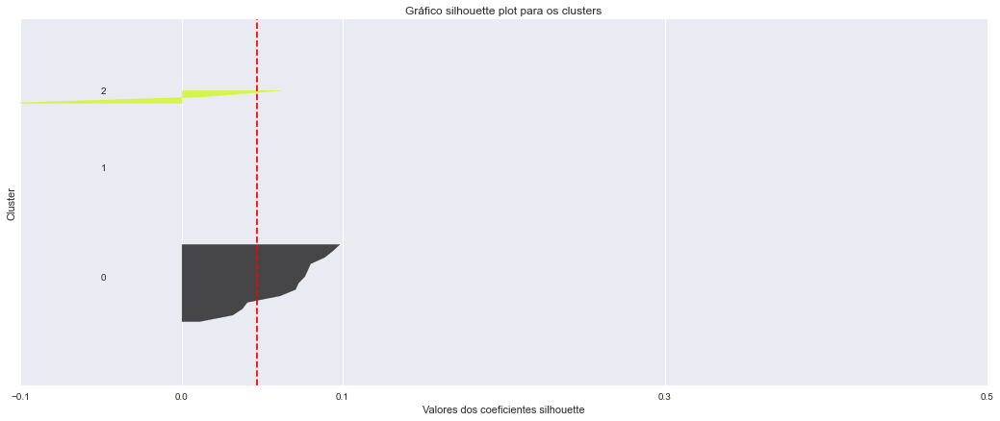

array([1, 1, 1, 1, 3, 1, 0, 3, 1, 0, 0, 0, 2, 3, 1, 0, 1])

Número do cluster = 4 - Silhouette (médio) = 0.07530646001963233


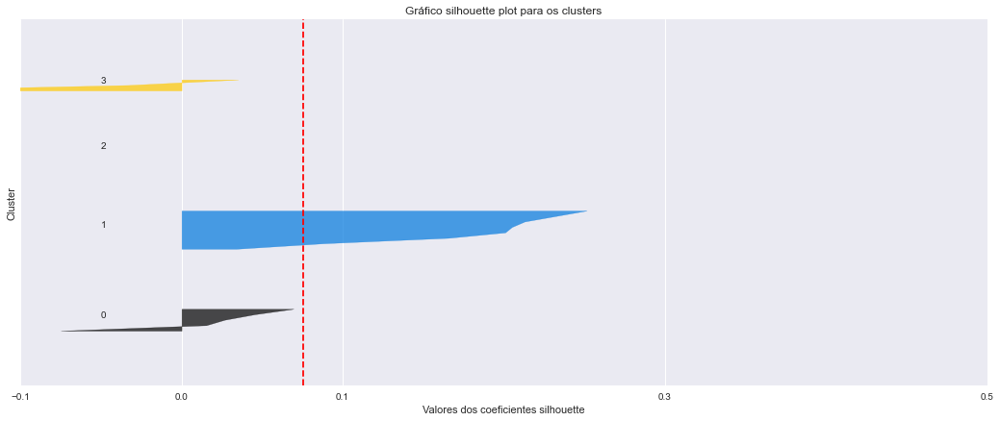

array([3, 3, 3, 3, 3, 3, 2, 1, 3, 2, 0, 2, 4, 1, 3, 4, 3])

Número do cluster = 5 - Silhouette (médio) = 0.12246965671761705


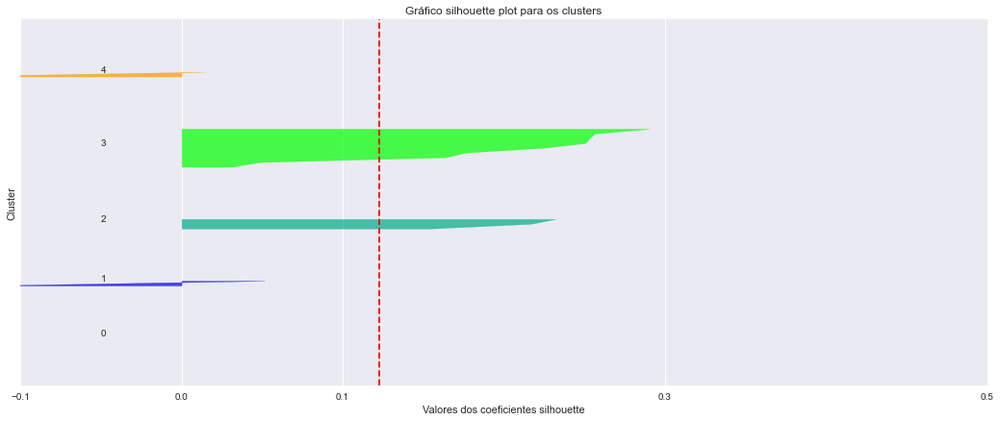

array([3, 3, 3, 3, 5, 3, 2, 5, 3, 0, 1, 0, 4, 5, 3, 2, 3])

Número do cluster = 6 - Silhouette (médio) = 0.08165108781989429


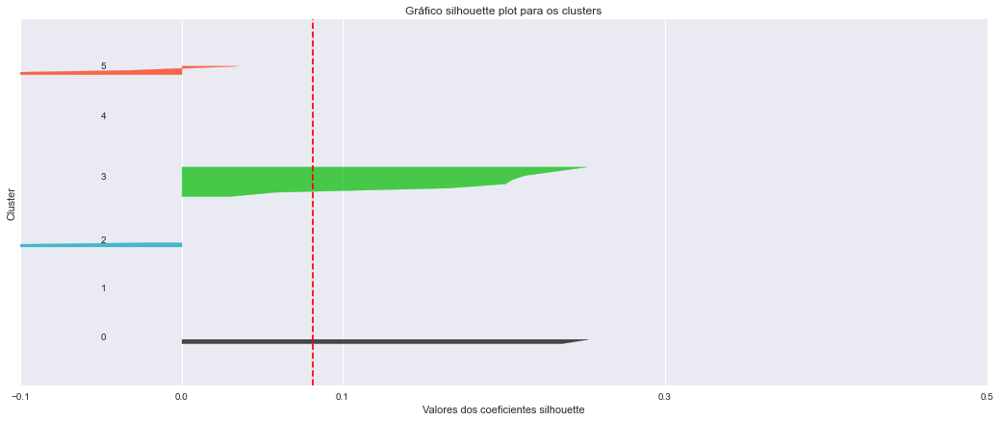

array([2, 6, 6, 6, 6, 2, 1, 4, 6, 1, 0, 1, 3, 4, 5, 6, 6])

Número do cluster = 7 - Silhouette (médio) = 0.06165993040292683


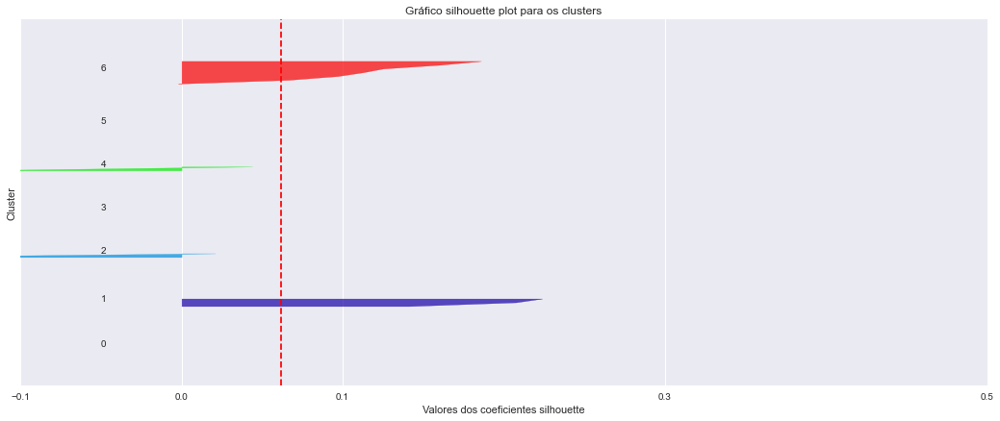

array([5, 5, 3, 6, 3, 6, 5, 4, 6, 5, 5, 5, 0, 7, 5, 6, 2])

Número do cluster = 8 - Silhouette (médio) = -0.08667685582762286


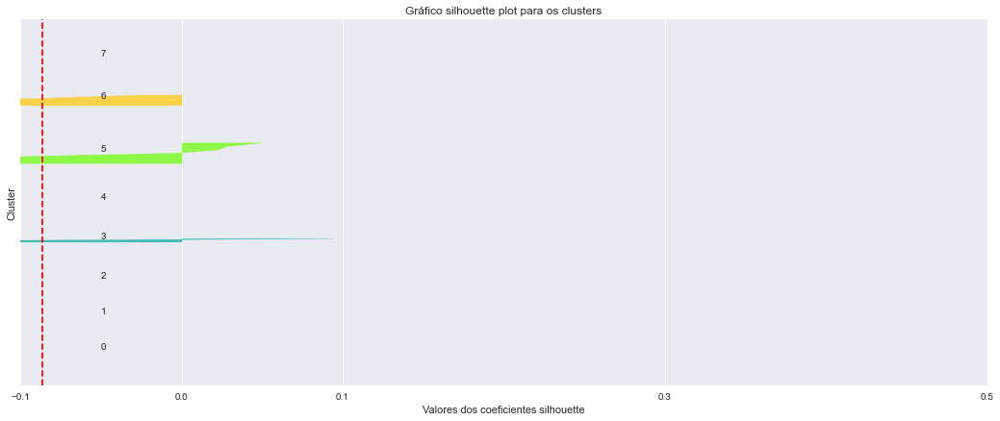

array([1, 5, 6, 8, 7, 3, 0, 6, 8, 0, 0, 0, 7, 2, 5, 7, 4])

Número do cluster = 9 - Silhouette (médio) = 0.0029785450160650373


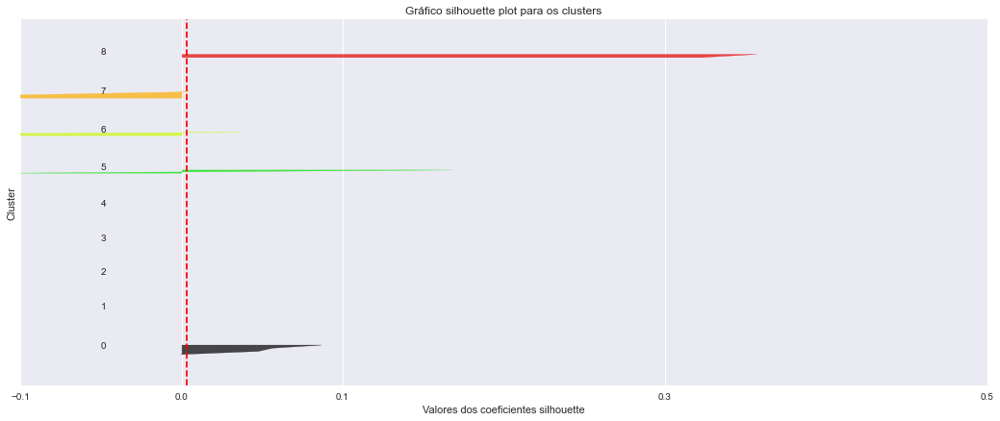

array([0, 0, 0, 0, 4, 6, 5, 4, 0, 5, 8, 5, 3, 0, 2, 4, 0])

Número do cluster = 10 - Silhouette (médio) = 0.04406355313325087


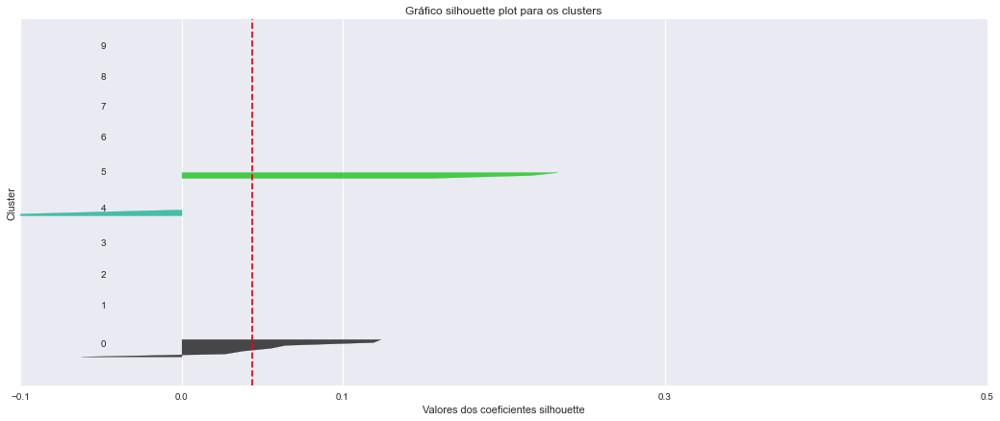

array([1, 7, 7, 7, 5, 1, 0, 4, 7, 0, 6, 0, 3, 2, 7, 5, 7])

Número do cluster = 11 - Silhouette (médio) = 0.11313438627797699


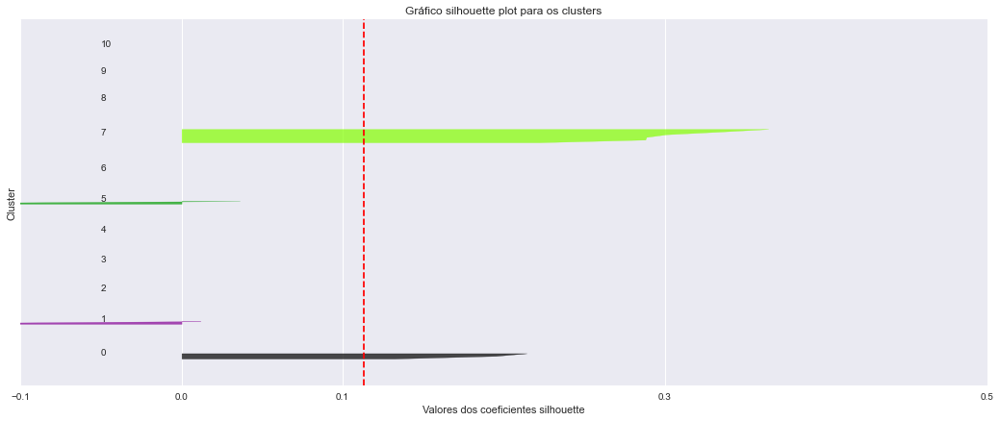

array([0, 3, 3, 3, 9, 0, 6, 1, 3, 6, 5, 5, 9, 8, 3, 4, 3])

Número do cluster = 12 - Silhouette (médio) = 0.07942624158336564


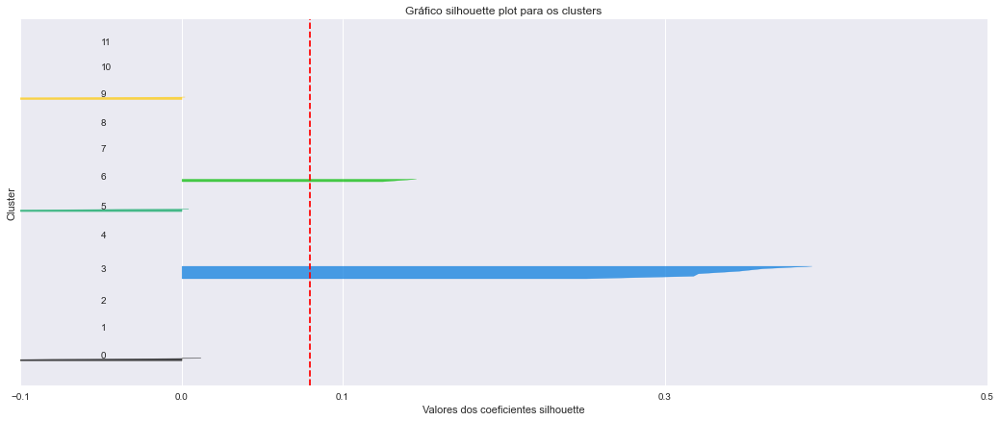

array([ 4, 11,  0,  0,  0,  4,  8,  0,  0,  1,  7,  1,  9,  2, 11,  5,  0])

Número do cluster = 13 - Silhouette (médio) = 0.016323171833512957


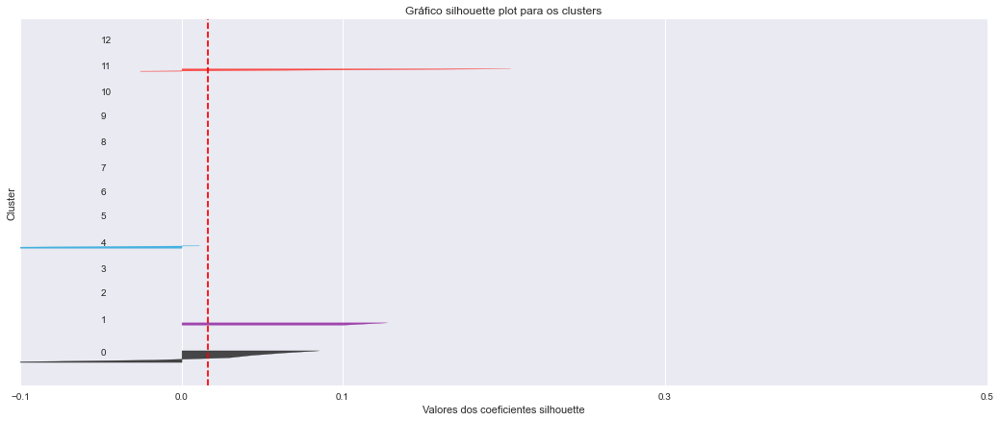

array([10, 13,  7,  5,  9, 10,  4, 12,  6,  4,  3,  4,  0, 11,  2,  1,  7])

Número do cluster = 14 - Silhouette (médio) = 0.014395716208740325


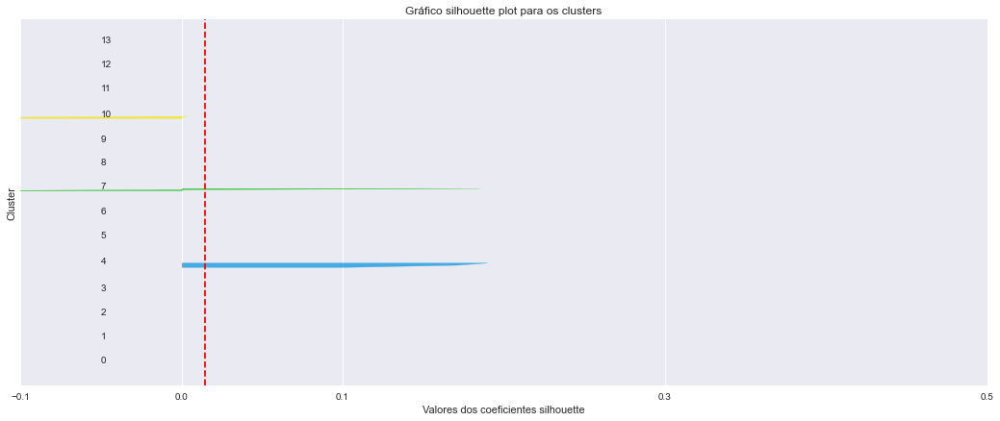

In [123]:
# Calcula os índices silhouette médio para vários valores de clusters 2-10
lst_silhouette_avg = []
for i in range(2,15):
    # Faz o agrupamentos de clusters utilizando o kshape (timeseries)
    # 
    ks = KShape(n_clusters = i, n_init=5, random_state=3)
    labels = ks.fit_predict(df_data.T)
    display(labels)
    
    silhouette_avg = silhouette_score(df_data.T, labels)
    print('Número do cluster = {} - Silhouette (médio) = {}'.format(i, silhouette_avg))
    lst_silhouette_avg.append(silhouette_avg)
        
    grafico_silhouette(i, labels, df_data.T)

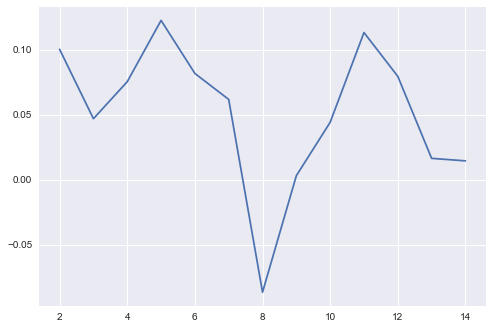

In [124]:
# Gráfico Silhouette
x = np.array(range(2,15))
y = np.array(lst_silhouette_avg)
plt.plot(x,y)
    

In [125]:
# Usando o ncluster de com maior silhouette médio:
idx = lst_silhouette_avg.index(max(lst_silhouette_avg))
nclusters = range(2,15)[idx]
print('Número de clusters selecionado - {}'.format(nclusters))

Número de clusters selecionado - 5


In [126]:
# Faz o agrupamentos de clusters utilizando o KShape
# 
ks = KShape(n_clusters = nclusters, n_init=2, random_state=3)
labels = ks.fit_predict(df_data.T)
display(labels)
    


array([3, 3, 3, 3, 3, 3, 2, 1, 3, 2, 0, 2, 4, 1, 3, 4, 3])

In [127]:
df_clusters = dataframe_clusters(labels, df_data)
df_clusters.sort_values(['Cluster', 'SETOR ECONÔMICO'], inplace=True)
display(df_clusters)

,Cluster,Codigo Listagem B3,SETOR ECONÔMICO,SUBSETOR,SEGMENTO,Nome,Codigo Listagem,Mercado
10,0,BRPR3,Financeiro,Exploração de Imóveis,Exploração de Imóveis,BR PROPERT,BRPR,NM
7,1,BBSE3,Financeiro,Previdência e Seguros,Seguradoras,BBSEGURIDADE,BBSE,NM
13,1,PSSA3,Financeiro,Previdência e Seguros,Seguradoras,PORTO SEGURO,PSSA,NM
6,2,BRML3,Financeiro,Exploração de Imóveis,Exploração de Imóveis,BR MALLS PAR,BRML,NM
9,2,MULT3,Financeiro,Exploração de Imóveis,Exploração de Imóveis,MULTIPLAN,MULT,N2
11,2,IGTA3,Financeiro,Exploração de Imóveis,Exploração de Imóveis,IGUATEMI,IGTA,NM
0,3,B3SA3,Financeiro,Serviços Financeiros Diversos,Serviços Financeiros Diversos,B3,B3SA,NM
1,3,ITSA4,Financeiro,Intermediários Financeiros,Bancos,ITAUSA,ITSA,N1
2,3,ITUB4,Financeiro,Intermediários Financeiros,Bancos,ITAUUNIBANCO,ITUB,N1
3,3,BBDC4,Financeiro,Intermediários Financeiros,Bancos,BRADESCO,BBDC,N1


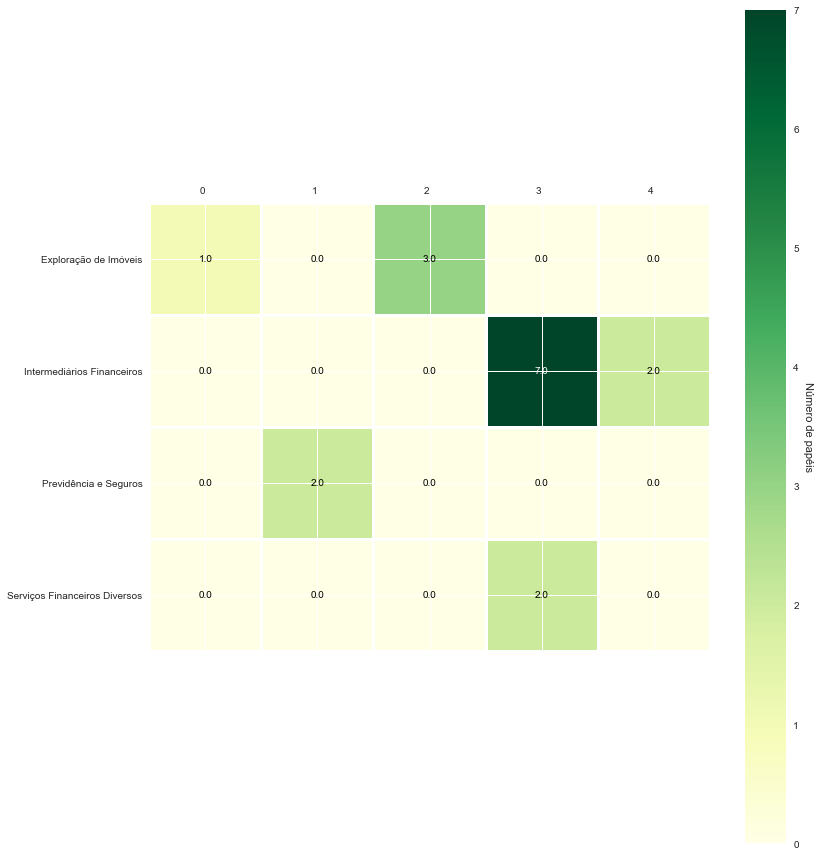

In [128]:
grafico_heatmap(nclusters, labels, 'Heatmap', 'SUBSETOR', df_data)

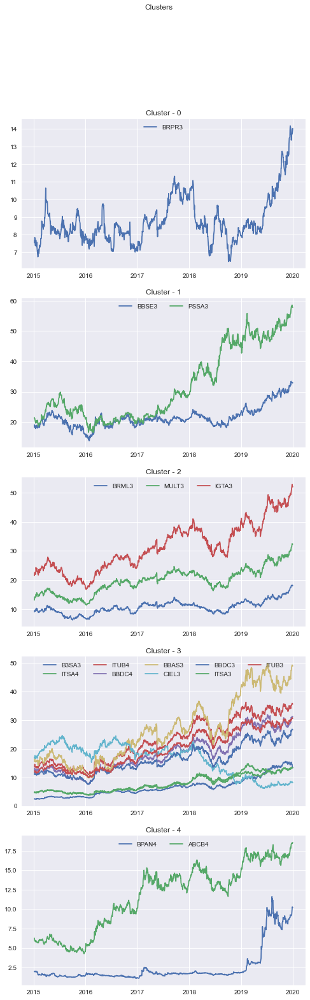

In [129]:
# Gera o gráfico dos clusters (séries históricas de precços)
grafico_clusters(nclusters, labels, 'Clusters', df_data_precos)

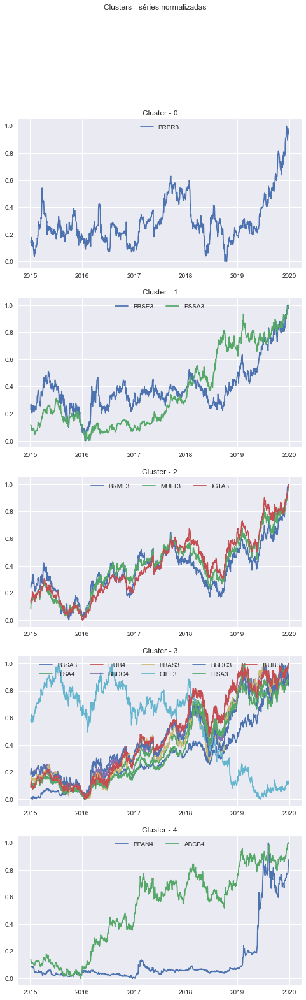

In [130]:
# Gera o gráfico dos clusters (séries históricas de precços, normalizadas)
grafico_clusters(nclusters, labels, 'Clusters - séries normalizadas', df_data_precos_norm)

In [131]:
silhouette_avg = silhouette_score(df_data.T, labels)
# Testando se o silhouette_score do pacote sklearn tem o resultado aproximado ao do pacote tslearn (time series)
print('Silhouette (médio) = {}'.format(silhouette_avg))

Silhouette (médio) = 0.12246965671761705


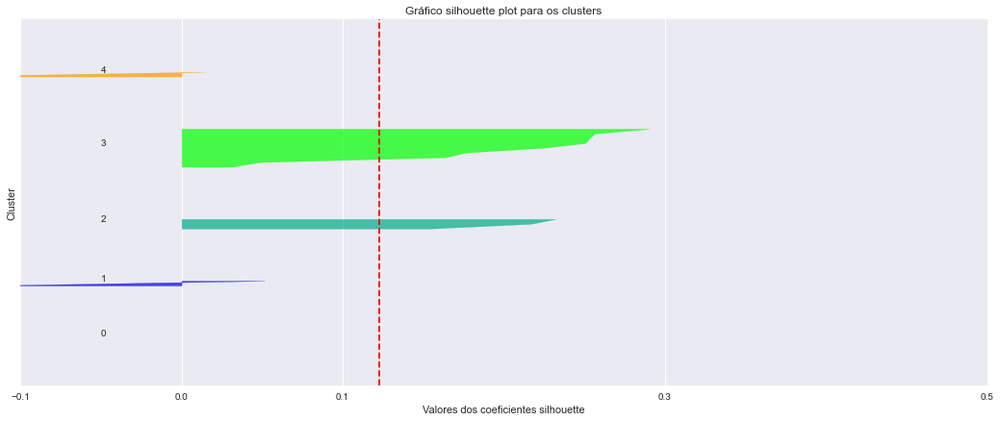

In [132]:
grafico_silhouette(nclusters, labels, df_data.T)